## PART 3: Data Analysis

In [ ]:
# amazon_df_sa : 평점 4점 이상 / amazon_df_dsa : 평점 2점 이하
amazon_df_sa = amazon_df[amazon_df['review_rating'] >= 4]
amazon_df_dsa = amazon_df[amazon_df['review_rating'] <= 2]

# amazon_df_sa : 평점 4점 이상
amazon_df_sa_dr = amazon_df_sa[amazon_df_sa['brand'] == 'Dr.Jart+']
amazon_df_sa_cs = amazon_df_sa[amazon_df_sa['brand'] == 'COSRX']
amazon_df_sa_bj = amazon_df_sa[amazon_df_sa['brand'] == 'Beauty of Joseon']
amazon_df_sa_if = amazon_df_sa[amazon_df_sa['brand'] == "I'm from"]
amazon_df_sa_pu = amazon_df_sa[amazon_df_sa['brand'] == 'PURITO']

# amazon_df_dsa : 평점 2점 이하
amazon_df_dsa_dr = amazon_df_dsa[amazon_df_dsa['brand'] == 'Dr.Jart+']
amazon_df_dsa_cs = amazon_df_dsa[amazon_df_dsa['brand'] == 'COSRX']
amazon_df_dsa_bj = amazon_df_dsa[amazon_df_dsa['brand'] == 'Beauty of Joseon']
amazon_df_dsa_if = amazon_df_dsa[amazon_df_dsa['brand'] == "I'm from"]
amazon_df_dsa_pu = amazon_df_dsa[amazon_df_dsa['brand'] == 'PURITO']

# 리스트화
amazon_df_sa_list = [amazon_df_sa_dr, amazon_df_sa_cs, amazon_df_sa_bj, amazon_df_sa_if, amazon_df_sa_pu]
amazon_df_dsa_list = [amazon_df_dsa_dr, amazon_df_dsa_cs, amazon_df_dsa_bj, amazon_df_dsa_if, amazon_df_dsa_pu]

#### TF-IDF 및 워드 클라우드

##### Amazon

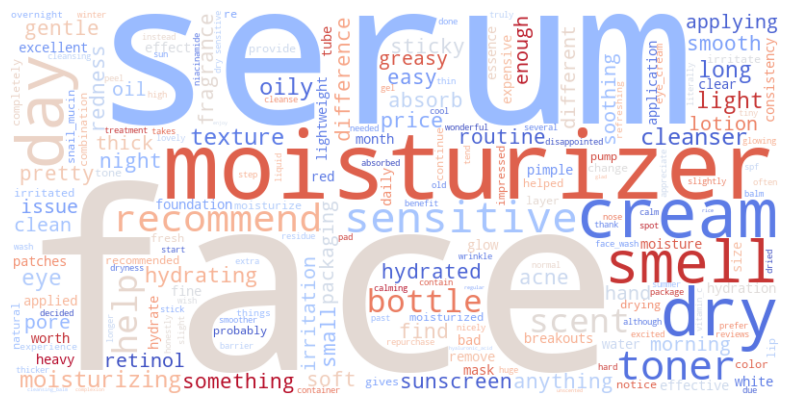

,Word,TF,TF-IDF
0,face,4092,1118.704494
1,dry,2009,647.712645
2,sensitive,1902,617.028193
3,cream,1853,534.531339
4,serum,1805,534.204124


In [ ]:
reviews_w_ngrams = pd.DataFrame(amazon_df.cleaned_review.copy())

# 트리그램화
reviews_w_ngrams.cleaned_review = reviews_w_ngrams.cleaned_review.map(lambda x: replace_ngram(x) if isinstance(x, str) else x)
reviews_w_ngrams = reviews_w_ngrams.cleaned_review.map(lambda x: [word for word in x.split() if word not in stop_words and len(word) > 2] if isinstance(x, str) else x)
reviews_w_ngrams.dropna(axis=0, inplace=True)
reviews_w_ngrams.isnull().sum()
final_reviews = reviews_w_ngrams
final_reviews.dropna(axis=0, inplace=True)
final_reviews_df = pd.DataFrame(final_reviews)

try:
    # 1. 리스트의 리스트를 하나의 리스트로 평탄화
    all_words = []
    for word_list in final_reviews_df['cleaned_review'].dropna():
        # word_list가 리스트인지 확인하는 추가적인 검사
        if isinstance(word_list, list):
            all_words.extend(word_list)
        elif isinstance(word_list, str):  # 만약 이미 문자열이라면 그대로 추가
            all_words.append(word_list)
        else: # 리스트나 문자열이 아닌 경우 예외처리
            print(f"Unexpected data type: {type(word_list)}, Value: {word_list}")
            continue # 다음 항목으로 건너뛰기
    
    if not all_words: # all_words가 비어있는 경우 예외처리
        print("No valid words found after processing. Check your data.")
        exit() # 프로그램 종료

    # 2. 하나의 리스트를 문자열로 결합
    text = ' '.join(all_words)

    # WordCloud 생성 및 시각화
    wordcloud = WordCloud(width=800, height=400,
                          background_color='white', colormap='coolwarm').generate(text)

    plt.figure(figsize=(10, 5))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.show()

except Exception as e:
    print(f"An error occurred: {e}")
    
# 결측값 제거
TD_df = final_reviews_df.dropna(subset=['cleaned_review'])
TD_df['cleaned_review'] = TD_df['cleaned_review'].apply(lambda x: ' '.join(x) if isinstance(x, list) else x)

# TF-IDF 벡터화
vectorizer = TfidfVectorizer(max_features=75, stop_words='english')
tfidf_matrix = vectorizer.fit_transform(TD_df['cleaned_review'])
feature_names = vectorizer.get_feature_names_out()
tfidf_scores = tfidf_matrix.sum(axis=0).A1

# 단어별 TF (출현 빈도) 계산
all_words = ' '.join(TD_df['cleaned_review']).split()
word_counts = Counter(all_words)

# TF 및 TF-IDF 정리
tf_scores = {word: count for word, count in word_counts.items() if word in feature_names}
idf_scores = dict(zip(feature_names, tfidf_scores))

tfidf_df = pd.DataFrame({
    'Word': feature_names,
    'TF': [tf_scores.get(word, 0) for word in feature_names],
    'TF-IDF': [idf_scores[word] for word in feature_names]
}).sort_values(by="TF-IDF", ascending=False)

# 결과 출력
tfidf_df.reset_index(drop=True, inplace=True)
tfidf_df.head(5)

'Dr.Jart+'

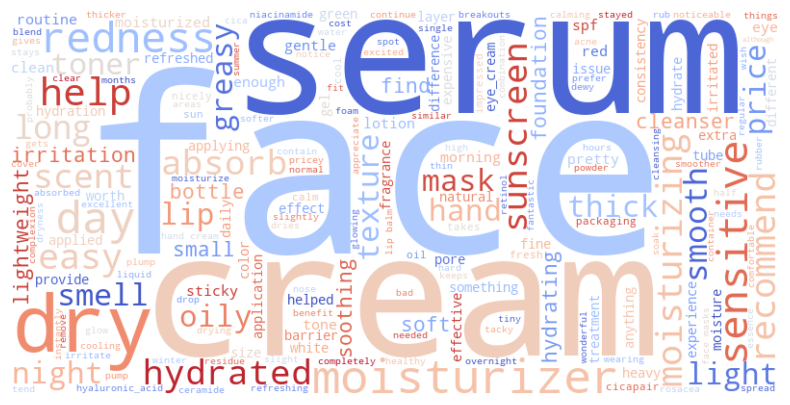

,Word,TF,TF-IDF
0,face,869,180.750789
1,cream,389,91.109945
2,dry,324,84.978193
3,serum,324,82.594357
4,redness,258,77.606145


'COSRX'

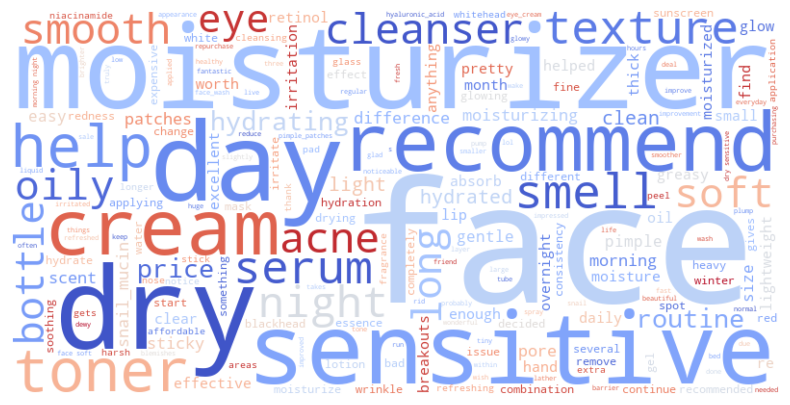

,Word,TF,TF-IDF
0,face,967,302.738603
1,dry,529,186.887578
2,sensitive,434,168.037139
3,moisturizer,427,154.610221
4,recommend,352,151.492935


'Beauty of Joseon'

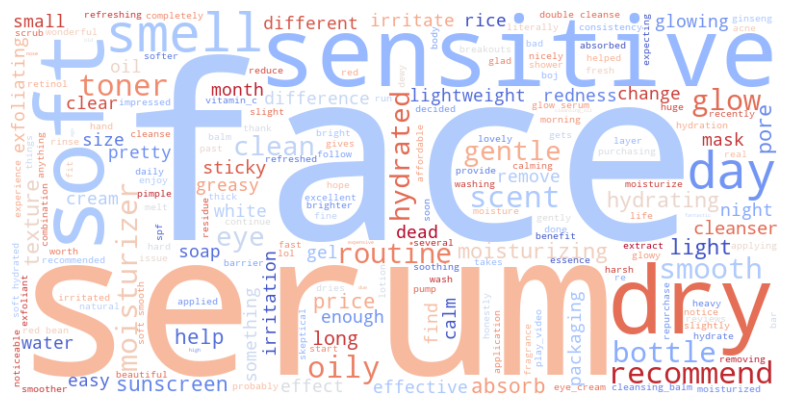

,Word,TF,TF-IDF
0,face,323,97.869972
1,soft,168,69.562963
2,serum,186,57.278971
3,sensitive,145,48.082518
4,dry,132,48.028513


"I'm from"

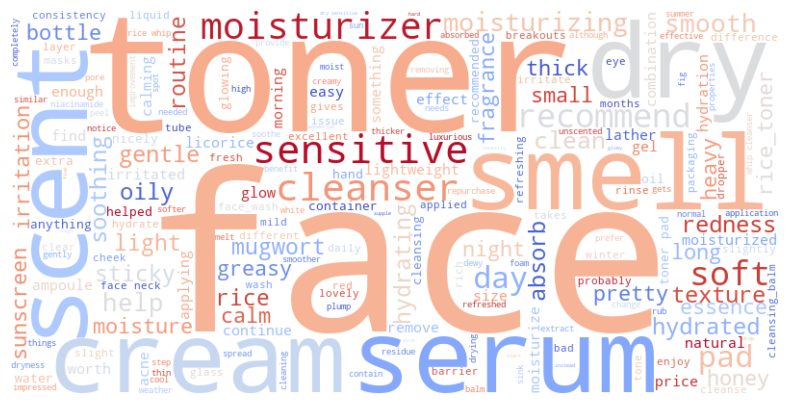

,Word,TF,TF-IDF
0,face,478,127.694982
1,dry,247,73.841355
2,soft,198,73.229405
3,sensitive,228,70.537810
4,toner,236,69.776332


'PURITO'

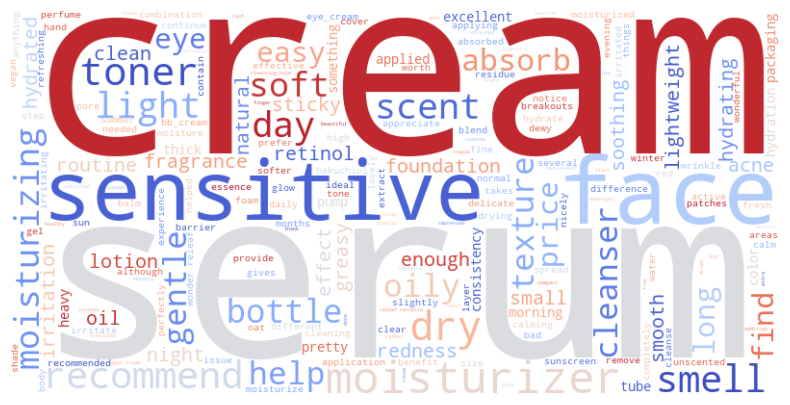

,Word,TF,TF-IDF
0,face,641,154.003243
1,cream,693,151.989243
2,serum,573,138.230146
3,sensitive,502,128.580811
4,dry,425,113.390768


In [ ]:
for i in range(len(amazon_df_sa_list)) :
    reviews_w_ngrams = pd.DataFrame(amazon_df_sa_list[i].cleaned_review.copy())
    reviews_w_ngrams.cleaned_review = reviews_w_ngrams.cleaned_review.map(lambda x: replace_ngram(x) if isinstance(x, str) else x)

    # tokenize reviews + remove stop words + remove names + remove words with less than 2 characters
    reviews_w_ngrams = reviews_w_ngrams.cleaned_review.map(lambda x: [word for word in x.split() if word not in stop_words and len(word) > 2] if isinstance(x, str) else x)
    reviews_w_ngrams.dropna(axis=0, inplace=True)
    reviews_w_ngrams.isnull().sum()

    final_reviews = reviews_w_ngrams
    final_reviews.dropna(axis=0, inplace=True)

    final_reviews_df = pd.DataFrame(final_reviews)

    # 테스트용
    try:
        # 1. 리스트의 리스트를 하나의 리스트로 평탄화
        all_words = []
        for word_list in final_reviews_df['cleaned_review'].dropna():
            # word_list가 리스트인지 확인하는 추가적인 검사
            if isinstance(word_list, list):
                all_words.extend(word_list)
            elif isinstance(word_list, str):  # 만약 이미 문자열이라면 그대로 추가
                all_words.append(word_list)
            else: # 리스트나 문자열이 아닌 경우 예외처리
                print(f"Unexpected data type: {type(word_list)}, Value: {word_list}")
                continue # 다음 항목으로 건너뛰기
        
        if not all_words: # all_words가 비어있는 경우 예외처리
            print("No valid words found after processing. Check your data.")
            exit() # 프로그램 종료

        # 2. 하나의 리스트를 문자열로 결합
        text = ' '.join(all_words)

        # WordCloud 생성 및 시각화
        wordcloud = WordCloud(width=800, height=400,
                            background_color='white', colormap='coolwarm').generate(text)

        plt.figure(figsize=(10, 5))
        plt.imshow(wordcloud, interpolation='bilinear')
        plt.axis('off')
        display(brand_title_list[i])
        plt.show()

    except Exception as e:
        print(f"An error occurred: {e}")
        
    # 결측값 제거
    TD_df = final_reviews_df.dropna(subset=['cleaned_review'])
    TD_df['cleaned_review'] = TD_df['cleaned_review'].apply(lambda x: ' '.join(x) if isinstance(x, list) else x)

    # TF-IDF 벡터화
    vectorizer = TfidfVectorizer(max_features=75, stop_words='english')
    tfidf_matrix = vectorizer.fit_transform(TD_df['cleaned_review'])
    feature_names = vectorizer.get_feature_names_out()
    tfidf_scores = tfidf_matrix.sum(axis=0).A1

    # 단어별 TF (출현 빈도) 계산
    all_words = ' '.join(TD_df['cleaned_review']).split()
    word_counts = Counter(all_words)

    # TF 및 TF-IDF 정리
    tf_scores = {word: count for word, count in word_counts.items() if word in feature_names}
    idf_scores = dict(zip(feature_names, tfidf_scores))

    tfidf_df = pd.DataFrame({
        'Word': feature_names,
        'TF': [tf_scores.get(word, 0) for word in feature_names],
        'TF-IDF': [idf_scores[word] for word in feature_names]
    }).sort_values(by="TF-IDF", ascending=False)

    # 결과 출력
    tfidf_df.reset_index(drop=True, inplace=True)
    display(tfidf_df.head())


##### Skinsort

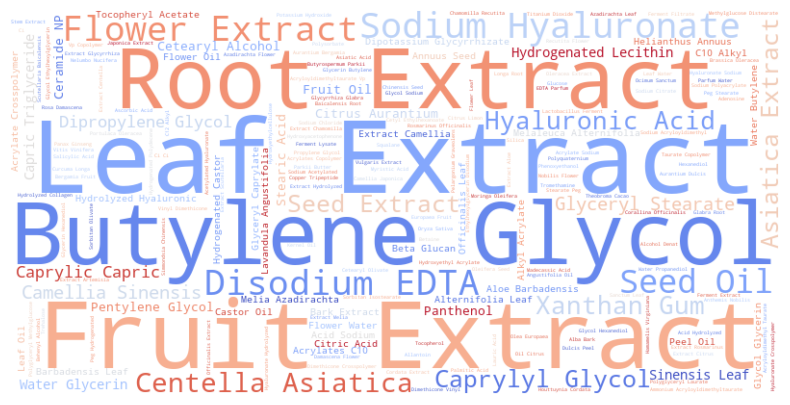

In [ ]:
# 한국 스킨케어 브랜드 성분
wordcloud = WordCloud(width=800, height=400, 
                      background_color='white', colormap='coolwarm').generate(' '.join(k_skin_brand['ingridients'].dropna()))
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

#### 감성분석

In [ ]:
# 감성 분석을 위한 준비
analyzer = SentimentIntensityAnalyzer()

# 감성 분석을 위한 함수
def get_sentiment(review):
    return analyzer.polarity_scores(review)

# 'cleaned_review' 기반 감성 분석
amazon_df['cleaned_review'] = amazon_df['cleaned_review'].astype(str)
amazon_df['vader_scores'] = amazon_df['cleaned_review'].apply(get_sentiment)

k_skin_brand['afterUse'] = k_skin_brand['afterUse'].astype(str)
k_skin_brand['vader_scores'] = k_skin_brand['afterUse'].apply(get_sentiment)

amazon_df['compound'] = amazon_df['vader_scores'].apply(lambda score_dict: score_dict['compound'])
k_skin_brand['compound'] = k_skin_brand['vader_scores'].apply(lambda score_dict: score_dict['compound'])

# 점수 기반 긍정, 중립, 부정 분류를 위한 함수
def classify_sentiment(compound_score):
    if compound_score >= 0.05:
        return 'Positive'
    elif compound_score <= -0.05:
        return 'Negative'
    else:
        return 'Neutral'

# 긍정, 중립, 부정 분류
amazon_df['sentiment'] = amazon_df['compound'].apply(classify_sentiment)
k_skin_brand['sentiment'] = k_skin_brand['compound'].apply(classify_sentiment)

# 분류 결과 확인
display(amazon_df[['cleaned_review', 'compound', 'sentiment']].head(3))

# 긍정적/부정적 리뷰별 가격과 평균 평점 확인
display(amazon_df.groupby('sentiment')[['price', 'total_star_mean']].mean().round(2).reset_index())

,cleaned_review,compound,sentiment
0,not as good as people hype it up to be i’ll us...,-0.5428,Negative
1,had to use this for a bit to give it a review ...,0.5423,Positive
2,big chefs kiss to this product i live by the b...,0.7579,Positive


,sentiment,price,total_star_mean
0,Negative,19.48,4.42
1,Neutral,19.27,4.45
2,Positive,20.85,4.45


##### Amazon

In [ ]:
# 브랜드별 데이터분석 시각화를 위한 변수 설정
amazon_df_dr = amazon_df[amazon_df['brand']=='Dr.Jart+']
amazon_df_cs = amazon_df[amazon_df['brand']=='COSRX']
amazon_df_bj = amazon_df[amazon_df['brand']=="I'm from"]
amazon_df_if = amazon_df[amazon_df['brand']=="Beauty of Joseon"]
amazon_df_pu = amazon_df[amazon_df['brand']=='PURITO']
amazon_df_list = [amazon_df_dr, amazon_df_cs,amazon_df_bj,amazon_df_if,amazon_df_pu]
brand_title_list = ['Dr.Jart+', 'COSRX', "I'm from", "Beauty of Joseon", 'PURITO']

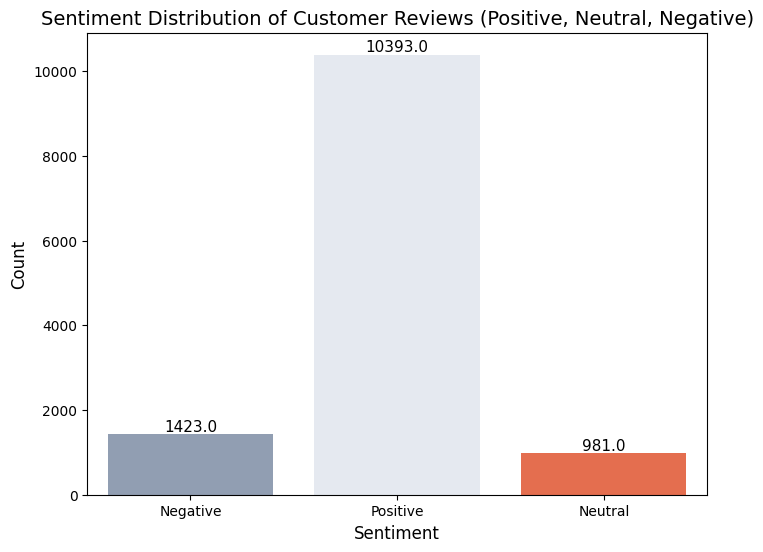

In [ ]:
# amazon_df 기준 감성 분석 결과 시각화

plt.figure(figsize=(8, 6))
sns.countplot(data=amazon_df, x='sentiment', palette=skin_palette)
plt.title('Sentiment Distribution of Customer Reviews (Positive, Neutral, Negative)', fontsize=14)
plt.xlabel('Sentiment', fontsize=12)
plt.ylabel('Count', fontsize=12)

# 막대 위 데이터 레이블 추가
for p in plt.gca().patches:
    plt.gca().annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2, p.get_height()), 
                       ha='center', va='bottom', fontsize=11)

# 시각화
plt.show()

###### 감성분석

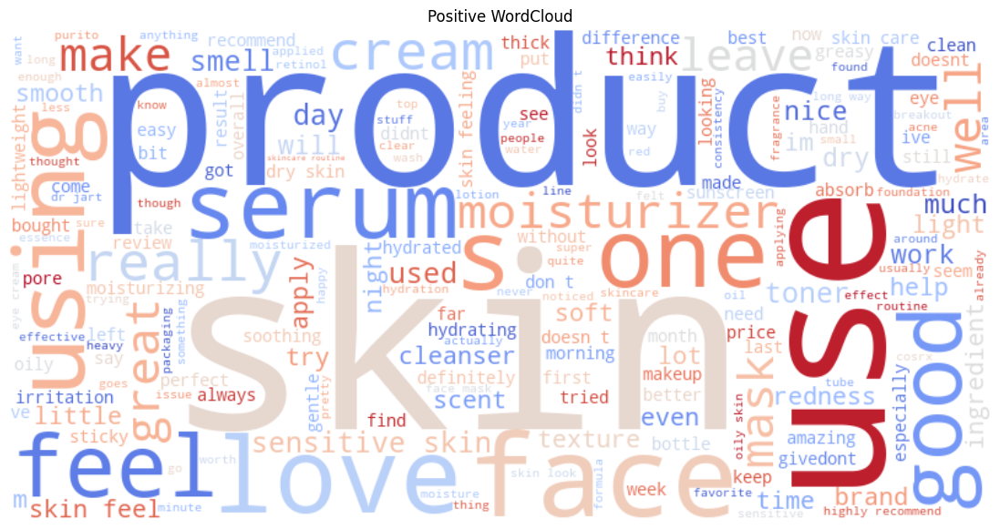

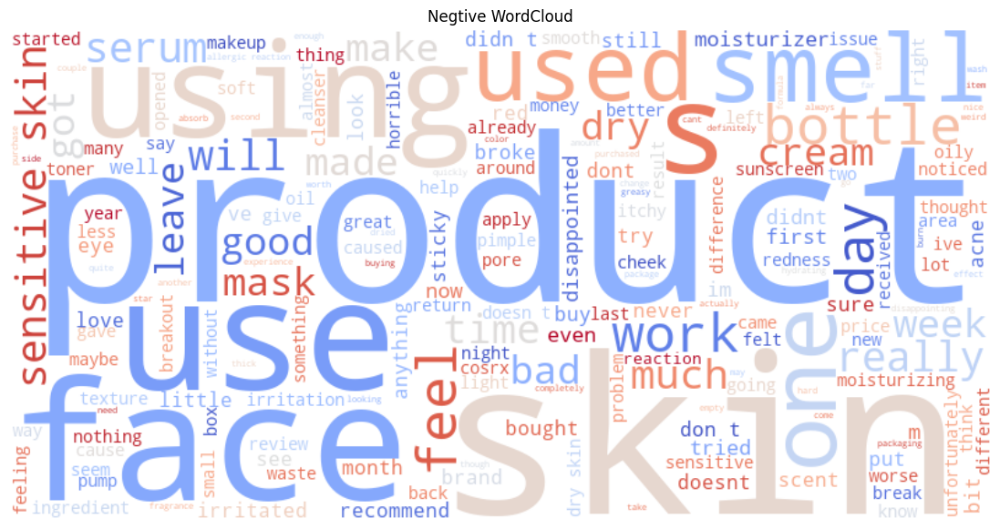

In [ ]:
# 긍정적 리뷰 내용 - 워드 클라우드
query_cond = 'sentiment == "Positive"'
pos_df = amazon_df.query(query_cond)
pos_df.reset_index(drop=True, inplace=True)

wordcloud = WordCloud(width=800, height=400, 
                      background_color='white', colormap='coolwarm').generate(' '.join(pos_df['cleaned_review'].dropna()))
plt.figure(figsize=(14, 7))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Positive WordCloud')
plt.show()

# 부정적 리뷰 내용 - 워드 클라우드
query_cond = 'sentiment == "Negative"'
neg_df = amazon_df.query(query_cond)
neg_df.reset_index(drop=True, inplace=True)

wordcloud = WordCloud(width=800, height=400, 
                      background_color='white', colormap='coolwarm').generate(' '.join(neg_df['cleaned_review'].dropna()))
plt.figure(figsize=(14, 7))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Negtive WordCloud')
plt.show()

###### 브랜드별 감성분석

'Dr.Jart+'

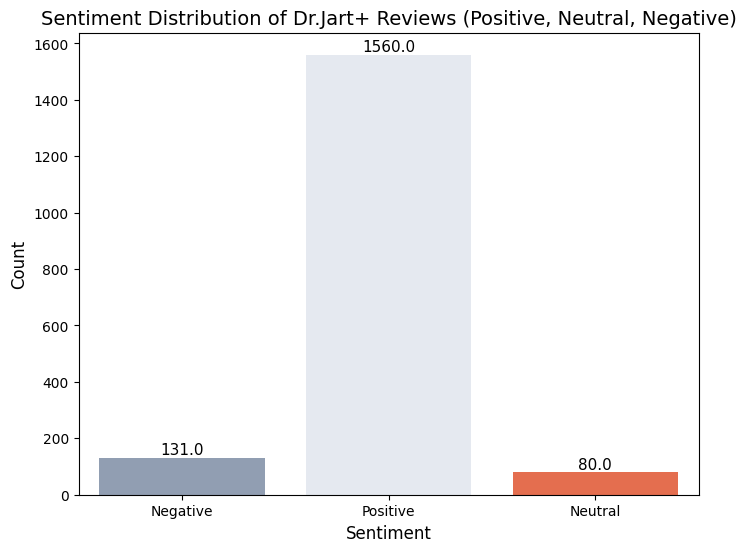

,sentiment,price,total_star_mean
0,Negative,30.98,4.34
1,Neutral,30.30,4.36
2,Positive,33.60,4.40


'COSRX'

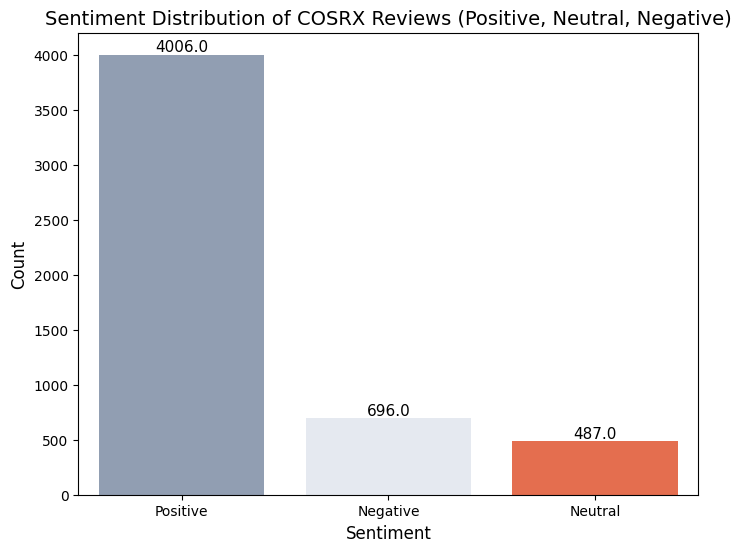

,sentiment,price,total_star_mean
0,Negative,17.91,4.46
1,Neutral,17.78,4.49
2,Positive,17.97,4.50


"I'm from"

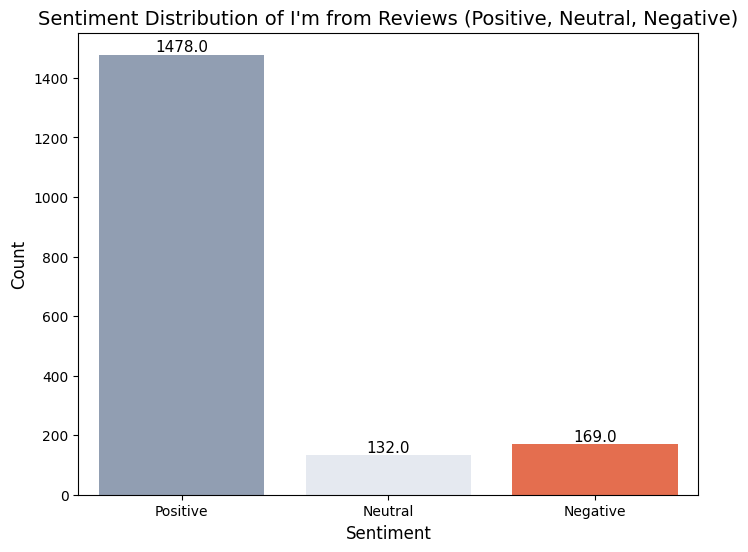

,sentiment,price,total_star_mean
0,Negative,22.77,4.36
1,Neutral,21.94,4.38
2,Positive,22.58,4.41


'Beauty of Joseon'

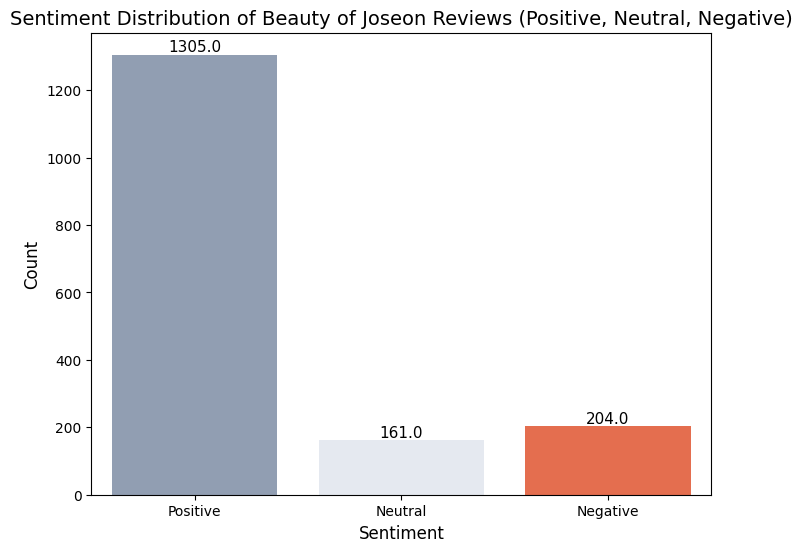

,sentiment,price,total_star_mean
0,Negative,17.69,4.43
1,Neutral,18.17,4.46
2,Positive,17.86,4.46


'PURITO'

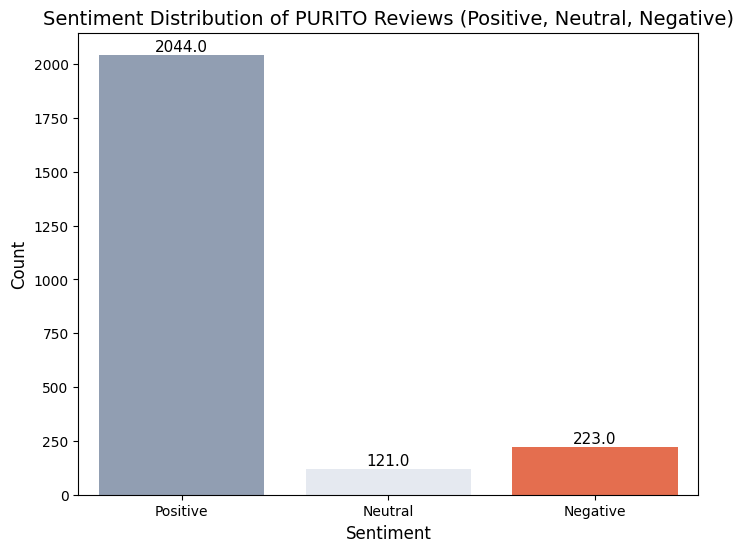

,sentiment,price,total_star_mean
0,Negative,16.31,4.35
1,Neutral,16.29,4.40
2,Positive,17.09,4.39


In [ ]:
# amazon_df의 브랜드별 감성 분석 결과 시각화
for i in range(len(amazon_df_list)) :
    plt.figure(figsize=(8, 6))
    sns.countplot(data=amazon_df_list[i], x='sentiment', palette=skin_palette)
    plt.title('Sentiment Distribution of '+brand_title_list[i]+' Reviews (Positive, Neutral, Negative)', fontsize=14)
    plt.xlabel('Sentiment', fontsize=12)
    plt.ylabel('Count', fontsize=12)

    # 막대 위 데이터 레이블 추가
    for p in plt.gca().patches:
        plt.gca().annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2, p.get_height()), 
                        ha='center', va='bottom', fontsize=11)
    display(brand_title_list[i])
    # 시각화
    plt.show()
    # 긍정적/부정적 리뷰별 가격과 평균 평점 확인
    display(amazon_df_list[i].groupby('sentiment')[['price', 'total_star_mean']].mean().round(2).reset_index())

##### Skinsort

'Skinsort'

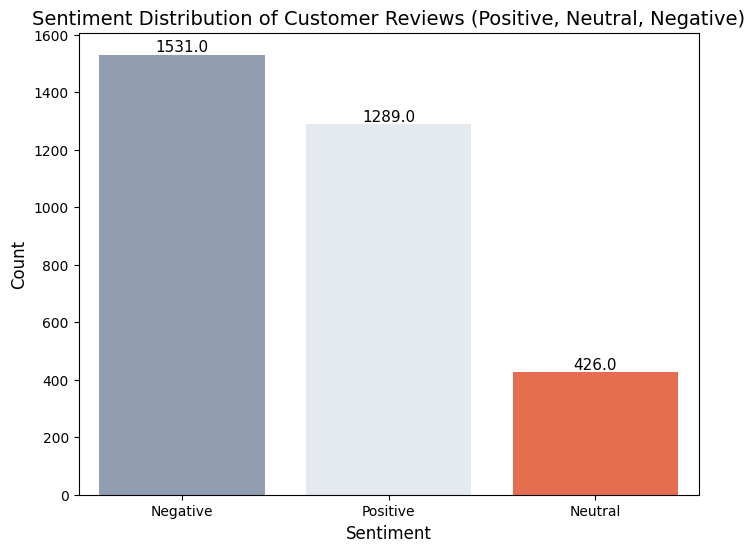

In [ ]:
# skinsort 기준 감성 분석 결과 시각화

plt.figure(figsize=(8, 6))
sns.countplot(data=k_skin_brand, x='sentiment', palette=skin_palette)
plt.title('Sentiment Distribution of Customer Reviews (Positive, Neutral, Negative)', fontsize=14)
plt.xlabel('Sentiment', fontsize=12)
plt.ylabel('Count', fontsize=12)

# 막대 위 데이터 레이블 추가
for p in plt.gca().patches:
    plt.gca().annotate(f'{p.get_height()}', (p.get_x() + p.get_width() / 2, p.get_height()), 
                       ha='center', va='bottom', fontsize=11)
display('Skinsort')
# 시각화
plt.show()

#### LDA 및 토픽 모델링(코드 실행 필요)

##### 전체

Round: 5
Round: 6
Round: 7
Round: 8
Round: 9


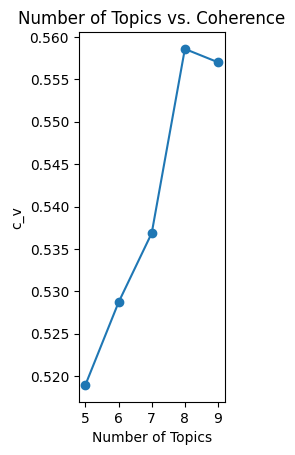

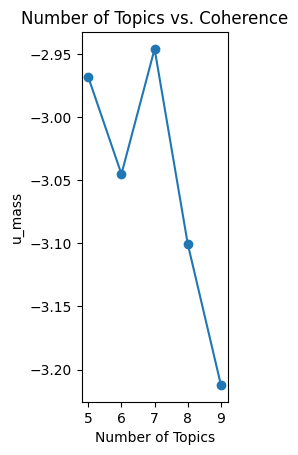

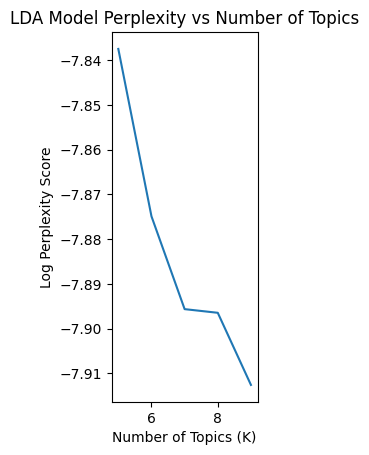

In [ ]:
reviews_w_ngrams = pd.DataFrame(amazon_df.cleaned_review.copy())
reviews_w_ngrams.cleaned_review = reviews_w_ngrams.cleaned_review.map(lambda x: replace_ngram(x) if isinstance(x, str) else x)

# tokenize reviews + remove stop words + remove names + remove words with less than 2 characters
reviews_w_ngrams = reviews_w_ngrams.cleaned_review.map(lambda x: [word for word in x.split() if word not in stop_words and len(word) > 2] if isinstance(x, str) else x)
reviews_w_ngrams.dropna(axis=0, inplace=True)
reviews_w_ngrams.isnull().sum()

final_reviews = reviews_w_ngrams
final_reviews.dropna(axis=0, inplace=True)

dictionary = corpora.Dictionary(final_reviews)
doc_term_matrix = [dictionary.doc2bow(doc) for doc in final_reviews]

coherence = []
umass = []
px = []
topic_range = range(5, 10)
for k in topic_range:
    print('Round: '+str(k))
    Lda = gensim.models.ldamodel.LdaModel
    ldamodel = Lda(doc_term_matrix, num_topics=k, id2word = dictionary, passes=20,\
                   iterations=200, chunksize = 10000, eval_every = None, random_state=0)
    
    cm = gensim.models.coherencemodel.CoherenceModel(model=ldamodel, texts=final_reviews,\
                                                     dictionary=dictionary, coherence='c_v')
    mm = gensim.models.coherencemodel.CoherenceModel(model=ldamodel, texts=final_reviews,\
                                                     dictionary=dictionary, coherence='u_mass')
    coherence.append((k,cm.get_coherence()))
    umass.append((k,mm.get_coherence()))
    px.append(ldamodel.log_perplexity(doc_term_matrix))
    
    
x_val = [x[0] for x in coherence]
y_val = [x[1] for x in coherence]

x_val_u = [x[0] for x in umass]
y_val_y = [x[1] for x in umass]

plt.subplot(1,3,1)
plt.plot(x_val,y_val)
plt.scatter(x_val,y_val)
plt.title('Number of Topics vs. Coherence')
plt.xlabel('Number of Topics')
plt.ylabel('c_v')
plt.xticks(x_val)
plt.show()

plt.subplot(1,3,2)
plt.plot(x_val_u,y_val_y)
plt.scatter(x_val_u,y_val_y)
plt.title('Number of Topics vs. Coherence')
plt.xlabel('Number of Topics')
plt.ylabel('u_mass')
plt.xticks(x_val_u)
plt.show()

plt.subplot(1,3,3)
plt.plot(topic_range, px)
plt.xlabel("Number of Topics (K)")
plt.ylabel("Log Perplexity Score")
plt.title("LDA Model Perplexity vs Number of Topics")
plt.show()

In [ ]:
for i in topic_range:
    name = 'all'
    num = i
    Lda = gensim.models.ldamodel.LdaModel
    ldamodel = Lda(doc_term_matrix, num_topics=num, id2word = dictionary, passes=40,\
                iterations=200,  chunksize = 10000, eval_every = None, random_state=0)
    Lda2 = gensim.models.ldamodel.LdaModel
    ldamodel2 = Lda2(doc_term_matrix, num_topics=num, id2word = dictionary, passes=40,\
                iterations=200,  chunksize = 10000, eval_every = None, random_state=0)
    
    # To show initial topics
    ldamodel.show_topics(num, num_words=10, formatted=False)
    
    # To show initial topics
    ldamodel2.show_topics(num, num_words=10, formatted=False)
    
    # Visualize the topics
    pyLDAvis.enable_notebook()
    LDAvis_data_filepath = os.path.join('./results/ldavis_prepared_'+'v3_0129')
    
    # Create directory if it does not exist
    if not os.path.exists('./results'):
        os.makedirs('./results')
    LDAvis_prepared = pyLDAvis.gensim.prepare(ldamodel2, doc_term_matrix, dictionary, mds = 'pcoa')
    with open(LDAvis_data_filepath, 'wb') as f:
        pickle.dump(LDAvis_prepared, f)
        
    # load the pre-prepared pyLDAvis data from disk
    with open(LDAvis_data_filepath, 'rb') as f:
        LDAvis_prepared = pickle.load(f)
    pyLDAvis.save_html(LDAvis_prepared, './results/ldavis_prepared_'+ f'{name}_{num}' +'.html')
    display(LDAvis_prepared)
    
    topic_data = LDAvis_prepared
    all_topics = {}
    num_terms = 10  # Adjust number of words to represent each topic
    lambd = 0.6  # Adjust this accordingly based on tuning above
    for j in range(1, num + 1):  # Adjust this to reflect number of topics chosen for final LDA model
        topic = topic_data.topic_info[topic_data.topic_info.Category == 'Topic' + str(j)].copy()
        topic['relevance'] = topic['loglift'] * (1 - lambd) + topic['logprob'] * lambd
        # 리스트 길이 보정: max_length 만큼 패딩 (NaN 추가)
        terms = topic.sort_values(by='relevance', ascending=False).Term.tolist()
        all_topics['Topic ' + str(j)] = terms[:num_terms] + [None] * (num_terms - len(terms))
    lda2_test_results = pd.DataFrame.from_dict(all_topics, orient='index')
    display(lda2_test_results)

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
4      0.135972  0.015387       1        1  35.330743
3      0.152630  0.040732       2        1  25.602612
0      0.071391 -0.039896       3        1  20.986954
2     -0.158575 -0.203733       4        1   9.715385
1     -0.201418  0.187510       5        1   8.364307, topic_info=                   Term         Freq        Total Category  logprob  loglift
1764           cleanser   854.000000   854.000000  Default  30.0000  30.0000
316              bottle   896.000000   896.000000  Default  29.0000  29.0000
140               cream  2082.000000  2082.000000  Default  28.0000  28.0000
167         moisturizer  1414.000000  1414.000000  Default  27.0000  27.0000
53                smell   975.000000   975.000000  Default  26.0000  26.0000
953             patches   266.000000   266.000000  Default  25.0000  25.0000
35            sensitive  1841.000000  1841.000000  Default  24.0000  24.0000
1156             gentle   664.000000   664.000000  Default  23.0000  23.0000
819               clean   513.000000   513.000000  Default  22.0000  22.0000
1204            essence   277.000000   277.000000  Default  21.0000  21.0000
1710            retinol   524.000000   524.000000  Default  20.0000  20.0000
1667            extract   224.000000   224.000000  Default  19.0000  19.0000
7               redness   705.000000   705.000000  Default  18.0000  18.0000
8             sunscreen   507.000000   507.000000  Default  17.0000  17.0000
22                  dry  1847.000000  1847.000000  Default  16.0000  16.0000
501                 oil   644.000000   644.000000  Default  15.0000  15.0000
869               toner  1133.000000  1133.000000  Default  14.0000  14.0000
1778               pump   357.000000   357.000000  Default  13.0000  13.0000
80           foundation   422.000000   422.000000  Default  12.0000  12.0000
74                  bad   339.000000   339.000000  Default  11.0000  11.0000
4089            cushion   136.000000   136.000000  Default  10.0000  10.0000
255                oily   963.000000   963.000000  Default   9.0000   9.0000
708                soft  1032.000000  1032.000000  Default   8.0000   8.0000
61         disappointed   151.000000   151.000000  Default   7.0000   7.0000
845              smells   411.000000   411.000000  Default   6.0000   6.0000
329           different   330.000000   330.000000  Default   5.0000   5.0000
17                 acne   713.000000   713.000000  Default   4.0000   4.0000
506          difference   442.000000   442.000000  Default   3.0000   3.0000
330                eyes   399.000000   399.000000  Default   2.0000   2.0000
309             reviews   185.000000   185.000000  Default   1.0000   1.0000
57               cheeks   140.064094   140.737610   Topic1  -6.1421   1.0356
1019               lips   112.132023   112.786952   Topic1  -6.3645   1.0346
2108             sponge   103.849684   104.506129   Topic1  -6.4413   1.0341
2748              beige    74.585116    75.239814   Topic1  -6.7723   1.0317
256              powder    73.887726    74.558244   Topic1  -6.7817   1.0314
24          foundations    64.146041    64.800433   Topic1  -6.9230   1.0303
1451            weather    62.807164    63.460659   Topic1  -6.9441   1.0301
28               lasted    62.564311    63.229104   Topic1  -6.9480   1.0298
2801              flaky    53.423925    54.077330   Topic1  -7.1059   1.0283
2554            daytime    53.671912    54.334947   Topic1  -7.1013   1.0281
294           concealer    52.530558    53.188824   Topic1  -7.1228   1.0280
405               cakey    49.008174    49.659525   Topic1  -7.1922   1.0272
4819             mirror    44.157497    44.819483   Topic1  -7.2964   1.0255
335              primer    43.506653    44.164054   Topic1  -7.3113   1.0254
3252          buildable    41.635467    42.286897   Topic1  -7.3553   1.0249
11402             ivory    41.253769 

,0,1,2,3,4,5,6,7,8,9
Topic 1,moisturizer,dry,face,sensitive,oily,redness,acne,day,toner,foundation
Topic 2,cleanser,gentle,clean,soft,serum,sensitive,face,cream,scent,recommend
Topic 3,cream,face,sunscreen,retinol,difference,white,smell,price,thick,hands
Topic 4,bottle,smell,cushion,disappointed,bad,reviews,half,pump,smells,empty
Topic 5,patches,essence,extract,pads,sizes,alcohol,dead,oil,sodium,glycol


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
4     -0.100892  0.000102       1        1  34.499332
3     -0.161945  0.010335       2        1  20.527365
0     -0.066599  0.152210       3        1  15.060144
5     -0.033504 -0.098948       4        1  12.598969
1      0.116085 -0.185287       5        1   8.711782
2      0.246856  0.121588       6        1   8.602408, topic_info=                   Term         Freq        Total Category  logprob  loglift
869               toner  1277.000000  1277.000000  Default  30.0000  30.0000
140               cream  1940.000000  1940.000000  Default  29.0000  29.0000
1764           cleanser   908.000000   908.000000  Default  28.0000  28.0000
316              bottle   924.000000   924.000000  Default  27.0000  27.0000
53                smell   967.000000   967.000000  Default  26.0000  26.0000
1710            retinol   467.000000   467.000000  Default  25.0000  25.0000
167         moisturizer  1397.000000  1397.000000  Default  24.0000  24.0000
819               clean   541.000000   541.000000  Default  23.0000  23.0000
17                 acne   712.000000   712.000000  Default  22.0000  22.0000
953             patches   261.000000   261.000000  Default  21.0000  21.0000
1156             gentle   715.000000   715.000000  Default  20.0000  20.0000
1204            essence   274.000000   274.000000  Default  19.0000  19.0000
35            sensitive  1894.000000  1894.000000  Default  18.0000  18.0000
10                 face  3308.000000  3308.000000  Default  17.0000  17.0000
80           foundation   420.000000   420.000000  Default  16.0000  16.0000
8             sunscreen   447.000000   447.000000  Default  15.0000  15.0000
845              smells   425.000000   425.000000  Default  14.0000  14.0000
1778               pump   372.000000   372.000000  Default  13.0000  13.0000
7               redness   710.000000   710.000000  Default  12.0000  12.0000
1667            extract   239.000000   239.000000  Default  11.0000  11.0000
74                  bad   341.000000   341.000000  Default  10.0000  10.0000
4089            cushion   143.000000   143.000000  Default   9.0000   9.0000
4678            pimples   150.000000   150.000000  Default   8.0000   8.0000
950                 eye   283.000000   283.000000  Default   7.0000   7.0000
330                eyes   414.000000   414.000000  Default   6.0000   6.0000
255                oily   969.000000   969.000000  Default   5.0000   5.0000
22                  dry  1863.000000  1863.000000  Default   4.0000   4.0000
708                soft  1067.000000  1067.000000  Default   3.0000   3.0000
2417          eye_cream   218.000000   218.000000  Default   2.0000   2.0000
501                 oil   668.000000   668.000000  Default   1.0000   1.0000
80           foundation   419.939737   420.618791   Topic1  -5.0203   1.0626
250               shade   203.470403   204.181855   Topic1  -5.7449   1.0607
2748              beige    74.262468    74.939160   Topic1  -6.7528   1.0552
24          foundations    63.865128    64.541554   Topic1  -6.9036   1.0537
1451            weather    62.530566    63.207366   Topic1  -6.9247   1.0535
2108             sponge   102.781970   103.980132   Topic1  -6.4278   1.0526
2554            daytime    53.436751    54.117265   Topic1  -7.0819   1.0516
294           concealer    52.299932    52.978026   Topic1  -7.1034   1.0513
54               tinted    51.028335    51.705077   Topic1  -7.1280   1.0511
405               cakey    48.784444    49.460352   Topic1  -7.1730   1.0505
60               covers    46.977879    47.658415   Topic1  -7.2107   1.0498
3252          buildable    41.442410    42.117996   Topic1  -7.3361   1.0481
11402             ivory    41.065018    41.741646   Topic1  -7.3452   1.0479
55           undertones    39.793814    40.469369   Topic1  -7.3767   1.0474
9237             colour    39.394635    40.079715   Topic1  

,0,1,2,3,4,5,6,7,8,9
Topic 1,moisturizer,dry,face,oily,sensitive,redness,serum,day,night,foundation
Topic 2,cleanser,clean,gentle,soft,sensitive,face,eyes,eye_cream,eye,oil
Topic 3,cream,retinol,serum,sunscreen,bakuchiol,texture,wrinkles,price,body,spot
Topic 4,toner,face,extract,bamboo,rice,toners,pads,water,washing,masks
Topic 5,patches,essence,pimples,acne,bumps,snail_mucin,sizes,pimple,blemishes,sensitive
Topic 6,bottle,smell,cushion,bad,smells,half,pump,empty,disappointed,horrible


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
4      0.096300  0.002166       1        1  25.466088
6      0.097523  0.016377       2        1  18.485036
0      0.114657 -0.062312       3        1  16.917739
3      0.171634  0.030989       4        1  15.779232
2     -0.168081 -0.239969       5        1   9.335592
5     -0.134952  0.105456       6        1   7.660528
1     -0.177082  0.147292       7        1   6.355786, topic_info=                   Term         Freq        Total Category  logprob  loglift
140               cream  1950.000000  1950.000000  Default  30.0000  30.0000
1764           cleanser   984.000000   984.000000  Default  29.0000  29.0000
869               toner  1122.000000  1122.000000  Default  28.0000  28.0000
316              bottle   934.000000   934.000000  Default  27.0000  27.0000
819               clean   582.000000   582.000000  Default  26.0000  26.0000
773               serum  1776.000000  1776.000000  Default  25.0000  25.0000
953             patches   280.000000   280.000000  Default  24.0000  24.0000
53                smell   997.000000   997.000000  Default  23.0000  23.0000
167         moisturizer  1365.000000  1365.000000  Default  22.0000  22.0000
1156             gentle   718.000000   718.000000  Default  21.0000  21.0000
1204            essence   283.000000   283.000000  Default  20.0000  20.0000
501                 oil   681.000000   681.000000  Default  19.0000  19.0000
10                 face  3300.000000  3300.000000  Default  18.0000  18.0000
22                  dry  1833.000000  1833.000000  Default  17.0000  17.0000
1710            retinol   493.000000   493.000000  Default  16.0000  16.0000
80           foundation   417.000000   417.000000  Default  15.0000  15.0000
35            sensitive  1838.000000  1838.000000  Default  14.0000  14.0000
330                eyes   396.000000   396.000000  Default  13.0000  13.0000
7               redness   693.000000   693.000000  Default  12.0000  12.0000
17                 acne   702.000000   702.000000  Default  11.0000  11.0000
708                soft  1053.000000  1053.000000  Default  10.0000  10.0000
1667            extract   226.000000   226.000000  Default   9.0000   9.0000
308               night   723.000000   723.000000  Default   8.0000   8.0000
255                oily   959.000000   959.000000  Default   7.0000   7.0000
603             absorbs   557.000000   557.000000  Default   6.0000   6.0000
4          moisturizing   862.000000   862.000000  Default   5.0000   5.0000
2417          eye_cream   206.000000   206.000000  Default   4.0000   4.0000
770               masks   192.000000   192.000000  Default   3.0000   3.0000
555               water   468.000000   468.000000  Default   2.0000   2.0000
816             texture   860.000000   860.000000  Default   1.0000   1.0000
250               shade   202.170436   202.879397   Topic1  -5.4477   1.3643
1019               lips   110.915865   111.625064   Topic1  -6.0480   1.3614
2108             sponge   102.722386   103.431343   Topic1  -6.1248   1.3609
3013            compact    98.793710    99.511616   Topic1  -6.1638   1.3606
1356                lip    80.914348    81.623958   Topic1  -6.3634   1.3591
2718              bloom    81.848259    82.573105   Topic1  -6.3519   1.3590
2748              beige    73.762467    74.471352   Topic1  -6.4560   1.3583
256              powder    73.066824    73.798665   Topic1  -6.4654   1.3579
3011         applicator    65.307163    66.016664   Topic1  -6.5777   1.3570
24          foundations    63.433022    64.141768   Topic1  -6.6068   1.3567
3163           bb_cream   121.622544   122.986509   Topic1  -5.9559   1.3567
1451            weather    62.102840    62.812590   Topic1  -6.6280   1.3565
54               tinted    50.659068    51.386394   Topic1  -6.8317   1.3536
405               cakey    48.449291    49.158026   Topic1  -6.8763   1.3533
93    

,0,1,2,3,4,5,6,7,8,9
Topic 1,moisturizer,dry,face,redness,foundation,oily,day,sensitive,shade,lightweight
Topic 2,cleanser,toner,clean,face,oil,gentle,dry,scent,sensitive,soft
Topic 3,cream,serum,retinol,night,texture,sunscreen,price,light,face,hydrating
Topic 4,serum,eyes,sensitive,eye_cream,eye,cream,excellent,centella,irritation,hydrated
Topic 5,bottle,smell,disappointed,difference,package,half,smells,bad,pores,reviews
Topic 6,extract,masks,alcohol,acne,moisturizing,water,glycol,acid,composition,oil
Topic 7,patches,essence,snail_mucin,sizes,mugwort,pimples,kit,pimple_patches,game,invisible


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
4     -0.135970  0.030310       1        1  27.645788
3     -0.153582 -0.064631       2        1  13.608451
6     -0.105266  0.045572       3        1  13.142347
7     -0.068285 -0.024489       4        1  13.075619
0     -0.046869 -0.002782       5        1  11.502684
2      0.185776  0.097417       6        1   8.258337
1      0.144484  0.178248       7        1   6.964860
5      0.179714 -0.259647       8        1   5.801914, topic_info=                   Term         Freq        Total Category  logprob  loglift
869               toner  1174.000000  1174.000000  Default  30.0000  30.0000
1764           cleanser  1000.000000  1000.000000  Default  29.0000  29.0000
140               cream  1946.000000  1946.000000  Default  28.0000  28.0000
316              bottle   967.000000   967.000000  Default  27.0000  27.0000
819               clean   591.000000   591.000000  Default  26.0000  26.0000
10                 face  3384.000000  3384.000000  Default  25.0000  25.0000
53                smell  1018.000000  1018.000000  Default  24.0000  24.0000
501                 oil   680.000000   680.000000  Default  23.0000  23.0000
167         moisturizer  1434.000000  1434.000000  Default  22.0000  22.0000
773               serum  1827.000000  1827.000000  Default  21.0000  21.0000
22                  dry  1914.000000  1914.000000  Default  20.0000  20.0000
953             patches   274.000000   274.000000  Default  19.0000  19.0000
80           foundation   363.000000   363.000000  Default  18.0000  18.0000
35            sensitive  1905.000000  1905.000000  Default  17.0000  17.0000
17                 acne   718.000000   718.000000  Default  16.0000  16.0000
1710            retinol   458.000000   458.000000  Default  15.0000  15.0000
1156             gentle   727.000000   727.000000  Default  14.0000  14.0000
8             sunscreen   455.000000   455.000000  Default  13.0000  13.0000
157             routine   720.000000   720.000000  Default  12.0000  12.0000
255                oily   985.000000   985.000000  Default  11.0000  11.0000
708                soft  1076.000000  1076.000000  Default  10.0000  10.0000
845              smells   446.000000   446.000000  Default   9.0000   9.0000
1667            extract   209.000000   209.000000  Default   8.0000   8.0000
33                  red   398.000000   398.000000  Default   7.0000   7.0000
14                light   884.000000   884.000000  Default   6.0000   6.0000
4678            pimples   159.000000   159.000000  Default   5.0000   5.0000
1204            essence   267.000000   267.000000  Default   4.0000   4.0000
43                color   294.000000   294.000000  Default   3.0000   3.0000
555               water   472.000000   472.000000  Default   2.0000   2.0000
1770               foam   190.000000   190.000000  Default   1.0000   1.0000
1019               lips   115.796181   116.502164   Topic1  -6.0871   1.2796
2718              bloom    85.470912    86.181193   Topic1  -6.3908   1.2774
1451            weather    64.831094    65.537058   Topic1  -6.6671   1.2749
2554            daytime    55.392801    56.104115   Topic1  -6.8245   1.2729
93             cicapair    49.820298    50.526618   Topic1  -6.9305   1.2716
55           undertones    41.219892    41.927069   Topic1  -7.1200   1.2687
2394            gellike    39.057599    39.815562   Topic1  -7.1739   1.2665
9686     hypoallergenic    27.919116    28.627745   Topic1  -7.5096   1.2606
1780             repair    90.807240    93.171444   Topic1  -6.3302   1.2600
2557           transfer    26.247088    26.953537   Topic1  -7.5714   1.2591
1208             winter   274.207301   281.852281   Topic1  -5.2250   1.2582
1330               wore    24.385095    25.091392   Topic1  -7.6450   1.2571
56               warmer    24.275150    24.981119   Topic1  -7.6495   1.2570
3135           adequate    23

,0,1,2,3,4,5,6,7,8,9
Topic 1,moisturizer,dry,face,serum,redness,cream,sensitive,night,sticky,moisturizing
Topic 2,serum,cream,eye_cream,excellent,eyes,wrinkles,bakuchiol,vegan,sensitive,eye
Topic 3,toner,routine,essence,glow,rice,toners,sensitive,hydrating,glowing,pads
Topic 4,cleanser,face,clean,oil,gentle,foam,dry,cleanse,remove,face_wash
Topic 5,foundation,sunscreen,cream,retinol,color,shade,white,light,sun,tone
Topic 6,bottle,smell,smells,disappointed,half,bad,empty,difference,reviews,packaging
Topic 7,patches,pimples,acne,red,sizes,sensitive,daughter,pimple,forehead,spot
Topic 8,extract,oil,tea_tree,alcohol,squalane,acid,body,seed,water,leaf


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
4     -0.154588 -0.003005       1        1  22.004392
8     -0.027556 -0.124368       2        1  14.167013
7     -0.042413  0.144936       3        1  13.261816
3     -0.153068 -0.039529       4        1  12.332129
0     -0.080743 -0.008636       5        1  11.387435
6     -0.101716 -0.001047       6        1  10.437425
2      0.209903  0.005311       7        1   6.135708
5      0.149380  0.213969       8        1   5.764538
1      0.200800 -0.187631       9        1   4.509543, topic_info=                   Term         Freq        Total Category  logprob  loglift
869               toner  1114.000000  1114.000000  Default  30.0000  30.0000
140               cream  1909.000000  1909.000000  Default  29.0000  29.0000
316              bottle   914.000000   914.000000  Default  28.0000  28.0000
1764           cleanser   951.000000   951.000000  Default  27.0000  27.0000
53                smell   969.000000   969.000000  Default  26.0000  26.0000
10                 face  3369.000000  3369.000000  Default  25.0000  25.0000
819               clean   567.000000   567.000000  Default  24.0000  24.0000
17                 acne   759.000000   759.000000  Default  23.0000  23.0000
35            sensitive  1920.000000  1920.000000  Default  22.0000  22.0000
953             patches   266.000000   266.000000  Default  21.0000  21.0000
167         moisturizer  1378.000000  1378.000000  Default  20.0000  20.0000
1710            retinol   483.000000   483.000000  Default  19.0000  19.0000
80           foundation   377.000000   377.000000  Default  18.0000  18.0000
501                 oil   673.000000   673.000000  Default  17.0000  17.0000
506          difference   474.000000   474.000000  Default  16.0000  16.0000
773               serum  1838.000000  1838.000000  Default  15.0000  15.0000
340               pores   511.000000   511.000000  Default  14.0000  14.0000
1778               pump   376.000000   376.000000  Default  13.0000  13.0000
845              smells   429.000000   429.000000  Default  12.0000  12.0000
1156             gentle   702.000000   702.000000  Default  11.0000  11.0000
1667            extract   224.000000   224.000000  Default  10.0000  10.0000
8             sunscreen   458.000000   458.000000  Default   9.0000   9.0000
555               water   472.000000   472.000000  Default   8.0000   8.0000
1204            essence   260.000000   260.000000  Default   7.0000   7.0000
22                  dry  1857.000000  1857.000000  Default   6.0000   6.0000
308               night   739.000000   739.000000  Default   5.0000   5.0000
33                  red   418.000000   418.000000  Default   4.0000   4.0000
157             routine   714.000000   714.000000  Default   3.0000   3.0000
603             absorbs   582.000000   582.000000  Default   2.0000   2.0000
2417          eye_cream   197.000000   197.000000  Default   1.0000   1.0000
1019               lips   111.731558   112.456767   Topic1  -5.8946   1.5075
2108             sponge   103.467734   104.193065   Topic1  -5.9714   1.5069
2718              bloom    82.480144    83.206748   Topic1  -6.1981   1.5052
1356                lip    81.467563    82.215488   Topic1  -6.2105   1.5048
1451            weather    62.523936    63.278413   Topic1  -6.4751   1.5019
2425           reactive    50.410594    51.136055   Topic1  -6.6905   1.4996
55           undertones    39.782612    40.507845   Topic1  -6.9273   1.4959
9237             colour    39.394810    40.120383   Topic1  -6.9371   1.4957
4311             season    31.674707    32.492143   Topic1  -7.1552   1.4884
9686     hypoallergenic    26.948636    27.674340   Topic1  -7.3168   1.4874
3597            contour    25.801004    26.526762   Topic1  -7.3603   1.4862
7280                300    24.793748    25.519576   Topic1  -7.4001   1.4851
5187              bumpy    24.164649    24.890303   

,0,1,2,3,4,5,6,7,8,9
Topic 1,moisturizer,serum,face,dry,sticky,moisturizing,scent,lightweight,absorbs,greasy
Topic 2,acne,pores,difference,face,red,sensitive,days,breakouts,help,anything
Topic 3,cleanser,clean,face,foundation,oil,foam,remove,color,cleanse,cushion
Topic 4,eye_cream,eyes,cream,centella,excellent,serum,wrinkles,effective,sensitive,vegan
Topic 5,cream,retinol,sunscreen,night,price,texture,white,light,creams,sun
Topic 6,toner,sensitive,routine,rice,hydrating,oat,recommend,thicker,pads,toners
Topic 7,bottle,smell,pump,smells,packaging,disappointed,empty,half,package,bottles
Topic 8,extract,oil,tea_tree,water,acid,alcohol,glycerin,seed,leaf,glycol
Topic 9,patches,essence,sizes,burned,pimple,sea,pimple_patches,overnight,invisible,spot


##### 4점 이상 전체

Round: 21
Round: 22
Round: 23
Round: 24


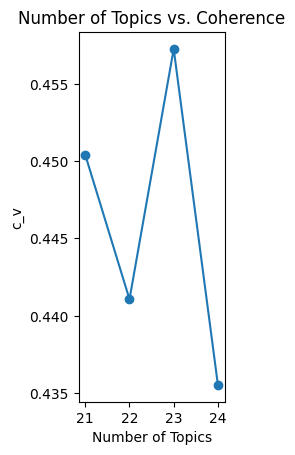

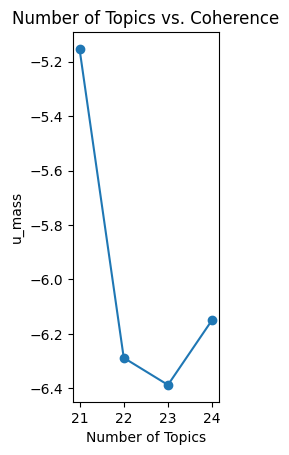

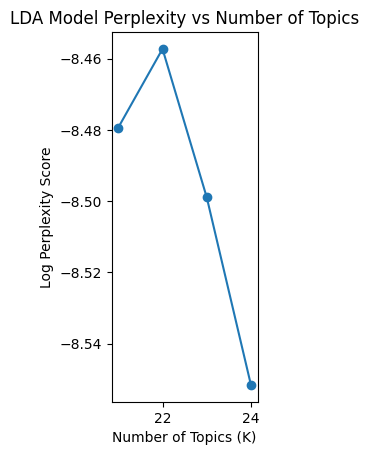

In [ ]:
reviews_w_ngrams = pd.DataFrame(amazon_df_sa.cleaned_review.copy())
reviews_w_ngrams.cleaned_review = reviews_w_ngrams.cleaned_review.map(lambda x: replace_ngram(x) if isinstance(x, str) else x)

# tokenize reviews + remove stop words + remove names + remove words with less than 2 characters
reviews_w_ngrams = reviews_w_ngrams.cleaned_review.map(lambda x: [word for word in x.split() if word not in stop_words and len(word) > 2] if isinstance(x, str) else x)
reviews_w_ngrams.dropna(axis=0, inplace=True)
reviews_w_ngrams.isnull().sum()

final_reviews = reviews_w_ngrams
final_reviews.dropna(axis=0, inplace=True)

dictionary = corpora.Dictionary(final_reviews)
doc_term_matrix = [dictionary.doc2bow(doc) for doc in final_reviews]

coherence = []
umass = []
px = []
topic_range = range(21, 25)
for k in topic_range:
    print('Round: '+str(k))
    Lda = gensim.models.ldamodel.LdaModel
    ldamodel = Lda(doc_term_matrix, num_topics=k, id2word = dictionary, passes=40,\
                   iterations=200, chunksize = 10000, eval_every = None, random_state=0)
    
    cm = gensim.models.coherencemodel.CoherenceModel(model=ldamodel, texts=final_reviews,\
                                                     dictionary=dictionary, coherence='c_v')
    mm = gensim.models.coherencemodel.CoherenceModel(model=ldamodel, texts=final_reviews,\
                                                     dictionary=dictionary, coherence='u_mass')
    coherence.append((k,cm.get_coherence()))
    umass.append((k,mm.get_coherence()))
    px.append(ldamodel.log_perplexity(doc_term_matrix))
    
    
x_val = [x[0] for x in coherence]
y_val = [x[1] for x in coherence]

x_val_u = [x[0] for x in umass]
y_val_y = [x[1] for x in umass]

plt.subplot(1,3,1)
plt.plot(x_val,y_val)
plt.scatter(x_val,y_val)
plt.title('Number of Topics vs. Coherence')
plt.xlabel('Number of Topics')
plt.ylabel('c_v')
plt.xticks(x_val)
plt.show()

plt.subplot(1,3,2)
plt.plot(x_val_u,y_val_y)
plt.scatter(x_val_u,y_val_y)
plt.title('Number of Topics vs. Coherence')
plt.xlabel('Number of Topics')
plt.ylabel('u_mass')
plt.xticks(x_val_u)
plt.show()

plt.subplot(1,3,3)
plt.plot(topic_range, px, marker='o')
plt.xlabel("Number of Topics (K)")
plt.ylabel("Log Perplexity Score")
plt.title("LDA Model Perplexity vs Number of Topics")
plt.show()

In [ ]:
for i in topic_range:
    name = 'sa_all'
    num = i
    Lda = gensim.models.ldamodel.LdaModel
    ldamodel = Lda(doc_term_matrix, num_topics=num, id2word = dictionary, passes=40,\
                iterations=200,  chunksize = 10000, eval_every = None, random_state=0)
    Lda2 = gensim.models.ldamodel.LdaModel
    ldamodel2 = Lda2(doc_term_matrix, num_topics=num, id2word = dictionary, passes=40,\
                iterations=200,  chunksize = 10000, eval_every = None, random_state=0)
    
    # To show initial topics
    ldamodel.show_topics(num, num_words=10, formatted=False)
    
    # To show initial topics
    ldamodel2.show_topics(num, num_words=10, formatted=False)
    
    # Visualize the topics
    pyLDAvis.enable_notebook()
    LDAvis_data_filepath = os.path.join('./results/ldavis_prepared_'+'v3_0129')
    
    # Create directory if it does not exist
    if not os.path.exists('./results'):
        os.makedirs('./results')
    LDAvis_prepared = pyLDAvis.gensim.prepare(ldamodel2, doc_term_matrix, dictionary, mds = 'pcoa')
    with open(LDAvis_data_filepath, 'wb') as f:
        pickle.dump(LDAvis_prepared, f)
        
    # load the pre-prepared pyLDAvis data from disk
    with open(LDAvis_data_filepath, 'rb') as f:
        LDAvis_prepared = pickle.load(f)
    pyLDAvis.save_html(LDAvis_prepared, './results/ldavis_prepared_'+ f'{name}_{num}' +'.html')
    display(LDAvis_prepared)
    
    topic_data = LDAvis_prepared
    all_topics = {}
    num_terms = 10  # Adjust number of words to represent each topic
    lambd = 0.6  # Adjust this accordingly based on tuning above
    for j in range(1, num + 1):  # Adjust this to reflect number of topics chosen for final LDA model
        topic = topic_data.topic_info[topic_data.topic_info.Category == 'Topic' + str(j)].copy()
        topic['relevance'] = topic['loglift'] * (1 - lambd) + topic['logprob'] * lambd
        # 리스트 길이 보정: max_length 만큼 패딩 (NaN 추가)
        terms = topic.sort_values(by='relevance', ascending=False).Term.tolist()
        all_topics['Topic ' + str(j)] = terms[:num_terms] + [None] * (num_terms - len(terms))
    lda2_test_results = pd.DataFrame.from_dict(all_topics, orient='index')
    display(lda2_test_results)

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
16     0.243801 -0.168420       1        1  37.172760
0      0.258152 -0.148237       2        1  23.589155
11     0.277529 -0.061680       3        1  10.603771
20    -0.156946 -0.078402       4        1   3.503599
3      0.136472  0.037804       5        1   2.949847
17     0.008645  0.145679       6        1   1.968894
5     -0.150659 -0.082803       7        1   1.755551
14     0.039252 -0.089318       8        1   1.692464
18    -0.064022 -0.034443       9        1   1.667796
13     0.007005 -0.129041      10        1   1.639346
12    -0.111068 -0.130318      11        1   1.635441
6     -0.186897 -0.025006      12        1   1.521492
10    -0.190345  0.005995      13        1   1.484036
8      0.155032  0.129169      14        1   1.418858
2     -0.072094 -0.050177      15        1   1.399626
4     -0.103710 -0.100820      16        1   1.182168
9      0.004201  0.262383      17        1   1.077976
7      0.043358  0.195637      18        1   1.061475
15    -0.125538 -0.022010      19        1   0.972851
1     -0.061402  0.125978      20        1   0.971260
19     0.049236  0.218027      21        1   0.731635, topic_info=                       Term         Freq        Total Category  logprob  \
1                      face  3092.000000  3092.000000  Default  30.0000   
74                    cream  1747.000000  1747.000000  Default  29.0000   
27                sensitive  1566.000000  1566.000000  Default  28.0000   
613                   serum  1732.000000  1732.000000  Default  27.0000   
23                recommend  1139.000000  1139.000000  Default  26.0000   
107             moisturizer  1211.000000  1211.000000  Default  25.0000   
546                    soft  1096.000000  1096.000000  Default  24.0000   
1389                    kit  1019.000000  1019.000000  Default  23.0000   
194                    oily   752.000000   752.000000  Default  22.0000   
13                      dry  1533.000000  1533.000000  Default  21.0000   
679                   toner   934.000000   934.000000  Default  20.0000   
45                    smell   726.000000   726.000000  Default  19.0000   
939                  gentle   748.000000   748.000000  Default  18.0000   
53                      day   909.000000   909.000000  Default  17.0000   
5                     light   766.000000   766.000000  Default  16.0000   
337                hydrated   799.000000   799.000000  Default  15.0000   
1488               cleanser   927.000000   927.000000  Default  14.0000   
59                     long   653.000000   653.000000  Default  13.0000   
93                  routine   900.000000   900.000000  Default  12.0000   
25                  redness   658.000000   658.000000  Default  11.0000   
477                 absorbs   514.000000   514.000000  Default  10.0000   
225                  bottle   675.000000   675.000000  Default   9.0000   
142                   price   589.000000   589.000000  Default   8.0000   
254                    easy   560.000000   560.000000  Default   7.0000   
149                   small   495.000000   495.000000  Default   6.0000   
75                     days   497.000000   497.000000  Default   5.0000   
86               irritation   544.000000   544.000000  Default   4.0000   
99                      sun   512.000000   512.000000  Default   3.0000   
571                   night   734.000000   734.000000  Default   2.0000   
193            moisturizing   661.000000   661.000000  Default   1.0000   
3792                  weigh   362.382831   362.836205   Topic1  -5.0439   
3650                   toes   360.510369   360.963743   Topic1  -5.0490   
11010                  fame   360.304042   360.757416   Topic1  -5.0496   
1440                retinol   340.563015   341.016394   Topic1  -5.1060   
609                   masks   272.280379   272.733753   Topic1  -5.3297   
273            

,0,1,2,3,4,5,6,7,8,9
Topic 1,face,scent,serum,weigh,toes,fame,retinol,bottle,cream,masks
Topic 2,moisturizer,dry,face,oily,night,smooth,glow,difference,day,soft
Topic 3,combinationsensitive,foundation,patches,lips,pads,pores,red,color,eyes,tone
Topic 4,toner,soothed,they’re,beautifully,whatsoever,potions,travelsize,unscented,effective,includes
Topic 5,neck,helped,overpowering,size,nearly,healthier,redness,manage,smell,days
Topic 6,delicate,recommend,suitable,touch,comfortable,problems,anti,whether,unless,specific
Topic 7,step,important,person,idea,cleansed,occasional,concerned,sellers,352,included
Topic 8,rate,cool,centella,cleans,pass,miniature,resecting,panthenol,hydrates,containers
Topic 9,sunscreen,contains,high,sun,three,wonderfully,peels,reapply,forgot,contained
Topic 10,weekend,asian,barrier,tonic,extract,repair,calms,perfume,dirt,effectively


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
16     0.099868 -0.261379       1        1  40.212632
0      0.104799 -0.268544       2        1  18.715729
10     0.191600 -0.192485       3        1  10.181316
11     0.238476 -0.044854       4        1   4.683109
14     0.201809  0.013468       5        1   2.663089
12    -0.155393 -0.057207       6        1   2.250474
9     -0.103590  0.095995       7        1   2.154445
18    -0.202058 -0.065498       8        1   1.964001
7     -0.113922 -0.087707       9        1   1.801737
17    -0.073118 -0.098230      10        1   1.609436
3     -0.038029 -0.008440      11        1   1.606521
1      0.178745  0.075918      12        1   1.419938
5     -0.246481 -0.043252      13        1   1.394238
21     0.010827  0.143501      14        1   1.278495
2     -0.039043  0.018936      15        1   1.224927
8      0.171827  0.129568      16        1   1.145706
19     0.100372  0.202970      17        1   1.091463
13    -0.057048  0.067485      18        1   1.051501
6     -0.198664 -0.001316      19        1   0.983142
20     0.124747  0.198599      20        1   0.957955
15    -0.189035  0.099899      21        1   0.822518
4     -0.006690  0.082572      22        1   0.787629, topic_info=                       Term         Freq        Total Category  logprob  \
1                      face  3077.000000  3077.000000  Default  30.0000   
74                    cream  1719.000000  1719.000000  Default  29.0000   
546                    soft  1290.000000  1290.000000  Default  28.0000   
613                   serum  1593.000000  1593.000000  Default  27.0000   
23                recommend  1103.000000  1103.000000  Default  26.0000   
27                sensitive  1484.000000  1484.000000  Default  25.0000   
53                      day   937.000000   937.000000  Default  24.0000   
1389                    kit   808.000000   808.000000  Default  23.0000   
45                    smell   676.000000   676.000000  Default  22.0000   
5                     light   754.000000   754.000000  Default  21.0000   
13                      dry  1538.000000  1538.000000  Default  20.0000   
1488               cleanser   883.000000   883.000000  Default  19.0000   
107             moisturizer  1206.000000  1206.000000  Default  18.0000   
254                    easy   557.000000   557.000000  Default  17.0000   
679                   toner   818.000000   818.000000  Default  16.0000   
93                  routine   810.000000   810.000000  Default  15.0000   
939                  gentle   643.000000   643.000000  Default  14.0000   
194                    oily   734.000000   734.000000  Default  13.0000   
142                   price   583.000000   583.000000  Default  12.0000   
33                  wearing   335.000000   335.000000  Default  11.0000   
59                     long   631.000000   631.000000  Default  10.0000   
40                   greasy   450.000000   450.000000  Default   9.0000   
84                    helps   417.000000   417.000000  Default   8.0000   
25                  redness   606.000000   606.000000  Default   7.0000   
149                   small   521.000000   521.000000  Default   6.0000   
82                  healthy   355.000000   355.000000  Default   5.0000   
86               irritation   459.000000   459.000000  Default   4.0000   
317                  pretty   381.000000   381.000000  Default   3.0000   
381                  travel   439.000000   439.000000  Default   2.0000   
470                  smooth   707.000000   707.000000  Default   1.0000   
2508         recommendation   375.246415   375.782799   Topic1  -5.0876   
10851           possibility   361.252752   361.789136   Topic1  -5.1256   
4422                dipping   359.775273   360.311657   Topic1  -5.1297   
6580              childhood   359.449941   359.986325   Topic1  -5.1306   
593                 cooling   137.12

,0,1,2,3,4,5,6,7,8,9
Topic 1,face,serum,cream,scent,recommendation,possibility,dipping,childhood,retinol,absorbs
Topic 2,dry,face,cleanser,moisturizer,clean,night,smooth,sensitive,difference,oily
Topic 3,pores,lips,toner,essence,lip,shade,foundation,glass,snail_mucin,day
Topic 4,compete,patches,eyes,eye,color,pimple,pimples,foundation,spots,red
Topic 5,healthy,gym,soft,pads,extract,pad,beet,glycol,pink,sodium
Topic 6,kit,toner,sunscreens,they’re,soothed,boost,convenient,strip,whatsoever,pamper
Topic 7,delicate,general,excellent,comfortable,centella,opinion,suitable,problems,cream,anti
Topic 8,step,protection,kit,included,person,serum,content,face,attention,women
Topic 9,hydrates,cleaner,ideal,centella,finally,panthenol,excellent,offers,traveling,asiatica
Topic 10,asian,barrier,ideal,extract,repair,calms,effectively,mixed,impurities,light


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
16     0.180015  0.096720       1        1  58.432214
18     0.206331  0.134221       2        1  10.699808
21     0.028520  0.120771       3        1   2.928618
14     0.138308  0.068226       4        1   2.067121
12     0.047372  0.061256       5        1   1.940177
3      0.124424  0.143574       6        1   1.910032
10     0.037189 -0.047978       7        1   1.838049
0     -0.128493  0.092283       8        1   1.835046
4      0.206462 -0.067480       9        1   1.761598
11     0.114339 -0.004196      10        1   1.558249
1     -0.004729  0.062748      11        1   1.527707
8     -0.039897  0.074560      12        1   1.485637
20    -0.124028 -0.003625      13        1   1.346407
22     0.004723 -0.269997      14        1   1.309930
19    -0.165805  0.107954      15        1   1.244528
6     -0.109554  0.027999      16        1   1.211810
2     -0.045150 -0.083162      17        1   1.162940
17    -0.147403  0.122764      18        1   1.147214
7     -0.149004 -0.073305      19        1   1.046302
5      0.022653 -0.166245      20        1   0.959273
9      0.095122 -0.257249      21        1   0.937775
15    -0.208433  0.044478      22        1   0.851955
13    -0.082961 -0.184320      23        1   0.797611, topic_info=                       Term         Freq        Total Category  logprob  \
1                      face  3036.000000  3036.000000  Default  30.0000   
74                    cream  1887.000000  1887.000000  Default  29.0000   
613                   serum  1708.000000  1708.000000  Default  28.0000   
27                sensitive  1516.000000  1516.000000  Default  27.0000   
23                recommend  1143.000000  1143.000000  Default  26.0000   
107             moisturizer  1186.000000  1186.000000  Default  25.0000   
546                    soft  1131.000000  1131.000000  Default  24.0000   
13                      dry  1484.000000  1484.000000  Default  23.0000   
194                    oily   773.000000   773.000000  Default  22.0000   
1389                    kit   891.000000   891.000000  Default  21.0000   
53                      day   883.000000   883.000000  Default  20.0000   
337                hydrated   726.000000   726.000000  Default  19.0000   
679                   toner  1021.000000  1021.000000  Default  18.0000   
1488               cleanser  1087.000000  1087.000000  Default  17.0000   
5                     light   771.000000   771.000000  Default  16.0000   
477                 absorbs   548.000000   548.000000  Default  15.0000   
45                    smell   643.000000   643.000000  Default  14.0000   
40                   greasy   517.000000   517.000000  Default  13.0000   
193            moisturizing   632.000000   632.000000  Default  12.0000   
254                    easy   552.000000   552.000000  Default  11.0000   
470                  smooth   706.000000   706.000000  Default  10.0000   
142                   price   680.000000   680.000000  Default   9.0000   
93                  routine   859.000000   859.000000  Default   8.0000   
25                  redness   677.000000   677.000000  Default   7.0000   
84                    helps   431.000000   431.000000  Default   6.0000   
59                     long   640.000000   640.000000  Default   5.0000   
939                  gentle   719.000000   719.000000  Default   4.0000   
225                  bottle   654.000000   654.000000  Default   3.0000   
86               irritation   569.000000   569.000000  Default   2.0000   
39                     find   525.000000   525.000000  Default   1.0000   
8                      acne   473.398818   473.817877   Topic1  -5.2289   
280             lightweight   419.251435   419.670528   Topic1  -5.3504   
282                   pores   416.449631   416.868703   Topic1  -5.3571   
10786              discover   362.416473   362.835527   T

,0,1,2,3,4,5,6,7,8,9
Topic 1,face,moisturizer,dry,texture,serum,sensitive,day,scent,night,moisturizing
Topic 2,cleanser,clean,regard,oil,lips,pads,face_wash,balm,face,cleansing
Topic 3,high,three,contains,sunscreen,wonderfully,tolerates,days,find,price,irritation
Topic 4,centella,healthy,cool,cleans,sealed,arrive,equally,loyal,calm,resecting
Topic 5,barrier,extract,asian,light,ideal,repair,calms,perfume,dirt,effectively
Topic 6,tops,face,together,overpowering,collagen,nearly,healthier,content,cure,manage
Topic 7,lovely,huge,nose,creams,weather,scentless,fir,fans,travel,particularly
Topic 8,quick,sunscreens,boost,sticky_residue,convenient,strip,trips,strengthens,weigh,retains
Topic 9,soothes,handled,gym,combinationsensitive,snail,undereye,evens,third,booster,peptides
Topic 10,different,uses,beautiful,suited,tested,greasy,panthenol,cream,dislike,vital


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
19     0.082661  0.191753       1        1  45.891089
1      0.179375  0.126374       2        1  14.930402
11     0.189078  0.047637       3        1   6.016791
0      0.138094 -0.095059       4        1   2.925559
16     0.151038 -0.029947       5        1   2.646817
5     -0.059104  0.194730       6        1   2.400550
18    -0.091398  0.158380       7        1   2.313976
4      0.170227 -0.082882       8        1   2.142300
17    -0.136793 -0.036138       9        1   1.796646
23    -0.207184 -0.087268      10        1   1.768535
3      0.007320 -0.053097      11        1   1.667381
12    -0.048602  0.200817      12        1   1.590419
2     -0.063974  0.043338      13        1   1.562733
14    -0.032209  0.228332      14        1   1.442543
10    -0.137790 -0.112963      15        1   1.364172
22     0.021044 -0.185345      16        1   1.217330
6     -0.172585 -0.010708      17        1   1.195639
9      0.011826 -0.117991      18        1   1.192438
7     -0.024719 -0.014151      19        1   1.147144
8      0.174185 -0.014089      20        1   1.077336
21     0.063300 -0.151599      21        1   1.075725
13    -0.171113 -0.125131      22        1   0.927922
15    -0.218530  0.002970      23        1   0.874283
20     0.175853 -0.077963      24        1   0.832270, topic_info=                       Term         Freq        Total Category  logprob  \
1                      face  3116.000000  3116.000000  Default  30.0000   
27                sensitive  1663.000000  1663.000000  Default  29.0000   
23                recommend  1207.000000  1207.000000  Default  28.0000   
74                    cream  1680.000000  1680.000000  Default  27.0000   
107             moisturizer  1218.000000  1218.000000  Default  26.0000   
613                   serum  1601.000000  1601.000000  Default  25.0000   
53                      day   971.000000   971.000000  Default  24.0000   
546                    soft  1118.000000  1118.000000  Default  23.0000   
1389                    kit   796.000000   796.000000  Default  22.0000   
13                      dry  1525.000000  1525.000000  Default  21.0000   
1488               cleanser   889.000000   889.000000  Default  20.0000   
194                    oily   752.000000   752.000000  Default  19.0000   
59                     long   662.000000   662.000000  Default  18.0000   
470                  smooth   719.000000   719.000000  Default  17.0000   
939                  gentle   753.000000   753.000000  Default  16.0000   
5                     light   792.000000   792.000000  Default  15.0000   
679                   toner   959.000000   959.000000  Default  14.0000   
93                  routine   930.000000   930.000000  Default  13.0000   
337                hydrated   716.000000   716.000000  Default  12.0000   
45                    smell   664.000000   664.000000  Default  11.0000   
254                    easy   583.000000   583.000000  Default  10.0000   
142                   price   590.000000   590.000000  Default   9.0000   
477                 absorbs   518.000000   518.000000  Default   8.0000   
480                 happier   378.000000   378.000000  Default   7.0000   
2473               complete   588.000000   588.000000  Default   6.0000   
25                  redness   586.000000   586.000000  Default   5.0000   
149                   small   520.000000   520.000000  Default   4.0000   
40                   greasy   452.000000   452.000000  Default   3.0000   
225                  bottle   654.000000   654.000000  Default   2.0000   
874               hydrating   521.000000   521.000000  Default   1.0000   
691                   clean   549.769462   550.266832   Topic1  -4.8377   
760                     gel   389.042957   389.540911   Topic1  -5.1836   
1013                   glow   386.178871   386.685474   Topic1  -5.1909   
195

,0,1,2,3,4,5,6,7,8,9
Topic 1,face,moisturizer,dry,scent,serum,texture,soft,smooth,clean,oily
Topic 2,reacted,retinol,eyes,foundation,patches,acne,eye_cream,help,cream,color
Topic 3,animal,lips,wake,toner,toners,pricey,masks,pad,experience,single
Topic 4,hydrate,adapted,sensitive,routine,complete,wonders,lathers,nourishing,kept,awhile
Topic 5,mixed,impression,practically,flexible,appealing,spectrum,maintained,visually,replenishes,prolonged
Topic 6,travelsized,wearing,high,quick,daughter,sunscreens,boost,convenient,wonderfully,perfumed
Topic 7,residue,hydrates,excellent,ideal,touch,sensation,improved,offers,asiatica,downside
Topic 8,happier,couldn’t,loyal,combinationsensitive,day,lip,peptide,breaks,reactive,booster
Topic 9,protection,including,face,puritos,inflamed,together,grease,cure,qualities,keen
Topic 10,wish,protective,tube,low,nourished,balanced,prevent,basically,cleansed,purse


###### Dr.Jart+

Round: 21
Round: 22
Round: 23
Round: 24


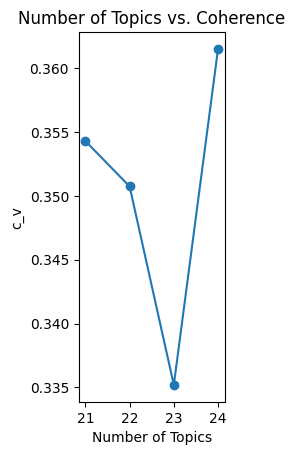

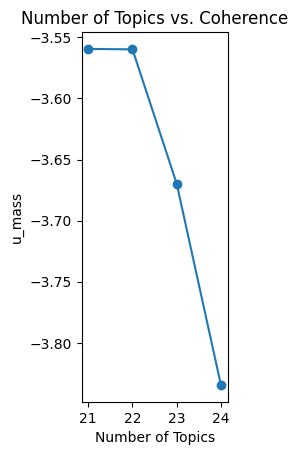

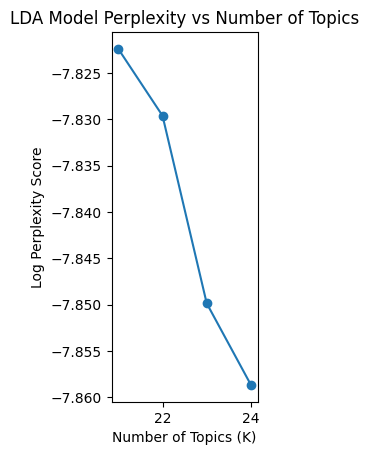

In [ ]:
reviews_w_ngrams = pd.DataFrame(amazon_df_sa_dr.cleaned_review.copy())
reviews_w_ngrams.cleaned_review = reviews_w_ngrams.cleaned_review.map(lambda x: replace_ngram(x) if isinstance(x, str) else x)

# tokenize reviews + remove stop words + remove names + remove words with less than 2 characters
reviews_w_ngrams = reviews_w_ngrams.cleaned_review.map(lambda x: [word for word in x.split() if word not in stop_words and len(word) > 2] if isinstance(x, str) else x)
reviews_w_ngrams.dropna(axis=0, inplace=True)
reviews_w_ngrams.isnull().sum()

final_reviews = reviews_w_ngrams
final_reviews.dropna(axis=0, inplace=True)

dictionary = corpora.Dictionary(final_reviews)
doc_term_matrix = [dictionary.doc2bow(doc) for doc in final_reviews]

coherence = []
umass = []
px = []
topic_range = range(21, 25)
for k in topic_range:
    print('Round: '+str(k))
    Lda = gensim.models.ldamodel.LdaModel
    ldamodel = Lda(doc_term_matrix, num_topics=k, id2word = dictionary, passes=40,\
                   iterations=200, chunksize = 10000, eval_every = None, random_state=0)
    
    cm = gensim.models.coherencemodel.CoherenceModel(model=ldamodel, texts=final_reviews,\
                                                     dictionary=dictionary, coherence='c_v')
    mm = gensim.models.coherencemodel.CoherenceModel(model=ldamodel, texts=final_reviews,\
                                                     dictionary=dictionary, coherence='u_mass')
    coherence.append((k,cm.get_coherence()))
    umass.append((k,mm.get_coherence()))
    px.append(ldamodel.log_perplexity(doc_term_matrix))
    
    
x_val = [x[0] for x in coherence]
y_val = [x[1] for x in coherence]

x_val_u = [x[0] for x in umass]
y_val_y = [x[1] for x in umass]

plt.subplot(1,3,1)
plt.plot(x_val,y_val)
plt.scatter(x_val,y_val)
plt.title('Number of Topics vs. Coherence')
plt.xlabel('Number of Topics')
plt.ylabel('c_v')
plt.xticks(x_val)
plt.show()

plt.subplot(1,3,2)
plt.plot(x_val_u,y_val_y)
plt.scatter(x_val_u,y_val_y)
plt.title('Number of Topics vs. Coherence')
plt.xlabel('Number of Topics')
plt.ylabel('u_mass')
plt.xticks(x_val_u)
plt.show()

plt.subplot(1,3,3)
plt.plot(topic_range, px, marker='o')
plt.xlabel("Number of Topics (K)")
plt.ylabel("Log Perplexity Score")
plt.title("LDA Model Perplexity vs Number of Topics")
plt.show()

In [ ]:
for i in topic_range:
    name = 'sa_dr'
    num = i
    Lda = gensim.models.ldamodel.LdaModel
    ldamodel = Lda(doc_term_matrix, num_topics=num, id2word = dictionary, passes=40,\
                iterations=200,  chunksize = 10000, eval_every = None, random_state=0)
    Lda2 = gensim.models.ldamodel.LdaModel
    ldamodel2 = Lda2(doc_term_matrix, num_topics=num, id2word = dictionary, passes=40,\
                iterations=200,  chunksize = 10000, eval_every = None, random_state=0)
    
    # To show initial topics
    ldamodel.show_topics(num, num_words=10, formatted=False)
    
    # To show initial topics
    ldamodel2.show_topics(num, num_words=10, formatted=False)
    
    # Visualize the topics
    pyLDAvis.enable_notebook()
    LDAvis_data_filepath = os.path.join('./results/ldavis_prepared_'+'v3_0129')
    
    # Create directory if it does not exist
    if not os.path.exists('./results'):
        os.makedirs('./results')
    LDAvis_prepared = pyLDAvis.gensim.prepare(ldamodel2, doc_term_matrix, dictionary, mds = 'pcoa')
    with open(LDAvis_data_filepath, 'wb') as f:
        pickle.dump(LDAvis_prepared, f)
        
    # load the pre-prepared pyLDAvis data from disk
    with open(LDAvis_data_filepath, 'rb') as f:
        LDAvis_prepared = pickle.load(f)
    pyLDAvis.save_html(LDAvis_prepared, './results/ldavis_prepared_'+ f'{name}_{num}' +'.html')
    display(LDAvis_prepared)
    
    topic_data = LDAvis_prepared
    all_topics = {}
    num_terms = 10  # Adjust number of words to represent each topic
    lambd = 0.6  # Adjust this accordingly based on tuning above
    for j in range(1, num + 1):  # Adjust this to reflect number of topics chosen for final LDA model
        topic = topic_data.topic_info[topic_data.topic_info.Category == 'Topic' + str(j)].copy()
        topic['relevance'] = topic['loglift'] * (1 - lambd) + topic['logprob'] * lambd
        # 리스트 길이 보정: max_length 만큼 패딩 (NaN 추가)
        terms = topic.sort_values(by='relevance', ascending=False).Term.tolist()
        all_topics['Topic ' + str(j)] = terms[:num_terms] + [None] * (num_terms - len(terms))
    lda2_test_results = pd.DataFrame.from_dict(all_topics, orient='index')
    display(lda2_test_results)

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
3     -0.081753 -0.099780       1        1  8.480646
8     -0.054101 -0.124655       2        1  7.920434
4     -0.063853 -0.062831       3        1  7.011451
16     0.106107  0.005009       4        1  6.825700
7     -0.006869 -0.053060       5        1  6.524169
19    -0.041674 -0.011348       6        1  6.371100
17    -0.148898  0.099127       7        1  5.937697
12    -0.048210 -0.047371       8        1  5.817819
13    -0.116309  0.112060       9        1  5.638690
15     0.065309  0.019601      10        1  5.014207
6      0.026952 -0.035263      11        1  4.883821
18     0.092836 -0.013208      12        1  4.700481
14     0.014924 -0.037926      13        1  3.977249
0     -0.002319  0.040068      14        1  3.088145
2      0.101702 -0.011092      15        1  2.983913
11     0.035273 -0.002088      16        1  2.795412
1      0.027592  0.118795      17        1  2.759557
20     0.051901  0.088874      18        1  2.528717
10     0.019928 -0.068258      19        1  2.305340
9      0.040937  0.050940      20        1  2.259899
5     -0.019475  0.032406      21        1  2.175551, topic_info=                            Term        Freq       Total Category  logprob  \
823                         lips   74.000000   74.000000  Default  30.0000   
1                           face  763.000000  763.000000  Default  29.0000   
74                         cream  341.000000  341.000000  Default  28.0000   
1113                         lip   62.000000   62.000000  Default  27.0000   
214                        hands   73.000000   73.000000  Default  26.0000   
46                     sunscreen  128.000000  128.000000  Default  25.0000   
25                       redness  228.000000  228.000000  Default  24.0000   
609                        masks  118.000000  118.000000  Default  23.0000   
613                        serum  287.000000  287.000000  Default  22.0000   
2126                   eye_cream   54.000000   54.000000  Default  21.0000   
367                         hand   56.000000   56.000000  Default  20.0000   
27                     sensitive  220.000000  220.000000  Default  19.0000   
56                    foundation   89.000000   89.000000  Default  18.0000   
1488                    cleanser   98.000000   98.000000  Default  17.0000   
254                         easy  144.000000  144.000000  Default  16.0000   
679                        toner  106.000000  106.000000  Default  15.0000   
2955                        balm   35.000000   35.000000  Default  14.0000   
1343                   face_wash   38.000000   38.000000  Default  13.0000   
97                           spf   68.000000   68.000000  Default  12.0000   
691                        clean   81.000000   81.000000  Default  11.0000   
655                       lotion   72.000000   72.000000  Default  10.0000   
370                  moisturized   94.000000   94.000000  Default   9.0000   
101                         tone   77.000000   77.000000  Default   8.0000   
546                         soft  125.000000  125.000000  Default   7.0000   
23                     recommend  138.000000  138.000000  Default   6.0000   
477                      absorbs  116.000000  116.000000  Default   5.0000   
94                         scent  185.000000  185.000000  Default   4.0000   
35                         color   78.000000   78.000000  Default   3.0000   
71                      cicapair   60.000000   60.000000  Default   2.0000   
409                     tea_tree   61.000000   61.000000  Default   1.0000   
3375                     velvety    2.815842    3.627322   Topic1  -6.8225   
1651                     buildup    2.813750    3.627074   Topic1  -6.8233   
3839                    sanitary    2.810436    3.626677   Topic1  -6.8245   
1264                     plumper    4.563144    6.350186   Topic1  -6.3398   
2695    

,0,1,2,3,4,5,6,7,8,9
Topic 1,moisturizer,irritation,scent,gentle,cleanser,texture,face,cream,greasy,retinol
Topic 2,redness,cicapair,soothing,serum,calming,sensitive,cooling,sensation,moisturizer,irritated
Topic 3,hands,hand,lotion,absorbs,greasy,cream,creams,scent,dry,moisturizing
Topic 4,sunscreen,sunscreens,extract,physical,mineral,white,spf,protection,sun,chemical
Topic 5,toner,redness,face,kit,green,normal,lotion,cream,repair,long
Topic 6,face,sensitive,cream,powder,things,months,water,night,moisturize,glides
Topic 7,lips,lip,balm,face,dry,serum,hydrated,cute,jelly,slide
Topic 8,mud,clay,clean,face,serum,tea_tree,moisturizer,something,dry,smell
Topic 9,face,easy,moisturized,morning,overnight,peel,soft,night,smooth,effect
Topic 10,sunscreen,day,toner,gold,barrier,acne,white,natural,rub,mix


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
19     0.045422  0.043545       1        1  9.046109
16     0.055317  0.025011       2        1  7.261767
17    -0.151162 -0.118910       3        1  6.328746
4     -0.022963  0.064433       4        1  6.110080
21    -0.005458  0.000049       5        1  5.986688
7      0.012696  0.018618       6        1  5.422534
13    -0.085227 -0.054266       7        1  4.954922
10     0.214385 -0.205705       8        1  4.913153
9      0.045000  0.061954       9        1  4.827676
12    -0.052157 -0.056585      10        1  4.816805
8     -0.071748 -0.042585      11        1  4.816299
15     0.046586  0.017242      12        1  4.584479
18    -0.019107  0.137429      13        1  4.488631
3     -0.033257  0.005262      14        1  4.417802
14     0.040533  0.069149      15        1  3.524047
2      0.039599  0.059715      16        1  3.087448
6      0.010635  0.050272      17        1  3.070625
1     -0.081010 -0.047456      18        1  2.989784
5     -0.019372  0.013774      19        1  2.761077
20    -0.023611 -0.008085      20        1  2.683635
0      0.077823  0.023440      21        1  2.426057
11    -0.022924 -0.056301      22        1  1.481637, topic_info=                                          Term        Freq       Total  \
1488                                  cleanser   97.000000   97.000000   
74                                       cream  340.000000  340.000000   
613                                      serum  285.000000  285.000000   
1                                         face  762.000000  762.000000   
823                                       lips   74.000000   74.000000   
1113                                       lip   62.000000   62.000000   
214                                      hands   73.000000   73.000000   
46                                   sunscreen  129.000000  129.000000   
691                                      clean   80.000000   80.000000   
367                                       hand   55.000000   55.000000   
1343                                 face_wash   39.000000   39.000000   
679                                      toner  103.000000  103.000000   
25                                     redness  229.000000  229.000000   
13                                         dry  283.000000  283.000000   
107                                moisturizer  248.000000  248.000000   
27                                   sensitive  218.000000  218.000000   
254                                       easy  143.000000  143.000000   
2126                                 eye_cream   55.000000   55.000000   
409                                   tea_tree   60.000000   60.000000   
408                                        oil   59.000000   59.000000   
609                                      masks  121.000000  121.000000   
53                                         day  169.000000  169.000000   
240                                       eyes   51.000000   51.000000   
1496                                      foam   26.000000   26.000000   
2955                                      balm   35.000000   35.000000   
1616                                   foaming   31.000000   31.000000   
546                                       soft  123.000000  123.000000   
470                                     smooth  116.000000  116.000000   
750                                        eye   33.000000   33.000000   
71                                    cicapair   59.000000   59.000000   
2494                                enthusiast    8.401908    9.218051   
1479                                  inflamed    6.544141    7.360196   
4459                                     ahava    5.615090    6.431306   
1380                                  enhances    5.610583    6.430263   
2825                                      camo    3.757383    4.573445   
2493                 

,0,1,2,3,4,5,6,7,8,9
Topic 1,redness,tone,tiger,foundation,grass,drops,powder,sensitive,moisturizer,soothing
Topic 2,sunscreen,extract,sunscreens,physical,white,mineral,face,leaf,spf,protection
Topic 3,lip,lips,balm,face,masks,dry,serum,fit,tonight,cute
Topic 4,hands,hand,cream,light,lotion,absorbs,tube,moisturizing,dab,healthy
Topic 5,moisturizer,gel,hydrated,redness,easy,overnight,day,cooling,smoothly,moisturized
Topic 6,kit,redness,cicapair,recommend,travel,cream,green,alone,size,toner
Topic 7,face,easy,moisturized,soft,smooth,morning,peel,night,huge,difference
Topic 8,cleanser,face_wash,clean,foam,foaming,tea_tree,oil,cleansing,lather,sensitive
Topic 9,dry,plump,night,cream,vital,morning,hydro,hyaluronic_acid,essence,hydra
Topic 10,face,serum,mud,toner,redness,brighter,poreremedy,messy,masks,change


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
8      0.116001  0.049790       1        1  9.063314
4      0.005234  0.157636       2        1  6.446506
13    -0.144839  0.088232       3        1  5.934472
19     0.030890  0.022450       4        1  5.808271
12    -0.059670 -0.007813       5        1  5.748817
16    -0.007184 -0.082702       6        1  5.714516
15     0.032088 -0.011548       7        1  5.544421
7      0.021335  0.016960       8        1  5.329938
20     0.149813  0.071436       9        1  5.318555
17    -0.136674  0.049991      10        1  5.076067
3     -0.007419  0.034784      11        1  4.751725
18    -0.026973 -0.015460      12        1  4.676007
14     0.029197 -0.018370      13        1  3.915434
9     -0.068773  0.089214      14        1  3.511599
6      0.016471 -0.093359      15        1  3.429396
1     -0.080388 -0.066879      16        1  3.163090
11     0.049736 -0.058439      17        1  3.027204
21     0.053732  0.025861      18        1  2.868526
5     -0.073448 -0.045290      19        1  2.702169
10     0.117794 -0.040460      20        1  2.179697
2      0.042259  0.013272      21        1  1.984416
0     -0.011854 -0.080410      22        1  1.913199
22    -0.047329 -0.098895      23        1  1.892662, topic_info=                            Term        Freq       Total Category  logprob  \
1                           face  762.000000  762.000000  Default  30.0000   
74                         cream  343.000000  343.000000  Default  29.0000   
25                       redness  228.000000  228.000000  Default  28.0000   
214                        hands   73.000000   73.000000  Default  27.0000   
409                     tea_tree   62.000000   62.000000  Default  26.0000   
194                         oily  107.000000  107.000000  Default  25.0000   
107                  moisturizer  247.000000  247.000000  Default  24.0000   
679                        toner  107.000000  107.000000  Default  23.0000   
1113                         lip   60.000000   60.000000  Default  22.0000   
13                           dry  284.000000  284.000000  Default  21.0000   
1488                    cleanser   99.000000   99.000000  Default  20.0000   
46                     sunscreen  127.000000  127.000000  Default  19.0000   
609                        masks  120.000000  120.000000  Default  18.0000   
367                         hand   56.000000   56.000000  Default  17.0000   
823                         lips   73.000000   73.000000  Default  16.0000   
613                        serum  287.000000  287.000000  Default  15.0000   
56                    foundation   90.000000   90.000000  Default  14.0000   
408                          oil   59.000000   59.000000  Default  13.0000   
2126                   eye_cream   53.000000   53.000000  Default  12.0000   
71                      cicapair   60.000000   60.000000  Default  11.0000   
601                       rubber   33.000000   33.000000  Default  10.0000   
546                         soft  125.000000  125.000000  Default   9.0000   
39                          find   85.000000   85.000000  Default   8.0000   
477                      absorbs  114.000000  114.000000  Default   7.0000   
240                         eyes   50.000000   50.000000  Default   6.0000   
760                          gel   83.000000   83.000000  Default   5.0000   
1395                     extract   35.000000   35.000000  Default   4.0000   
314                      morning   87.000000   87.000000  Default   3.0000   
193                 moisturizing  134.000000  134.000000  Default   2.0000   
593                      cooling   82.000000   82.000000  Default   1.0000   
2494                  enthusiast    8.395844    9.211760   Topic1  -5.7965   
85                  inflammation    5.610517    6.426387   Topic1  -6.1996   
1380                    enhances    5.610434    6.426373  

,0,1,2,3,4,5,6,7,8,9
Topic 1,soothing,cicapair,redness,cooling,calming,sensitive,serum,cica,cleanser,foaming
Topic 2,hands,hand,cream,absorbs,gel,scent,beads,greasy,dry,find
Topic 3,face,morning,moisturized,night,overnight,smooth,soft,masks,easy,essence
Topic 4,moisturizer,face,cream,drops,dewy,sticky,tinted,spf,sensitive,green
Topic 5,face,serum,enough,mud,cost,day,clay,masks,find,clean
Topic 6,extract,sunscreens,sunscreen,physical,leaf,lips,microparticles,glycol,tube,gets
Topic 7,sunscreen,day,toner,foundation,dry,ceramides,barrier,gold,body_lotion,white
Topic 8,redness,moisturizing,recommend,covers,small,lotion,serum,self,price,scent
Topic 9,tea_tree,toner,oily,oil,cleanser,foam,cool,smell,scent,combination
Topic 10,face,lip,balm,fit,serum,tonight,lips,thick,single,stayed


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
8     -0.163663  0.117502       1        1  8.021415
13     0.166951  0.050363       2        1  7.033791
16    -0.085373 -0.109435       3        1  6.525124
4      0.007590  0.001994       4        1  6.485420
19    -0.053485  0.081246       5        1  6.067667
17     0.085689  0.099630       6        1  5.832760
12     0.050428  0.034050       7        1  5.576301
7     -0.063786  0.038081       8        1  4.933303
15    -0.021049 -0.046896       9        1  4.883717
3     -0.015836  0.057772      10        1  4.396648
9      0.072659 -0.179850      11        1  4.294097
14    -0.053226 -0.033599      12        1  4.188700
18    -0.063946 -0.056727      13        1  3.825624
6     -0.023316 -0.059195      14        1  3.430673
1      0.064019  0.021768      15        1  3.183465
0     -0.062611 -0.020082      16        1  2.899755
5      0.059832  0.025103      17        1  2.867100
2     -0.029949 -0.004295      18        1  2.637353
20    -0.002900 -0.001354      19        1  2.503486
21     0.016411  0.029450      20        1  2.466013
10    -0.054456 -0.021723      21        1  2.182049
11     0.013065  0.042217      22        1  2.174259
22     0.127370 -0.003742      23        1  2.069339
23     0.029582 -0.062279      24        1  1.521940, topic_info=                            Term        Freq       Total Category  logprob  \
1488                    cleanser   96.000000   96.000000  Default  30.0000   
74                         cream  342.000000  342.000000  Default  29.0000   
823                         lips   74.000000   74.000000  Default  28.0000   
1                           face  766.000000  766.000000  Default  27.0000   
1113                         lip   62.000000   62.000000  Default  26.0000   
25                       redness  230.000000  230.000000  Default  25.0000   
214                        hands   73.000000   73.000000  Default  24.0000   
691                        clean   80.000000   80.000000  Default  23.0000   
46                     sunscreen  129.000000  129.000000  Default  22.0000   
2126                   eye_cream   53.000000   53.000000  Default  21.0000   
609                        masks  118.000000  118.000000  Default  20.0000   
613                        serum  286.000000  286.000000  Default  19.0000   
107                  moisturizer  248.000000  248.000000  Default  18.0000   
1343                   face_wash   38.000000   38.000000  Default  17.0000   
13                           dry  285.000000  285.000000  Default  16.0000   
83                         heavy   71.000000   71.000000  Default  15.0000   
367                         hand   56.000000   56.000000  Default  14.0000   
679                        toner  105.000000  105.000000  Default  13.0000   
194                         oily  107.000000  107.000000  Default  12.0000   
56                    foundation   91.000000   91.000000  Default  11.0000   
53                           day  170.000000  170.000000  Default  10.0000   
370                  moisturized   95.000000   95.000000  Default   9.0000   
1616                     foaming   31.000000   31.000000  Default   8.0000   
314                      morning   87.000000   87.000000  Default   7.0000   
2955                        balm   35.000000   35.000000  Default   6.0000   
254                         easy  144.000000  144.000000  Default   5.0000   
1496                        foam   25.000000   25.000000  Default   4.0000   
240                         eyes   50.000000   50.000000  Default   3.0000   
546                         soft  126.000000  126.000000  Default   2.0000   
40                        greasy  119.000000  119.000000  Default   1.0000   
2494                  enthusiast    8.338266    9.155473   Topic1  -5.6813   
1380                    enhances    5.571354    6.388655   Topic1  -6.0845   
1753 

,0,1,2,3,4,5,6,7,8,9
Topic 1,redness,calming,soothing,cooling,treatment,serum,sensitive,cicapair,sensation,moisturizer
Topic 2,face,moisturized,morning,easy,night,soft,smooth,plump,hydrating,dry
Topic 3,sunscreen,extract,sunscreens,protection,sun,physical,leaf,spf,glycol,mineral
Topic 4,hands,hand,cream,absorbs,greasy,scent,light,dry,moisturizing,small
Topic 5,sensitive,face,redness,calm,cream,moisturizer,serum,ton,applying,difference
Topic 6,lips,lip,balm,face,tonight,serum,dry,balms,small,noticeable
Topic 7,toner,face,serum,dry,oily,applied,cover,enough,routine,smell
Topic 8,redness,cream,green,long,water,price,foundation,bottle,red,cheeks
Topic 9,sunscreen,white,foundation,toner,pale,red,dry,spots,takes,gold
Topic 10,bakuchiol,retinol,serum,irritation,face,collagen,shave,pore,prejuvenation,sleeping


###### COSRX

Round: 21
Round: 22
Round: 23
Round: 24


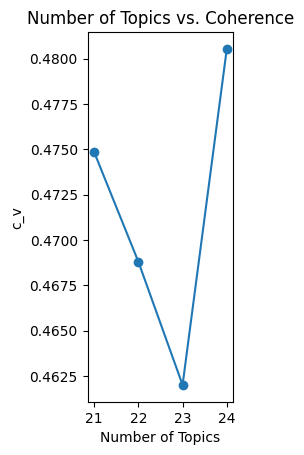

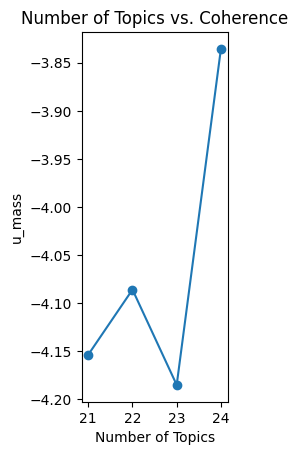

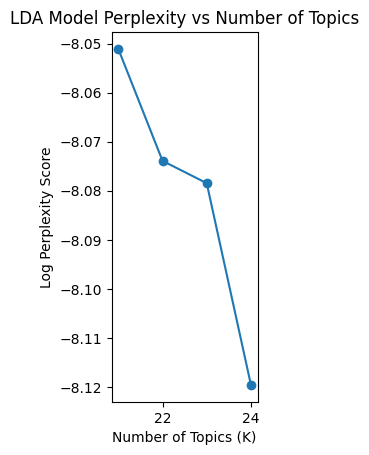

In [ ]:
reviews_w_ngrams = pd.DataFrame(amazon_df_sa_cs.cleaned_review.copy())
reviews_w_ngrams.cleaned_review = reviews_w_ngrams.cleaned_review.map(lambda x: replace_ngram(x) if isinstance(x, str) else x)


# tokenize reviews + remove stop words + remove names + remove words with less than 2 characters
reviews_w_ngrams = reviews_w_ngrams.cleaned_review.map(lambda x: [word for word in x.split() if word not in stop_words and len(word) > 2] if isinstance(x, str) else x)
reviews_w_ngrams.dropna(axis=0, inplace=True)
reviews_w_ngrams.isnull().sum()

final_reviews = reviews_w_ngrams
final_reviews.dropna(axis=0, inplace=True)

dictionary = corpora.Dictionary(final_reviews)
doc_term_matrix = [dictionary.doc2bow(doc) for doc in final_reviews]

coherence = []
umass = []
px = []
topic_range = range(21, 25)
for k in topic_range:
    print('Round: '+str(k))
    Lda = gensim.models.ldamodel.LdaModel
    ldamodel = Lda(doc_term_matrix, num_topics=k, id2word = dictionary, passes=40,\
                   iterations=200, chunksize = 10000, eval_every = None, random_state=0)
    
    cm = gensim.models.coherencemodel.CoherenceModel(model=ldamodel, texts=final_reviews,\
                                                     dictionary=dictionary, coherence='c_v')
    mm = gensim.models.coherencemodel.CoherenceModel(model=ldamodel, texts=final_reviews,\
                                                     dictionary=dictionary, coherence='u_mass')
    coherence.append((k,cm.get_coherence()))
    umass.append((k,mm.get_coherence()))
    px.append(ldamodel.log_perplexity(doc_term_matrix))
    
    
x_val = [x[0] for x in coherence]
y_val = [x[1] for x in coherence]

x_val_u = [x[0] for x in umass]
y_val_y = [x[1] for x in umass]

plt.subplot(1,3,1)
plt.plot(x_val,y_val)
plt.scatter(x_val,y_val)
plt.title('Number of Topics vs. Coherence')
plt.xlabel('Number of Topics')
plt.ylabel('c_v')
plt.xticks(x_val)
plt.show()

plt.subplot(1,3,2)
plt.plot(x_val_u,y_val_y)
plt.scatter(x_val_u,y_val_y)
plt.title('Number of Topics vs. Coherence')
plt.xlabel('Number of Topics')
plt.ylabel('u_mass')
plt.xticks(x_val_u)
plt.show()

plt.subplot(1,3,3)
plt.plot(topic_range, px, marker='o')
plt.xlabel("Number of Topics (K)")
plt.ylabel("Log Perplexity Score")
plt.title("LDA Model Perplexity vs Number of Topics")
plt.show()

In [ ]:
for i in topic_range:
    name = 'sa_cs'
    num = i
    Lda = gensim.models.ldamodel.LdaModel
    ldamodel = Lda(doc_term_matrix, num_topics=num, id2word = dictionary, passes=40,\
                iterations=200,  chunksize = 10000, eval_every = None, random_state=0)
    Lda2 = gensim.models.ldamodel.LdaModel
    ldamodel2 = Lda2(doc_term_matrix, num_topics=num, id2word = dictionary, passes=40,\
                iterations=200,  chunksize = 10000, eval_every = None, random_state=0)
    
    # To show initial topics
    ldamodel.show_topics(num, num_words=10, formatted=False)
    
    # To show initial topics
    ldamodel2.show_topics(num, num_words=10, formatted=False)
    
    # Visualize the topics
    pyLDAvis.enable_notebook()
    LDAvis_data_filepath = os.path.join('./results/ldavis_prepared_'+'v3_0129')
    
    # Create directory if it does not exist
    if not os.path.exists('./results'):
        os.makedirs('./results')
    LDAvis_prepared = pyLDAvis.gensim.prepare(ldamodel2, doc_term_matrix, dictionary, mds = 'pcoa')
    with open(LDAvis_data_filepath, 'wb') as f:
        pickle.dump(LDAvis_prepared, f)
        
    # load the pre-prepared pyLDAvis data from disk
    with open(LDAvis_data_filepath, 'rb') as f:
        LDAvis_prepared = pickle.load(f)
    pyLDAvis.save_html(LDAvis_prepared, './results/ldavis_prepared_'+ f'{name}_{num}' +'.html')
    display(LDAvis_prepared)
    
    topic_data = LDAvis_prepared
    all_topics = {}
    num_terms = 10  # Adjust number of words to represent each topic
    lambd = 0.6  # Adjust this accordingly based on tuning above
    for j in range(1, num + 1):  # Adjust this to reflect number of topics chosen for final LDA model
        topic = topic_data.topic_info[topic_data.topic_info.Category == 'Topic' + str(j)].copy()
        topic['relevance'] = topic['loglift'] * (1 - lambd) + topic['logprob'] * lambd
        # 리스트 길이 보정: max_length 만큼 패딩 (NaN 추가)
        terms = topic.sort_values(by='relevance', ascending=False).Term.tolist()
        all_topics['Topic ' + str(j)] = terms[:num_terms] + [None] * (num_terms - len(terms))
    lda2_test_results = pd.DataFrame.from_dict(all_topics, orient='index')
    display(lda2_test_results)

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
15     0.187651  0.007210       1        1  10.599296
16     0.135379 -0.064508       2        1   8.526463
20     0.131994  0.054670       3        1   7.623970
13     0.030545  0.039975       4        1   6.341933
19    -0.041594 -0.044634       5        1   5.367905
6     -0.059758 -0.072068       6        1   5.137254
7     -0.069562  0.099954       7        1   5.102614
5     -0.008742 -0.042509       8        1   4.541448
3     -0.040344 -0.064572       9        1   4.269076
9      0.058334 -0.056813      10        1   4.041169
4      0.026269 -0.064302      11        1   3.976633
10     0.077455 -0.039662      12        1   3.928389
1     -0.118921  0.009790      13        1   3.880204
17    -0.048606  0.085076      14        1   3.868203
8     -0.062823  0.060363      15        1   3.816772
12    -0.156192 -0.041226      16        1   3.537337
18     0.034952  0.165019      17        1   3.422716
2      0.013968  0.046636      18        1   3.259308
14    -0.003747 -0.036270      19        1   3.007031
0     -0.065673 -0.001360      20        1   2.958345
11    -0.020587 -0.040769      21        1   2.793935, topic_info=                      Term        Freq       Total Category  logprob  loglift
443               cleanser  199.000000  199.000000  Default  30.0000  30.0000
28                   toner  252.000000  252.000000  Default  29.0000  29.0000
163                  pores  197.000000  197.000000  Default  28.0000  28.0000
315               hydrated  208.000000  208.000000  Default  27.0000  27.0000
43                   serum  239.000000  239.000000  Default  26.0000  26.0000
171                    dry  470.000000  470.000000  Default  25.0000  25.0000
2                    clean  138.000000  138.000000  Default  24.0000  24.0000
407              excellent   77.000000   77.000000  Default  23.0000  23.0000
1357               patches  162.000000  162.000000  Default  22.0000  22.0000
210              hydrating  164.000000  164.000000  Default  21.0000  21.0000
135                   acne  217.000000  217.000000  Default  20.0000  20.0000
26                    face  853.000000  853.000000  Default  19.0000  19.0000
313                  cream  284.000000  284.000000  Default  18.0000  18.0000
247            moisturizer  383.000000  383.000000  Default  17.0000  17.0000
39                    soft  289.000000  289.000000  Default  16.0000  16.0000
2634                  lips   74.000000   74.000000  Default  15.0000  15.0000
431                   glow  127.000000  127.000000  Default  14.0000  14.0000
193                   oily  209.000000  209.000000  Default  13.0000  13.0000
246                 gentle  146.000000  146.000000  Default  12.0000  12.0000
464                   size  126.000000  126.000000  Default  11.0000  11.0000
257                 smooth  215.000000  215.000000  Default  10.0000  10.0000
4                    light  153.000000  153.000000  Default   9.0000   9.0000
99                  sticky  153.000000  153.000000  Default   8.0000   8.0000
507                  gives   67.000000   67.000000  Default   7.0000   7.0000
252                  price  170.000000  170.000000  Default   6.0000   6.0000
1335                  eyes   96.000000   96.000000  Default   5.0000   5.0000
196                texture  213.000000  213.000000  Default   4.0000   4.0000
950                 pimple   59.000000   59.000000  Default   3.0000   3.0000
87                  helped   97.000000   97.000000  Default   2.0000   2.0000
44                   smell  172.000000  172.000000  Default   1.0000   1.0000
1436                 boost   12.800593   16.329151   Topic1  -5.8398   2.0009
4091                  dual    2.811240    3.635974   Topic1  -7.3557   1.9871
2953               c_serum    2.811079    3.635810   Topic1  -7.3557   1.9871
3808              boosting    2.730062    3.630689   Topic1  -7

,0,1,2,3,4,5,6,7,8,9
Topic 1,soft,hydrated,serum,sticky,lightweight,recommend,face,moisturizer,moisturized,plump
Topic 2,cream,moisturizer,dry,winter,sunscreen,greasy,thick,light,summer,face
Topic 3,cleanser,clean,gentle,face,scent,fresh,gel,dry,effective,cleans
Topic 4,serum,peptide,eye,niacinamide,booster,months,evening,complexion,sensitive,bottle
Topic 5,patches,face,harsh,gunk,everyday,pimple,pimples,pimple_patches,dry,circle
Topic 6,size,whiteheads,white,difference,pea,travel,face_wash,within,cleared,face
Topic 7,pores,smaller,clogged,blackheads,sebum,notice,breakouts,choice,oily,paula’s
Topic 8,smells,recommended,face,aloe,helps,wake,heavy,likes,light,extract
Topic 9,excellent,face,perfectly,peeling,masks,applied,issues,things,thanks,tingling
Topic 10,lips,hydrating,chapped,hydrates,routine,soothing,nightly,sleep,ulta,glad


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
16     0.158316 -0.006669       1        1  9.236810
20     0.081824 -0.141788       2        1  7.992451
15     0.181029  0.035135       3        1  7.388325
13     0.049168  0.099851       4        1  7.193912
5      0.108167 -0.021043       5        1  5.883675
7     -0.035137 -0.006961       6        1  5.669338
19    -0.040819  0.015901       7        1  4.990584
12    -0.086582 -0.004750       8        1  4.259149
3     -0.010649 -0.092466       9        1  3.977670
9     -0.006858  0.104199      10        1  3.898589
4      0.035637  0.037840      11        1  3.884607
21    -0.022191  0.022856      12        1  3.542093
8     -0.065289  0.128423      13        1  3.500205
6     -0.058451 -0.022583      14        1  3.444029
10     0.088731  0.019400      15        1  3.329652
0     -0.083057 -0.039271      16        1  3.267510
11    -0.101924 -0.055182      17        1  3.181474
1     -0.130504 -0.045619      18        1  3.143418
17    -0.059909  0.077571      19        1  3.126607
14     0.004974 -0.064711      20        1  3.060030
2      0.022100 -0.061737      21        1  3.045761
18    -0.028577  0.021603      22        1  2.984110, topic_info=                    Term        Freq       Total Category  logprob  loglift
443             cleanser  204.000000  204.000000  Default  30.0000  30.0000
28                 toner  248.000000  248.000000  Default  29.0000  29.0000
163                pores  200.000000  200.000000  Default  28.0000  28.0000
2634                lips   75.000000   75.000000  Default  27.0000  27.0000
43                 serum  234.000000  234.000000  Default  26.0000  26.0000
313                cream  284.000000  284.000000  Default  25.0000  25.0000
407            excellent   76.000000   76.000000  Default  24.0000  24.0000
99                sticky  152.000000  152.000000  Default  23.0000  23.0000
26                  face  855.000000  855.000000  Default  22.0000  22.0000
1357             patches  163.000000  163.000000  Default  21.0000  21.0000
171                  dry  471.000000  471.000000  Default  20.0000  20.0000
44                 smell  170.000000  170.000000  Default  19.0000  19.0000
247          moisturizer  383.000000  383.000000  Default  18.0000  18.0000
315             hydrated  205.000000  205.000000  Default  17.0000  17.0000
193                 oily  212.000000  212.000000  Default  16.0000  16.0000
39                  soft  285.000000  285.000000  Default  15.0000  15.0000
91               routine  249.000000  249.000000  Default  14.0000  14.0000
2345               masks   69.000000   69.000000  Default  13.0000  13.0000
2                  clean  140.000000  140.000000  Default  12.0000  12.0000
254           difference  184.000000  184.000000  Default  11.0000  11.0000
1335                eyes   95.000000   95.000000  Default  10.0000  10.0000
135                 acne  219.000000  219.000000  Default   9.0000   9.0000
252                price  169.000000  169.000000  Default   8.0000   8.0000
210            hydrating  164.000000  164.000000  Default   7.0000   7.0000
4                  light  153.000000  153.000000  Default   6.0000   6.0000
431                 glow  127.000000  127.000000  Default   5.0000   5.0000
725               greasy  106.000000  106.000000  Default   4.0000   4.0000
246               gentle  148.000000  148.000000  Default   3.0000   3.0000
6           moisturizing  148.000000  148.000000  Default   2.0000   2.0000
722              absorbs   87.000000   87.000000  Default   1.0000   1.0000
625               summer   26.197088   28.567753   Topic1  -4.9861   2.2953
1445               humid    5.580585    6.420676   Topic1  -6.5324   2.2417
2104              solved    3.744284    4.570663   Topic1  -6.9315   2.1825
895            providing    6.452125    8.242411   Topic1  -6.3873   2.1371
783       moisturization 

,0,1,2,3,4,5,6,7,8,9
Topic 1,cream,moisturizer,greasy,winter,dry,thick,sunscreen,summer,moisture,oily
Topic 2,cleanser,gentle,clean,face,dry,sensitive,effective,gel,lathers,fresh
Topic 3,sticky,soft,hydrated,serum,light,face,essence,lightweight,smooth,glowy
Topic 4,serum,peptide,booster,night,eye,fantastic,morning,collagen,moisturizer,radiant
Topic 5,masks,dry,moisturized,wake,soft,worth,morning,bed,face,hydrated
Topic 6,pores,oily,smaller,blackheads,nose,recommend,large,clogged,breakouts,helps
Topic 7,treatment,spot,face,larger,patches,sensitive,bigger,absorbent,inflammation,harsh
Topic 8,patches,areas,complexion,brighter,pimple_patches,invisible,hydrate,pimples,help,customer
Topic 9,cleared,face,issues,dried,tingling,smell,changed,regimen,negative,past
Topic 10,difference,eyes,hydrating,routine,daily,nightly,fine,glad,notice,repurchase


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
16    -0.131402 -0.047719       1        1  8.661542
20    -0.115150  0.175109       2        1  8.077166
15    -0.114190 -0.038038       3        1  6.348704
5     -0.120083  0.026182       4        1  6.324554
7      0.030281  0.054893       5        1  6.053703
13     0.012646 -0.088573       6        1  5.327811
1      0.214429  0.050716       7        1  5.325411
19     0.029109  0.041078       8        1  5.062407
3     -0.041949  0.082996       9        1  4.114034
10    -0.098085 -0.051953      10        1  3.674218
9     -0.003644 -0.100394      11        1  3.506590
4      0.035192 -0.105933      12        1  3.463407
17     0.037833 -0.026203      13        1  3.433031
22     0.026982 -0.043181      14        1  3.301722
6      0.004802 -0.070188      15        1  3.223626
14    -0.020119  0.021737      16        1  3.144254
11     0.030242  0.034565      17        1  3.095917
0      0.024746 -0.023422      18        1  3.053203
21     0.104677 -0.026145      19        1  3.048909
2     -0.018544  0.050253      20        1  3.024563
8      0.026572  0.011661      21        1  3.015175
18    -0.029478  0.004850      22        1  2.867014
12     0.115134  0.067710      23        1  2.853040, topic_info=                         Term        Freq       Total Category  logprob  \
163                     pores  203.000000  203.000000  Default  30.0000   
443                  cleanser  203.000000  203.000000  Default  29.0000   
43                      serum  234.000000  234.000000  Default  28.0000   
171                       dry  469.000000  469.000000  Default  27.0000   
407                 excellent   74.000000   74.000000  Default  26.0000   
39                       soft  284.000000  284.000000  Default  25.0000   
1357                  patches  162.000000  162.000000  Default  24.0000   
2634                     lips   76.000000   76.000000  Default  23.0000   
247               moisturizer  382.000000  382.000000  Default  22.0000   
135                      acne  222.000000  222.000000  Default  21.0000   
313                     cream  281.000000  281.000000  Default  20.0000   
26                       face  855.000000  855.000000  Default  19.0000   
591                     white   72.000000   72.000000  Default  18.0000   
28                      toner  248.000000  248.000000  Default  17.0000   
2                       clean  140.000000  140.000000  Default  16.0000   
99                     sticky  152.000000  152.000000  Default  15.0000   
950                    pimple   61.000000   61.000000  Default  14.0000   
246                    gentle  147.000000  147.000000  Default  13.0000   
107                     daily  102.000000  102.000000  Default  12.0000   
254                difference  185.000000  185.000000  Default  11.0000   
193                      oily  213.000000  213.000000  Default  10.0000   
91                    routine  248.000000  248.000000  Default   9.0000   
1708                      eye   97.000000   97.000000  Default   8.0000   
725                    greasy  104.000000  104.000000  Default   7.0000   
464                      size  126.000000  126.000000  Default   6.0000   
315                  hydrated  204.000000  204.000000  Default   5.0000   
44                      smell  171.000000  171.000000  Default   4.0000   
431                      glow  126.000000  126.000000  Default   3.0000   
298                   pimples   61.000000   61.000000  Default   2.0000   
4                       light  151.000000  151.000000  Default   1.0000   
2104                   solved    3.727344    4.556152   Topic1  -6.8717   
783            moisturization    2.805419    3.634144   Topic1  -7.1559   
1985                   ignore    2.805292    3.634047   Topic1  -7.1559   
2852                  replace    2.805161    3.633898   Topic1  -7.1560   
4596   

,0,1,2,3,4,5,6,7,8,9
Topic 1,moisturizer,cream,sticky,thick,dry,winter,oily,moisture,moisturizers,price
Topic 2,cleanser,face,clean,gentle,sensitive,wash,fresh,dry,gel,smell
Topic 3,serum,face,hydrated,glowy,routine,toner,hyaluronic_acid,staple,lightweight,fantastic
Topic 4,soft,masks,face,hydrated,light,worth,glow,morning,glowing,recommended
Topic 5,pores,smaller,oily,blackheads,clogged,large,choice,clog,sebum,retinol
Topic 6,peptide,eye,booster,serum,eyes,niacinamide,puffy,night,evening,collagen
Topic 7,pimple,acne,pimples,pimple_patches,cystic,spots,gunk,sizes,rid,whiteheads
Topic 8,recommend,patches,size,sensitive,face,larger,blemishes,large,cream,harsh
Topic 9,moisturizes,face,moisturizer,based,tingling,reviews,negative,smell,snail_mucin,changed
Topic 10,light_weight,hydrate,greasy,glow,alot,smell,soaks,moist,long,soft


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
16    -0.107744 -0.039374       1        1  6.627181
5      0.007567  0.043317       2        1  6.308318
23    -0.103963  0.032501       3        1  5.751570
7      0.024914  0.076050       4        1  5.608590
21    -0.162993 -0.110380       5        1  5.597087
13    -0.008055  0.014484       6        1  5.552572
15    -0.080095 -0.006558       7        1  5.457768
20    -0.006200  0.061708       8        1  4.846905
19     0.045161 -0.033981       9        1  4.309818
10    -0.075897 -0.048481      10        1  4.291916
1      0.221891 -0.113205      11        1  4.132233
4     -0.047905 -0.079413      12        1  4.061081
11    -0.015126 -0.017375      13        1  3.794263
6     -0.016275  0.030163      14        1  3.785011
3     -0.014148 -0.072817      15        1  3.579277
12     0.124480 -0.089662      16        1  3.407193
9     -0.000082  0.054417      17        1  3.348985
0      0.022735 -0.050077      18        1  3.072497
2      0.029563  0.001257      19        1  2.984098
17     0.028463  0.097691      20        1  2.924452
18     0.005010  0.114194      21        1  2.906088
22     0.030196  0.043769      22        1  2.576322
8      0.063319  0.057875      23        1  2.556097
14     0.035187  0.033898      24        1  2.520677, topic_info=                  Term        Freq       Total Category  logprob  loglift
163              pores  200.000000  200.000000  Default  30.0000  30.0000
135               acne  220.000000  220.000000  Default  29.0000  29.0000
28               toner  247.000000  247.000000  Default  28.0000  28.0000
2634              lips   76.000000   76.000000  Default  27.0000  27.0000
443           cleanser  201.000000  201.000000  Default  26.0000  26.0000
407          excellent   76.000000   76.000000  Default  25.0000  25.0000
26                face  850.000000  850.000000  Default  24.0000  24.0000
1357           patches  163.000000  163.000000  Default  23.0000  23.0000
254         difference  184.000000  184.000000  Default  22.0000  22.0000
39                soft  283.000000  283.000000  Default  21.0000  21.0000
99              sticky  151.000000  151.000000  Default  20.0000  20.0000
315           hydrated  204.000000  204.000000  Default  19.0000  19.0000
431               glow  129.000000  129.000000  Default  18.0000  18.0000
247        moisturizer  377.000000  377.000000  Default  17.0000  17.0000
950             pimple   60.000000   60.000000  Default  16.0000  16.0000
313              cream  280.000000  280.000000  Default  15.0000  15.0000
534        moisturized   91.000000   91.000000  Default  14.0000  14.0000
1708               eye   99.000000   99.000000  Default  13.0000  13.0000
43               serum  233.000000  233.000000  Default  12.0000  12.0000
507              gives   69.000000   69.000000  Default  11.0000  11.0000
722            absorbs   86.000000   86.000000  Default  10.0000  10.0000
42           recommend  311.000000  311.000000  Default   9.0000   9.0000
1335              eyes   96.000000   96.000000  Default   8.0000   8.0000
246             gentle  148.000000  148.000000  Default   7.0000   7.0000
44               smell  170.000000  170.000000  Default   6.0000   6.0000
171                dry  465.000000  465.000000  Default   5.0000   5.0000
476                gel   86.000000   86.000000  Default   4.0000   4.0000
725             greasy  104.000000  104.000000  Default   3.0000   3.0000
193               oily  210.000000  210.000000  Default   2.0000   2.0000
72               night  286.000000  286.000000  Default   1.0000   1.0000
2104            solved    3.623962    4.458111   Topic1  -6.6321   2.5068
704            mineral    2.727221    3.561362   Topic1  -6.9164   2.4471
783     moisturization    2.726883    3.561054   Topic1  -6.9165   2.4471
659       light_weight   21.208800   28.586618   Topic1  -4.865

,0,1,2,3,4,5,6,7,8,9
Topic 1,cream,moisturizer,light_weight,winter,consistency,dry,step,daughter,repurchase,def
Topic 2,cleanser,gel,gentle,light,scent,clean,effective,tea_tree,low,oil
Topic 3,moisturizer,daily,oily,complexion,travel,snail_mucin,moisturizers,lightweight,improved,serum
Topic 4,pores,smaller,clogged,blackheads,oily,notice,large,recommend,difference,moist
Topic 5,glow,moisturized,gives,sticky,hydrated,absorbs,keeps,face,soft,greasy
Topic 6,eye,serum,patches,eyes,hands,peptide,undereye,niacinamide,caffeine,night
Topic 7,moisturizes,serum,beautiful,change,essence,hydrated,face,loving,packaging,oily
Topic 8,face,follow,mild,help,helping,cleansers,cleared,fresh,together,odor
Topic 9,patches,several,larger,sensitive,ahabha,lol,routine,areas,dry,cut
Topic 10,smell,hydrate,sticky,alot,expensive,soaks,heavy,greasy,benefits,texture


###### Beauty of Joseon

Round: 21
Round: 22
Round: 23
Round: 24


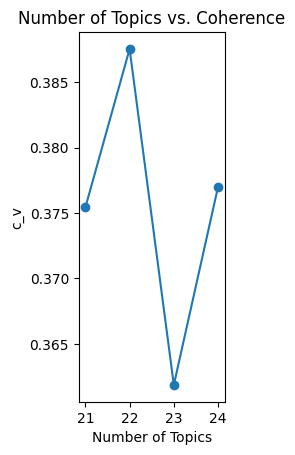

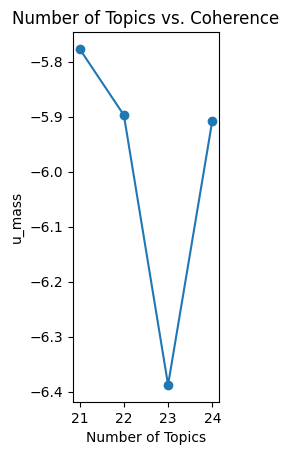

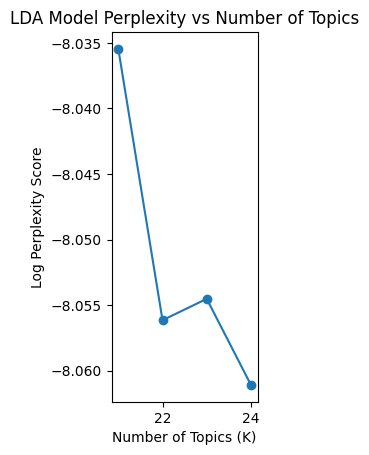

In [ ]:
reviews_w_ngrams = pd.DataFrame(amazon_df_sa_bj.cleaned_review.copy())
reviews_w_ngrams.cleaned_review = reviews_w_ngrams.cleaned_review.map(lambda x: replace_ngram(x) if isinstance(x, str) else x)

# tokenize reviews + remove stop words + remove names + remove words with less than 2 characters
reviews_w_ngrams = reviews_w_ngrams.cleaned_review.map(lambda x: [word for word in x.split() if word not in stop_words and len(word) > 2] if isinstance(x, str) else x)
reviews_w_ngrams.dropna(axis=0, inplace=True)
reviews_w_ngrams.isnull().sum()

final_reviews = reviews_w_ngrams
final_reviews.dropna(axis=0, inplace=True)

dictionary = corpora.Dictionary(final_reviews)
doc_term_matrix = [dictionary.doc2bow(doc) for doc in final_reviews]

coherence = []
umass = []
px = []
topic_range = range(21, 25)
for k in topic_range:
    print('Round: '+str(k))
    Lda = gensim.models.ldamodel.LdaModel
    ldamodel = Lda(doc_term_matrix, num_topics=k, id2word = dictionary, passes=40,\
                   iterations=200, chunksize = 10000, eval_every = None, random_state=0)
    
    cm = gensim.models.coherencemodel.CoherenceModel(model=ldamodel, texts=final_reviews,\
                                                     dictionary=dictionary, coherence='c_v')
    mm = gensim.models.coherencemodel.CoherenceModel(model=ldamodel, texts=final_reviews,\
                                                     dictionary=dictionary, coherence='u_mass')
    coherence.append((k,cm.get_coherence()))
    umass.append((k,mm.get_coherence()))
    px.append(ldamodel.log_perplexity(doc_term_matrix))
    
    
x_val = [x[0] for x in coherence]
y_val = [x[1] for x in coherence]

x_val_u = [x[0] for x in umass]
y_val_y = [x[1] for x in umass]

plt.subplot(1,3,1)
plt.plot(x_val,y_val)
plt.scatter(x_val,y_val)
plt.title('Number of Topics vs. Coherence')
plt.xlabel('Number of Topics')
plt.ylabel('c_v')
plt.xticks(x_val)
plt.show()

plt.subplot(1,3,2)
plt.plot(x_val_u,y_val_y)
plt.scatter(x_val_u,y_val_y)
plt.title('Number of Topics vs. Coherence')
plt.xlabel('Number of Topics')
plt.ylabel('u_mass')
plt.xticks(x_val_u)
plt.show()

plt.subplot(1,3,3)
plt.plot(topic_range, px, marker='o')
plt.xlabel("Number of Topics (K)")
plt.ylabel("Log Perplexity Score")
plt.title("LDA Model Perplexity vs Number of Topics")
plt.show()

In [ ]:
for i in topic_range:
    name = 'sa_bj'
    num = i
    Lda = gensim.models.ldamodel.LdaModel
    ldamodel = Lda(doc_term_matrix, num_topics=num, id2word = dictionary, passes=40,\
                iterations=200,  chunksize = 10000, eval_every = None, random_state=0)
    Lda2 = gensim.models.ldamodel.LdaModel
    ldamodel2 = Lda2(doc_term_matrix, num_topics=num, id2word = dictionary, passes=40,\
                iterations=200,  chunksize = 10000, eval_every = None, random_state=0)
    
    # To show initial topics
    ldamodel.show_topics(num, num_words=10, formatted=False)
    
    # To show initial topics
    ldamodel2.show_topics(num, num_words=10, formatted=False)
    
    # Visualize the topics
    pyLDAvis.enable_notebook()
    LDAvis_data_filepath = os.path.join('./results/ldavis_prepared_'+'v3_0129')
    
    # Create directory if it does not exist
    if not os.path.exists('./results'):
        os.makedirs('./results')
    LDAvis_prepared = pyLDAvis.gensim.prepare(ldamodel2, doc_term_matrix, dictionary, mds = 'pcoa')
    with open(LDAvis_data_filepath, 'wb') as f:
        pickle.dump(LDAvis_prepared, f)
        
    # load the pre-prepared pyLDAvis data from disk
    with open(LDAvis_data_filepath, 'rb') as f:
        LDAvis_prepared = pickle.load(f)
    pyLDAvis.save_html(LDAvis_prepared, './results/ldavis_prepared_'+ f'{name}_{num}' +'.html')
    display(LDAvis_prepared)
    
    topic_data = LDAvis_prepared
    all_topics = {}
    num_terms = 10  # Adjust number of words to represent each topic
    lambd = 0.6  # Adjust this accordingly based on tuning above
    for j in range(1, num + 1):  # Adjust this to reflect number of topics chosen for final LDA model
        topic = topic_data.topic_info[topic_data.topic_info.Category == 'Topic' + str(j)].copy()
        topic['relevance'] = topic['loglift'] * (1 - lambd) + topic['logprob'] * lambd
        # 리스트 길이 보정: max_length 만큼 패딩 (NaN 추가)
        terms = topic.sort_values(by='relevance', ascending=False).Term.tolist()
        all_topics['Topic ' + str(j)] = terms[:num_terms] + [None] * (num_terms - len(terms))
    lda2_test_results = pd.DataFrame.from_dict(all_topics, orient='index')
    display(lda2_test_results)

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
12    -0.020785 -0.041650       1        1  8.799647
6      0.043465 -0.058546       2        1  7.531188
15     0.016610 -0.080915       3        1  7.091505
20    -0.076123 -0.024401       4        1  6.410501
16    -0.095938  0.021152       5        1  6.286360
9      0.009092 -0.059438       6        1  6.263535
19    -0.132121  0.075344       7        1  6.184965
7     -0.049896 -0.020085       8        1  6.164945
8     -0.003334 -0.059068       9        1  4.961316
13    -0.040411 -0.040588      10        1  4.849916
17    -0.063993  0.064886      11        1  4.820940
18     0.045676 -0.035086      12        1  4.165388
1      0.047265 -0.033028      13        1  3.651325
2     -0.007501 -0.066808      14        1  3.411210
4      0.039417 -0.002790      15        1  3.341485
5      0.157378  0.084776      16        1  3.131518
11    -0.015088  0.147766      17        1  3.083978
0      0.099615 -0.012928      18        1  2.904144
3     -0.068509 -0.002660      19        1  2.748877
10     0.041653  0.088615      20        1  2.685928
14     0.073529  0.055452      21        1  1.511329, topic_info=                      Term        Freq       Total Category  logprob  loglift
1316                  soap   30.000000   30.000000  Default  30.0000  30.0000
37               recommend   87.000000   87.000000  Default  29.0000  29.0000
431              sunscreen   47.000000   47.000000  Default  28.0000  28.0000
1318                   bar   18.000000   18.000000  Default  27.0000  27.0000
73                   serum  153.000000  153.000000  Default  26.0000  26.0000
1745                  eyes   35.000000   35.000000  Default  25.0000  25.0000
22                    face  264.000000  264.000000  Default  24.0000  24.0000
15                   smell   64.000000   64.000000  Default  23.0000  23.0000
852                    oil   40.000000   40.000000  Default  22.0000  22.0000
227                 gentle   74.000000   74.000000  Default  21.0000  21.0000
109                    day   70.000000   70.000000  Default  20.0000  20.0000
42                     dry  108.000000  108.000000  Default  19.0000  19.0000
44                hydrated   75.000000   75.000000  Default  18.0000  18.0000
100            moisturizer   62.000000   62.000000  Default  17.0000  17.0000
1009                   gel   37.000000   37.000000  Default  16.0000  16.0000
454                  light   58.000000   58.000000  Default  15.0000  15.0000
218                   glow   89.000000   89.000000  Default  14.0000  14.0000
83            moisturizing   59.000000   59.000000  Default  13.0000  13.0000
535                  clean   54.000000   54.000000  Default  12.0000  12.0000
131                  toner   76.000000   76.000000  Default  11.0000  11.0000
7                 irritate   28.000000   28.000000  Default  10.0000  10.0000
780               cleanser   45.000000   45.000000  Default   9.0000   9.0000
45               hydrating   52.000000   52.000000  Default   8.0000   8.0000
775                 smells   36.000000   36.000000  Default   7.0000   7.0000
996                peeling   17.000000   17.000000  Default   6.0000   6.0000
673              excellent   17.000000   17.000000  Default   5.0000   5.0000
25                    soft  137.000000  137.000000  Default   4.0000   4.0000
10                  notice   21.000000   21.000000  Default   3.0000   3.0000
330                extract   23.000000   23.000000  Default   2.0000   2.0000
101                 smooth   83.000000   83.000000  Default   1.0000   1.0000
2882              peroxide    2.683591    3.429262   Topic1  -6.0897   2.1853
1495                  girl    2.683590    3.429262   Topic1  -6.0897   2.1853
1503                   lip    2.683589    3.429262   Topic1  -6.0897   2.1853
833              beginning    2.683489    3.429155   Topic1  -6.0898   2.1853
3101    

,0,1,2,3,4,5,6,7,8,9
Topic 1,serum,retinol,eye,face,oil,texture,routine,allergic,areas,longer
Topic 2,extract,serum,rice,leaf,pores,pinus,oily,glycol,face,water
Topic 3,dry,scent,pump,pore,sensitive,soft,half,red,bean,application
Topic 4,vitamin_c,face,greasy,serum,eyes,brighter,wonderful,sticky,months,packaged
Topic 5,smooth,takes,recommend,unscented,day,sensitive,glow,routine,clean,soft
Topic 6,moisturizing,face,several,recommend,soft,incredibly,tiktok,dry,awhile,price
Topic 7,peeling,gel,face,clean,exfoliating,exfoliation,gentle,apricot,scrubs,nicely
Topic 8,toner,gentle,dead,face,heavy,balanced,refreshed,smooth,effect,start
Topic 9,hydrated,serum,thank,ginseng,essence,spot,recommend,glow,daily,blackheads
Topic 10,smell,oily,sensitive,soft,serum,sticky,lovely,moisturizer,face,red


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
6      0.069696  0.037992       1        1  7.236653
12    -0.051676  0.063227       2        1  6.967356
20     0.005376  0.090918       3        1  6.232326
7      0.071699 -0.051808       4        1  6.228089
15     0.039559  0.005136       5        1  6.205307
19    -0.073510  0.057752       6        1  6.134030
16     0.055989  0.013098       7        1  6.000692
4     -0.007553  0.057829       8        1  4.761307
13     0.012947  0.020165       9        1  4.621756
8      0.116889 -0.091085      10        1  4.617936
17     0.025191  0.057519      11        1  4.610253
2      0.078508  0.044231      12        1  4.530364
3      0.001527  0.046693      13        1  3.922845
9      0.042641 -0.014210      14        1  3.877636
18     0.047750 -0.020326      15        1  3.541846
21    -0.021833 -0.071510      16        1  3.514538
0     -0.019816 -0.019752      17        1  3.321724
11    -0.068989  0.065035      18        1  3.175414
5     -0.066624 -0.118219      19        1  3.162967
10    -0.148708  0.002214      20        1  3.127903
1     -0.054728 -0.112617      21        1  2.117156
14    -0.054337 -0.062281      22        1  2.091900, topic_info=                           Term        Freq       Total Category  logprob  \
25                         soft  134.000000  134.000000  Default  30.0000   
852                         oil   39.000000   39.000000  Default  29.0000   
218                        glow   91.000000   91.000000  Default  28.0000   
83                 moisturizing   58.000000   58.000000  Default  27.0000   
22                         face  263.000000  263.000000  Default  26.0000   
1316                       soap   31.000000   31.000000  Default  25.0000   
450                  difference   35.000000   35.000000  Default  24.0000   
109                         day   70.000000   70.000000  Default  23.0000   
101                      smooth   80.000000   80.000000  Default  22.0000   
1318                        bar   19.000000   19.000000  Default  21.0000   
431                   sunscreen   48.000000   48.000000  Default  20.0000   
15                        smell   64.000000   64.000000  Default  19.0000   
775                      smells   36.000000   36.000000  Default  18.0000   
227                      gentle   74.000000   74.000000  Default  17.0000   
45                    hydrating   53.000000   53.000000  Default  16.0000   
1078                      white   26.000000   26.000000  Default  15.0000   
313                     absorbs   40.000000   40.000000  Default  14.0000   
984                        dead   27.000000   27.000000  Default  13.0000   
44                     hydrated   75.000000   75.000000  Default  12.0000   
14                         rice   35.000000   35.000000  Default  11.0000   
38                    sensitive  118.000000  118.000000  Default  10.0000   
131                       toner   76.000000   76.000000  Default   9.0000   
780                    cleanser   46.000000   46.000000  Default   8.0000   
783                      double   21.000000   21.000000  Default   7.0000   
90                        scent   77.000000   77.000000  Default   6.0000   
330                     extract   23.000000   23.000000  Default   5.0000   
70                      routine   62.000000   62.000000  Default   4.0000   
169                      pretty   29.000000   29.000000  Default   3.0000   
42                          dry  108.000000  108.000000  Default   2.0000   
37                    recommend   87.000000   87.000000  Default   1.0000   
2901                       hada    2.659147    3.413303   Topic1  -5.9033   
2902                       labo    2.659147    3.413303   Topic1  -5.9033   
2938                       wine    2.659146    3.413305   Topic1  -5.9033   
833                   beginning    2.658201    3.412747   Topic1  -

,0,1,2,3,4,5,6,7,8,9
Topic 1,serum,rice,loving,face,recently,glow,sensitive,itchy,months,oily
Topic 2,barrier,cleanser,retinol,zero,water,oil,lip,peroxide,girl,elegant
Topic 3,face,vitamin_c,eyes,serum,spf,moisturizer,find,centella,dark_spots,absorbs
Topic 4,hydrated,soft,toner,thank,heavy,play_video,greasy,exactly,moisturize,dry
Topic 5,moisturizing,dry,scent,soft,light,application,formulation,sensitive,masks,pretty
Topic 6,extract,face,leaf,pinus,glycol,exfoliation,apricot,suggest,oil,gel
Topic 7,difference,glow,serum,smooth,recommend,dewy,change,balm,routine,bumps
Topic 8,hydrating,scent,pine,moisturizer,body,cream,lotion,absorbed,incredibly,lightweight
Topic 9,smell,applying,texture,toners,soft,serum,smooth,toner,rice,daughter
Topic 10,white,sunscreen,glowy,recommend,everyday,repurchase,recommended,sunscreens,pimple,radiant


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
6      0.006072 -0.094429       1        1  6.431917
16    -0.076716 -0.017168       2        1  6.184578
20    -0.062015  0.009879       3        1  6.133125
15    -0.035665 -0.049958       4        1  6.067843
3     -0.047763  0.060614       5        1  5.873486
12    -0.016671  0.081313       6        1  5.742430
19     0.004160  0.119106       7        1  5.435780
22    -0.039882 -0.100159       8        1  5.278942
18     0.059951 -0.005344       9        1  5.131397
13    -0.051685 -0.036476      10        1  4.783771
9      0.027103 -0.072851      11        1  4.380987
17     0.009743  0.029784      12        1  4.276958
7     -0.057266 -0.050570      13        1  4.113727
10     0.019263  0.160418      14        1  3.846249
0     -0.032233 -0.038548      15        1  3.718421
5     -0.180971  0.020669      16        1  3.677343
1      0.050556 -0.062105      17        1  3.491244
4      0.045923 -0.003822      18        1  3.415148
8      0.158395 -0.057558      19        1  3.099354
11    -0.028762  0.017186      20        1  2.909846
21     0.080721  0.043966      21        1  2.852301
2      0.086707  0.021979      22        1  1.747859
14     0.081036  0.024074      23        1  1.407294, topic_info=                    Term        Freq       Total Category  logprob  loglift
101               smooth   80.000000   80.000000  Default  30.0000  30.0000
25                  soft  135.000000  135.000000  Default  29.0000  29.0000
44              hydrated   74.000000   74.000000  Default  28.0000  28.0000
15                 smell   63.000000   63.000000  Default  27.0000  27.0000
73                 serum  152.000000  152.000000  Default  26.0000  26.0000
852                  oil   40.000000   40.000000  Default  25.0000  25.0000
1745                eyes   33.000000   33.000000  Default  24.0000  24.0000
450           difference   35.000000   35.000000  Default  23.0000  23.0000
218                 glow   91.000000   91.000000  Default  22.0000  22.0000
42                   dry  108.000000  108.000000  Default  21.0000  21.0000
45             hydrating   52.000000   52.000000  Default  20.0000  20.0000
131                toner   77.000000   77.000000  Default  19.0000  19.0000
775               smells   36.000000   36.000000  Default  18.0000  18.0000
673            excellent   16.000000   16.000000  Default  17.0000  17.0000
454                light   58.000000   58.000000  Default  16.0000  16.0000
100          moisturizer   63.000000   63.000000  Default  15.0000  15.0000
83          moisturizing   57.000000   57.000000  Default  14.0000  14.0000
22                  face  264.000000  264.000000  Default  13.0000  13.0000
313              absorbs   40.000000   40.000000  Default  12.0000  12.0000
780             cleanser   46.000000   46.000000  Default  11.0000  11.0000
431            sunscreen   48.000000   48.000000  Default  10.0000  10.0000
109                  day   70.000000   70.000000  Default   9.0000   9.0000
1316                soap   32.000000   32.000000  Default   8.0000   8.0000
227               gentle   76.000000   76.000000  Default   7.0000   7.0000
14                  rice   36.000000   36.000000  Default   6.0000   6.0000
10                notice   22.000000   22.000000  Default   5.0000   5.0000
205                 oily   82.000000   82.000000  Default   4.0000   4.0000
23                 masks   31.000000   31.000000  Default   3.0000   3.0000
169               pretty   29.000000   29.000000  Default   2.0000   2.0000
535                clean   55.000000   55.000000  Default   1.0000   1.0000
1780           ricebased    1.756015    2.510745   Topic1  -6.2004   2.3864
1521           comedones    1.756012    2.510742   Topic1  -6.2004   2.3864
391           girlfriend    1.756013    2.510745   Topic1  -6.2004   2.3864
411           middleaged    1.756013    2.510745

,0,1,2,3,4,5,6,7,8,9
Topic 1,serum,oily,run,long,glow,pores,moisturizer,heavy,moisturizers,tiny
Topic 2,glow,rice,routine,smooth,provides,natural,play_video,face,balm,wine
Topic 3,face,vitamin_c,wonderful,three,serum,night,eye_cream,foundation,noticeable,unstable
Topic 4,dry,sensitive,moisturizing,scent,formulation,patches,pretty,easy,weekly,cream
Topic 5,gentle,recommend,enough,gel,effective,face,mascara,spf,retinol,waterproof
Topic 6,expensive,oil,toner,serum,face,loving,cleanser,lightweight,routine,eye
Topic 7,extract,cream,leaf,face,pinus,remover,glycol,eye,consistent,youll
Topic 8,serums,application,soap,day,greasy,kit,lathers,particularly,scent,hydrated
Topic 9,sunscreen,cleansing_balm,fragrance,face,start,cool,effect,brighten,bottle,double
Topic 10,glowy,serum,hydrate,irritate,calming,soothing,sensitive,sticky,extract,reduce


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
15     0.050915 -0.022578       1        1  6.958400
6      0.096279  0.031341       2        1  6.842883
20     0.059227 -0.043827       3        1  5.800843
13     0.075961  0.053180       4        1  5.783996
16     0.057941 -0.043099       5        1  5.371693
23    -0.040137 -0.174289       6        1  5.307185
8      0.055317  0.093868       7        1  4.944155
9      0.072185  0.055749       8        1  4.800094
17    -0.014132 -0.079484       9        1  4.795170
12    -0.007292  0.018601      10        1  4.661941
19    -0.015576  0.078107      11        1  4.582031
22     0.066038  0.016804      12        1  4.430939
18    -0.052976 -0.033655      13        1  4.169629
3      0.038660 -0.028006      14        1  4.044309
7      0.084544 -0.025467      15        1  3.988572
0      0.025039 -0.059272      16        1  3.532931
11    -0.002467 -0.047457      17        1  3.496129
21    -0.020269  0.029549      18        1  2.894030
1      0.007460  0.062297      19        1  2.730164
4     -0.072946 -0.011870      20        1  2.481140
2     -0.102118  0.105890      21        1  2.412028
14    -0.108956 -0.050736      22        1  2.293821
5     -0.078521  0.025264      23        1  1.947152
10    -0.174177  0.049089      24        1  1.730765, topic_info=                           Term        Freq       Total Category  logprob  \
44                     hydrated   73.000000   73.000000  Default  30.0000   
73                        serum  155.000000  155.000000  Default  29.0000   
1316                       soap   32.000000   32.000000  Default  28.0000   
218                        glow   89.000000   89.000000  Default  27.0000   
22                         face  265.000000  265.000000  Default  26.0000   
42                          dry  107.000000  107.000000  Default  25.0000   
852                         oil   39.000000   39.000000  Default  24.0000   
101                      smooth   83.000000   83.000000  Default  23.0000   
431                   sunscreen   48.000000   48.000000  Default  22.0000   
83                 moisturizing   58.000000   58.000000  Default  21.0000   
25                         soft  137.000000  137.000000  Default  20.0000   
673                   excellent   16.000000   16.000000  Default  19.0000   
227                      gentle   75.000000   75.000000  Default  18.0000   
37                    recommend   87.000000   87.000000  Default  17.0000   
535                       clean   55.000000   55.000000  Default  16.0000   
38                    sensitive  120.000000  120.000000  Default  15.0000   
15                        smell   64.000000   64.000000  Default  14.0000   
330                     extract   22.000000   22.000000  Default  13.0000   
775                      smells   36.000000   36.000000  Default  12.0000   
450                  difference   35.000000   35.000000  Default  11.0000   
169                      pretty   30.000000   30.000000  Default  10.0000   
70                      routine   62.000000   62.000000  Default   9.0000   
996                     peeling   17.000000   17.000000  Default   8.0000   
131                       toner   77.000000   77.000000  Default   7.0000   
1318                        bar   19.000000   19.000000  Default   6.0000   
313                     absorbs   41.000000   41.000000  Default   5.0000   
432                     texture   56.000000   56.000000  Default   4.0000   
1009                        gel   37.000000   37.000000  Default   3.0000   
205                        oily   81.000000   81.000000  Default   2.0000   
90                        scent   76.000000   76.000000  Default   1.0000   
951                 formulation    4.334719    5.876558   Topic1  -5.3755   
1026              inconvenience    1.755286    2.511568   Topic1  -6.2795   
254                individually    1.7

,0,1,2,3,4,5,6,7,8,9
Topic 1,dry,sensitive,soft,formulation,scent,helped,gentle,effective,smooth,pump
Topic 2,serum,soothing,calm,rice,face,help,soothed,clear,itchy,hada
Topic 3,face,vitamin_c,night,serum,fine,evening,recommend,applying,percentage,unstable
Topic 4,serum,smell,glowy,sensitive,toner,essence,sticky,mean,soft,plump
Topic 5,smooth,glow,day,difference,balm,face,rice,recommend,routine,toner
Topic 6,peeling,gentle,clean,gel,exfoliating,exfoliation,dead,face,smooth,exfoliator
Topic 7,bottles,bottle,bigger,smaller,serums,small,size,thank,ginseng,pores
Topic 8,hope,months,eye,moisturizers,color,improved,long,light_weight,moisturizer,moisturizing
Topic 9,face,masks,eyes,removes,spectacular,within,cleanser,cells,consistently,applied
Topic 10,oil,eye,lip,girl,peroxide,barrier,benzoyl,terrible,redness,cleansing_oil


###### I'm from

Round: 21
Round: 22
Round: 23
Round: 24


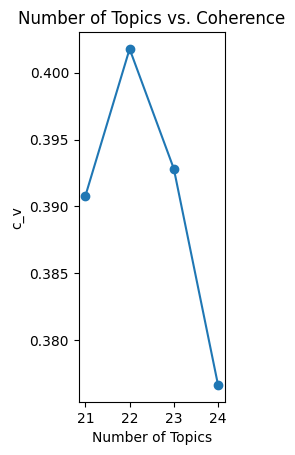

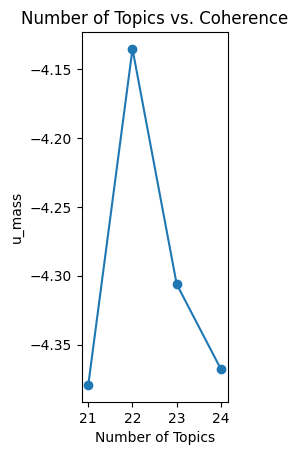

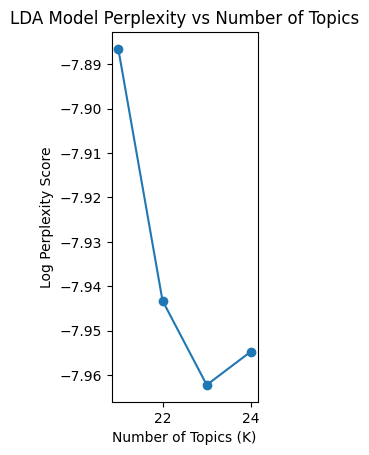

In [ ]:
reviews_w_ngrams = pd.DataFrame(amazon_df_sa_if.cleaned_review.copy())
reviews_w_ngrams.cleaned_review = reviews_w_ngrams.cleaned_review.map(lambda x: replace_ngram(x) if isinstance(x, str) else x)

# tokenize reviews + remove stop words + remove names + remove words with less than 2 characters
reviews_w_ngrams = reviews_w_ngrams.cleaned_review.map(lambda x: [word for word in x.split() if word not in stop_words and len(word) > 2] if isinstance(x, str) else x)
reviews_w_ngrams.dropna(axis=0, inplace=True)
reviews_w_ngrams.isnull().sum()

final_reviews = reviews_w_ngrams
final_reviews.dropna(axis=0, inplace=True)

dictionary = corpora.Dictionary(final_reviews)
doc_term_matrix = [dictionary.doc2bow(doc) for doc in final_reviews]

coherence = []
umass = []
px = []
topic_range = range(21, 25)
for k in topic_range:
    print('Round: '+str(k))
    Lda = gensim.models.ldamodel.LdaModel
    ldamodel = Lda(doc_term_matrix, num_topics=k, id2word = dictionary, passes=40,\
                   iterations=200, chunksize = 10000, eval_every = None, random_state=0)
    
    cm = gensim.models.coherencemodel.CoherenceModel(model=ldamodel, texts=final_reviews,\
                                                     dictionary=dictionary, coherence='c_v')
    mm = gensim.models.coherencemodel.CoherenceModel(model=ldamodel, texts=final_reviews,\
                                                     dictionary=dictionary, coherence='u_mass')
    coherence.append((k,cm.get_coherence()))
    umass.append((k,mm.get_coherence()))
    px.append(ldamodel.log_perplexity(doc_term_matrix))
    
    
x_val = [x[0] for x in coherence]
y_val = [x[1] for x in coherence]

x_val_u = [x[0] for x in umass]
y_val_y = [x[1] for x in umass]

plt.subplot(1,3,1)
plt.plot(x_val,y_val)
plt.scatter(x_val,y_val)
plt.title('Number of Topics vs. Coherence')
plt.xlabel('Number of Topics')
plt.ylabel('c_v')
plt.xticks(x_val)
plt.show()

plt.subplot(1,3,2)
plt.plot(x_val_u,y_val_y)
plt.scatter(x_val_u,y_val_y)
plt.title('Number of Topics vs. Coherence')
plt.xlabel('Number of Topics')
plt.ylabel('u_mass')
plt.xticks(x_val_u)
plt.show()

plt.subplot(1,3,3)
plt.plot(topic_range, px, marker='o')
plt.xlabel("Number of Topics (K)")
plt.ylabel("Log Perplexity Score")
plt.title("LDA Model Perplexity vs Number of Topics")
plt.show()

In [ ]:
for i in topic_range:
    name = 'sa_if'
    num = i
    Lda = gensim.models.ldamodel.LdaModel
    ldamodel = Lda(doc_term_matrix, num_topics=num, id2word = dictionary, passes=40,\
                iterations=200,  chunksize = 10000, eval_every = None, random_state=0)
    Lda2 = gensim.models.ldamodel.LdaModel
    ldamodel2 = Lda2(doc_term_matrix, num_topics=num, id2word = dictionary, passes=40,\
                iterations=200,  chunksize = 10000, eval_every = None, random_state=0)
    
    # To show initial topics
    ldamodel.show_topics(num, num_words=10, formatted=False)
    
    # To show initial topics
    ldamodel2.show_topics(num, num_words=10, formatted=False)
    
    # Visualize the topics
    pyLDAvis.enable_notebook()
    LDAvis_data_filepath = os.path.join('./results/ldavis_prepared_'+'v3_0129')
    
    # Create directory if it does not exist
    if not os.path.exists('./results'):
        os.makedirs('./results')
    LDAvis_prepared = pyLDAvis.gensim.prepare(ldamodel2, doc_term_matrix, dictionary, mds = 'pcoa')
    with open(LDAvis_data_filepath, 'wb') as f:
        pickle.dump(LDAvis_prepared, f)
        
    # load the pre-prepared pyLDAvis data from disk
    with open(LDAvis_data_filepath, 'rb') as f:
        LDAvis_prepared = pickle.load(f)
    pyLDAvis.save_html(LDAvis_prepared, './results/ldavis_prepared_'+ f'{name}_{num}' +'.html')
    display(LDAvis_prepared)
    
    topic_data = LDAvis_prepared
    all_topics = {}
    num_terms = 10  # Adjust number of words to represent each topic
    lambd = 0.6  # Adjust this accordingly based on tuning above
    for j in range(1, num + 1):  # Adjust this to reflect number of topics chosen for final LDA model
        topic = topic_data.topic_info[topic_data.topic_info.Category == 'Topic' + str(j)].copy()
        topic['relevance'] = topic['loglift'] * (1 - lambd) + topic['logprob'] * lambd
        # 리스트 길이 보정: max_length 만큼 패딩 (NaN 추가)
        terms = topic.sort_values(by='relevance', ascending=False).Term.tolist()
        all_topics['Topic ' + str(j)] = terms[:num_terms] + [None] * (num_terms - len(terms))
    lda2_test_results = pd.DataFrame.from_dict(all_topics, orient='index')
    display(lda2_test_results)

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
11    -0.173019  0.003589       1        1  13.848846
5     -0.062903  0.030519       2        1   9.895800
12    -0.161735  0.005709       3        1   7.233549
16    -0.015981 -0.137808       4        1   7.071565
15     0.004335  0.033196       5        1   5.213728
6     -0.015765  0.104530       6        1   5.035504
3      0.014164 -0.179129       7        1   4.661963
9     -0.027361  0.009909       8        1   4.335298
18     0.028196 -0.021011       9        1   4.281140
13     0.058219  0.103005      10        1   4.194123
2      0.067379 -0.037539      11        1   4.026220
17    -0.029509  0.021569      12        1   3.866229
4      0.000104  0.067592      13        1   3.734014
20    -0.064982 -0.012222      14        1   3.371179
7      0.080221 -0.017267      15        1   3.228708
1      0.121102  0.020348      16        1   3.068298
14     0.045671  0.026682      17        1   3.028112
10     0.036023  0.072244      18        1   2.993612
0      0.032980 -0.029094      19        1   2.542736
19    -0.010672 -0.039906      20        1   2.262414
8      0.073535 -0.024915      21        1   2.106963, topic_info=                      Term        Freq       Total Category  logprob  loglift
525               cleanser  181.000000  181.000000  Default  30.0000  30.0000
2690                  pads  120.000000  120.000000  Default  29.0000  29.0000
657                  serum  165.000000  165.000000  Default  28.0000  28.0000
317                  toner  206.000000  206.000000  Default  27.0000  27.0000
5                    honey   58.000000   58.000000  Default  26.0000  26.0000
322                  cream  173.000000  173.000000  Default  25.0000  25.0000
2689                   pad   36.000000   36.000000  Default  24.0000  24.0000
73                    soft  167.000000  167.000000  Default  23.0000  23.0000
358                    day   88.000000   88.000000  Default  22.0000  22.0000
3                     face  408.000000  408.000000  Default  21.0000  21.0000
29                   smell  107.000000  107.000000  Default  20.0000  20.0000
222                  night   72.000000   72.000000  Default  19.0000  19.0000
1104               extract   70.000000   70.000000  Default  18.0000  18.0000
12                 routine   79.000000   79.000000  Default  17.0000  17.0000
43                  smooth  118.000000  118.000000  Default  16.0000  16.0000
1014                  rice  114.000000  114.000000  Default  15.0000  15.0000
955                essence   54.000000   54.000000  Default  14.0000  14.0000
299            moisturizer  142.000000  142.000000  Default  13.0000  13.0000
25               sensitive  194.000000  194.000000  Default  12.0000  12.0000
696             difference   33.000000   33.000000  Default  11.0000  11.0000
62                  sticky   68.000000   68.000000  Default  10.0000  10.0000
481             irritation   53.000000   53.000000  Default   9.0000   9.0000
30                  smells   69.000000   69.000000  Default   8.0000   8.0000
706              excellent   26.000000   26.000000  Default   7.0000   7.0000
223                redness   85.000000   85.000000  Default   6.0000   6.0000
63                 texture   94.000000   94.000000  Default   5.0000   5.0000
6                 hydrated  103.000000  103.000000  Default   4.0000   4.0000
57            moisturizing  105.000000  105.000000  Default   3.0000   3.0000
86                soothing   80.000000   80.000000  Default   2.0000   2.0000
39                    oily   86.000000   86.000000  Default   1.0000   1.0000
525               cleanser  177.350952  181.078905   Topic1  -2.7915   1.9562
3135                lather   28.448419   29.238298   Topic1  -4.6216   1.9496
3596                  foam   22.039837   22.821067   Topic1  -4.8768   1.9421
3599                  whip   22.006508   23.590594   Topic1  -4

,0,1,2,3,4,5,6,7,8,9
Topic 1,cleanser,rice,scent,lather,clean,face_wash,gentle,lathers,creamy,foam
Topic 2,face,soft,absorbs,greasy,price,scent,serum,moisturizer,sticky,light
Topic 3,pads,toner,pad,container,tweezers,beet,face,pick,sensitive,convenient
Topic 4,extract,root,ampoule,toner,bottle,beet,curcuma,longa,turmeric,squalane
Topic 5,cream,ginseng,gets,face,serum,mugwort,daughter,shower,selling,consistency
Topic 6,face,soft,moisturized,fresh,serum,redness,helped,warms,warm,incredible
Topic 7,cream,cetearyl,alcohol,olivate,nails,copolymer,combination,hydrolyzed,collagen,hydrating
Topic 8,face,oily,intense,cream,okay,something,curology,weird,age,necessary
Topic 9,normal,exfoliation,cream,nose,seal,helpful,soaks,travel,find,heat
Topic 10,serum,gives,moisturizing,smell,lightweight,satisfied,hydrated,glow,dropper,sticky


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
11    -0.090016  0.067329       1        1  10.108664
5      0.023254  0.041819       2        1   8.856624
12    -0.120130  0.064557       3        1   7.222278
16    -0.115517 -0.130920       4        1   5.887693
15     0.061503  0.028979       5        1   5.469309
17    -0.071503  0.039338       6        1   5.382142
3     -0.028123 -0.168065       7        1   5.029473
18     0.017817  0.056808       8        1   4.951224
4     -0.054486 -0.039149       9        1   4.522956
20    -0.101214  0.053168      10        1   4.432109
6      0.061314  0.050999      11        1   4.252429
7      0.095965 -0.015133      12        1   4.080404
9      0.050652  0.036161      13        1   3.846892
13     0.018155 -0.125898      14        1   3.802558
14     0.027069  0.010892      15        1   3.507776
21     0.056954 -0.002432      16        1   3.255250
19    -0.106233  0.046528      17        1   3.217967
10     0.046127  0.028417      18        1   2.966945
2      0.041076 -0.033540      19        1   2.704110
8      0.068602  0.014937      20        1   2.543433
1      0.032983 -0.018845      21        1   1.999116
0      0.085749 -0.005952      22        1   1.960650, topic_info=                                          Term        Freq       Total  \
2690                                      pads  121.000000  121.000000   
525                                   cleanser  169.000000  169.000000   
317                                      toner  205.000000  205.000000   
73                                        soft  165.000000  165.000000   
72                                   hydrating   73.000000   73.000000   
657                                      serum  164.000000  164.000000   
1014                                      rice  111.000000  111.000000   
3                                         face  405.000000  405.000000   
2689                                       pad   36.000000   36.000000   
322                                      cream  176.000000  176.000000   
299                                moisturizer  144.000000  144.000000   
1104                                   extract   69.000000   69.000000   
5                                        honey   58.000000   58.000000   
6                                     hydrated  102.000000  102.000000   
222                                      night   73.000000   73.000000   
156                                     gentle   85.000000   85.000000   
140                                     winter   43.000000   43.000000   
223                                    redness   86.000000   86.000000   
358                                        day   88.000000   88.000000   
955                                    essence   55.000000   55.000000   
706                                  excellent   27.000000   27.000000   
29                                       smell  110.000000  110.000000   
39                                        oily   87.000000   87.000000   
97                                 moisturized   43.000000   43.000000   
57                                moisturizing  106.000000  106.000000   
127                                recommended   29.000000   29.000000   
1468                                 container   31.000000   31.000000   
696                                 difference   34.000000   34.000000   
16                                       helps   51.000000   51.000000   
30                                      smells   69.000000   69.000000   
3641                                       150    3.494241    4.440263   
623                                        pea    6.274806    7.987218   
3811                                      text    2.767347    3.547224   
1412                                 negatives    2.767285    3.547155   
952                                   positive    2.767235    3.547105 

,0,1,2,3,4,5,6,7,8,9
Topic 1,cleanser,scent,sensitive,face,clean,rich,lather,oily,irritation,rice
Topic 2,face,soft,moisturizer,cream,smooth,absorbs,scent,dry,oily,greasy
Topic 3,pads,toner,pad,container,tweezers,convenient,neck,beet,lid,pick
Topic 4,extract,toner,beet,root,ampoule,soap,curcuma,longa,moisturizer,squalane
Topic 5,cream,serum,days,dry,light_weight,face,shower,consistency,mugwort,wish
Topic 6,sunscreen,pretty,white,cleanser,rice,dry,face,thank,scent,plumped
Topic 7,alcohol,cetearyl,nails,sensitive,mushroom,moist,olivate,cream,tremella,diisostearyl
Topic 8,cream,routine,bottle,night,purchasing,mins,longer,nighttime,usage,happen
Topic 9,essence,properties,uses,completely,ewg,licorice,brightening,scentless,seemed,moisture
Topic 10,cleanser,rice,regular,smooth,creamy,foams,whip,nicely,complexion,daughter


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
11     0.167542 -0.052285       1        1  11.883719
12     0.041251 -0.093378       2        1   8.552251
5      0.045066  0.031348       3        1   7.030466
16    -0.000612 -0.115308       4        1   5.676673
15    -0.024061  0.044742       5        1   4.702608
17     0.188988 -0.012540       6        1   4.653866
22    -0.037962  0.006901       7        1   4.572281
7     -0.144427 -0.118910       8        1   4.511448
3     -0.056083 -0.060739       9        1   4.131215
4     -0.010375 -0.034093      10        1   4.085746
18    -0.071178 -0.044727      11        1   4.005327
2      0.005291  0.023347      12        1   3.750741
6     -0.037187  0.062321      13        1   3.688977
9     -0.058880  0.036581      14        1   3.418853
8     -0.088751  0.014645      15        1   3.379913
21    -0.006181  0.127098      16        1   3.258624
10     0.062023 -0.036723      17        1   2.948907
20     0.015431 -0.011604      18        1   2.885100
19     0.018863  0.037238      19        1   2.865530
0     -0.008951  0.111895      20        1   2.706132
1      0.014581  0.002032      21        1   2.511282
13     0.007950  0.056594      22        1   2.487219
14    -0.022338  0.025564      23        1   2.293121, topic_info=                                          Term        Freq       Total  \
525                                   cleanser  178.000000  178.000000   
2690                                      pads  123.000000  123.000000   
317                                      toner  207.000000  207.000000   
3                                         face  403.000000  403.000000   
322                                      cream  173.000000  173.000000   
73                                        soft  166.000000  166.000000   
657                                      serum  164.000000  164.000000   
223                                    redness   85.000000   85.000000   
1438                                 sunscreen   43.000000   43.000000   
696                                 difference   34.000000   34.000000   
71                                        glow   51.000000   51.000000   
29                                       smell  108.000000  108.000000   
2689                                       pad   36.000000   36.000000   
1014                                      rice  112.000000  112.000000   
5                                        honey   59.000000   59.000000   
30                                      smells   70.000000   70.000000   
1104                                   extract   69.000000   69.000000   
955                                    essence   55.000000   55.000000   
72                                   hydrating   73.000000   73.000000   
299                                moisturizer  143.000000  143.000000   
6                                     hydrated  103.000000  103.000000   
706                                  excellent   26.000000   26.000000   
1711                                  licorice   41.000000   41.000000   
294                                     greasy   47.000000   47.000000   
257                                      clean   88.000000   88.000000   
35                                         dry  210.000000  210.000000   
156                                     gentle   88.000000   88.000000   
70                                       gives   32.000000   32.000000   
443                                       size   52.000000   52.000000   
98                                   recommend  123.000000  123.000000   
3596                                      foam   20.329710   22.750460   
3612                                     foams   10.561556   11.838009   
3592                                   lathers   22.915119   26.408182   
525                                   cleanser  151.554752  178.933484   
2778             

,0,1,2,3,4,5,6,7,8,9
Topic 1,cleanser,scent,clean,gentle,rice,face_wash,lathers,creamy,sensitive,foam
Topic 2,pads,toner,pad,container,tweezers,licorice,sensitive,cleaning,face,convenient
Topic 3,face,soft,moisturized,serum,glow,dry,cream,recommend,price,scent
Topic 4,extract,toner,longa,curcuma,turmeric,moisturizer,leaf,azadirachta,soap,ampoule
Topic 5,cream,serum,face,thicker,consistency,light_weight,rice_toner,shower,daughter,comparable
Topic 6,sunscreen,pretty,white,fig,face,rice,dry,oily,removing,floral
Topic 7,essence,mugwort,cream,selling,change,evening,beware,help,face,moisturizer
Topic 8,licorice,winter,ampoule,root,squalane,moisturizer,pores,crosspolymer,helps,beet
Topic 9,alcohol,cetearyl,nails,olivate,fuciformis,snail_mucin,tremella,olefin,corn,tetraethylhexanoate
Topic 10,smell,greasy,scrub,depending,moisture,enough,absorbs,wipes,moisturizer,moist


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
11    -0.174033 -0.138211       1        1  13.075254
12    -0.013936 -0.134773       2        1   7.330258
16     0.131332 -0.075832       3        1   6.984304
5     -0.046723 -0.048195       4        1   6.896436
3      0.110348 -0.044536       5        1   4.866581
15    -0.016303 -0.059910       6        1   4.588796
21    -0.071535  0.041216       7        1   4.236238
18     0.014139 -0.027979       8        1   4.135682
23     0.031970 -0.049965       9        1   4.082041
14     0.028518  0.007313      10        1   3.958505
6     -0.024184  0.039474      11        1   3.683676
9      0.009616 -0.042333      12        1   3.647448
4      0.018304  0.044316      13        1   3.524493
22    -0.020482  0.015902      14        1   3.393589
13     0.000468  0.026862      15        1   3.134496
7      0.145366  0.018054      16        1   2.876965
20    -0.013355  0.013517      17        1   2.810961
2      0.035954  0.037470      18        1   2.713309
8     -0.009129  0.044137      19        1   2.570454
17    -0.083132  0.037722      20        1   2.450274
1      0.036579  0.039073      21        1   2.414358
10    -0.080096  0.101291      22        1   2.412248
0     -0.018163  0.134226      23        1   2.223056
19     0.008477  0.021164      24        1   1.990577, topic_info=                      Term        Freq       Total Category  logprob  loglift
525               cleanser  181.000000  181.000000  Default  30.0000  30.0000
2690                  pads  122.000000  122.000000  Default  29.0000  29.0000
657                  serum  163.000000  163.000000  Default  28.0000  28.0000
317                  toner  207.000000  207.000000  Default  27.0000  27.0000
3                     face  403.000000  403.000000  Default  26.0000  26.0000
73                    soft  165.000000  165.000000  Default  25.0000  25.0000
322                  cream  175.000000  175.000000  Default  24.0000  24.0000
223                redness   84.000000   84.000000  Default  23.0000  23.0000
5                    honey   58.000000   58.000000  Default  22.0000  22.0000
2689                   pad   36.000000   36.000000  Default  21.0000  21.0000
57            moisturizing  105.000000  105.000000  Default  20.0000  20.0000
43                  smooth  118.000000  118.000000  Default  19.0000  19.0000
1014                  rice  114.000000  114.000000  Default  18.0000  18.0000
1104               extract   70.000000   70.000000  Default  17.0000  17.0000
25               sensitive  194.000000  194.000000  Default  16.0000  16.0000
696             difference   33.000000   33.000000  Default  15.0000  15.0000
29                   smell  109.000000  109.000000  Default  14.0000  14.0000
6                 hydrated  103.000000  103.000000  Default  13.0000  13.0000
35                     dry  210.000000  210.000000  Default  12.0000  12.0000
156                 gentle   87.000000   87.000000  Default  11.0000  11.0000
72               hydrating   75.000000   75.000000  Default  10.0000  10.0000
128                  scent  195.000000  195.000000  Default   9.0000   9.0000
493                 helped   29.000000   29.000000  Default   8.0000   8.0000
706              excellent   27.000000   27.000000  Default   7.0000   7.0000
62                  sticky   67.000000   67.000000  Default   6.0000   6.0000
955                essence   54.000000   54.000000  Default   5.0000   5.0000
71                    glow   51.000000   51.000000  Default   4.0000   4.0000
581                    gel   53.000000   53.000000  Default   3.0000   3.0000
211                  heavy   52.000000   52.000000  Default   2.0000   2.0000
157                   long   64.000000   64.000000  Default   1.0000   1.0000
3135                lather   28.491488   29.277036   Topic1  -4.5626   2.0073
525               cleanser  175.730310  181.043609   Topi

,0,1,2,3,4,5,6,7,8,9
Topic 1,cleanser,rice,scent,clean,lather,creamy,gentle,face_wash,lathers,foam
Topic 2,pads,toner,pad,container,tweezers,licorice,beet,convenient,lid,pick
Topic 3,extract,moisturizer,ampoule,absorbs,beet,root,greasy,energy,bottle,curcuma
Topic 4,face,scent,soft,refreshing,cream,moisturized,moisturizer,beautiful,mugwort,serum
Topic 5,cream,alcohol,cetearyl,fast,sensitive,mushroom,dry,essential,recommend,olivate
Topic 6,cream,healthy,dry,gel,thicker,hydrate,mugwort,consistency,negative,ease
Topic 7,serum,excellent,smooth,moisturizing,face,heavy,sticky,hydrating,shower,price
Topic 8,size,cream,prep,recently,calming,usage,softens,toner,hydrating,keeps
Topic 9,essence,repair,dryness,acne,visibly,calms,bottle,purchasing,impressed,absorbs
Topic 10,applied,pill,slight,strongly,day,angry,rough,foundation,smell,hate


###### PURITO

Round: 21
Round: 22
Round: 23
Round: 24


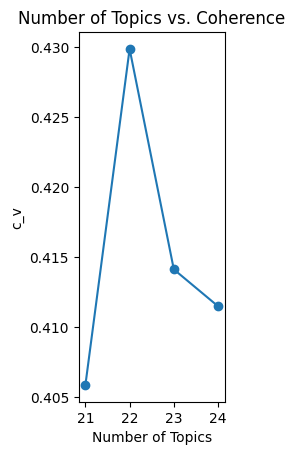

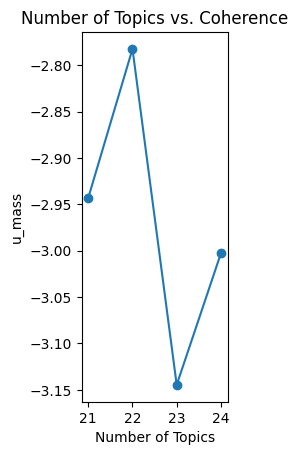

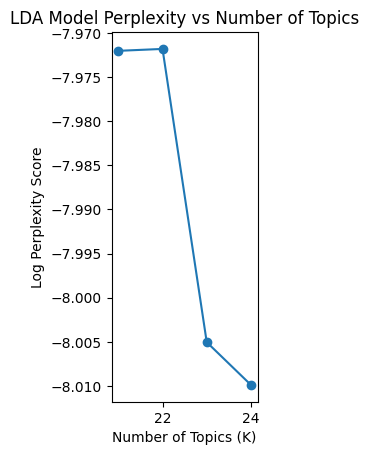

In [ ]:
reviews_w_ngrams = pd.DataFrame(amazon_df_sa_pu.cleaned_review.copy())
reviews_w_ngrams.cleaned_review = reviews_w_ngrams.cleaned_review.map(lambda x: replace_ngram(x) if isinstance(x, str) else x)

# tokenize reviews + remove stop words + remove names + remove words with less than 2 characters
reviews_w_ngrams = reviews_w_ngrams.cleaned_review.map(lambda x: [word for word in x.split() if word not in stop_words and len(word) > 2] if isinstance(x, str) else x)
reviews_w_ngrams.dropna(axis=0, inplace=True)
reviews_w_ngrams.isnull().sum()

final_reviews = reviews_w_ngrams
final_reviews.dropna(axis=0, inplace=True)

dictionary = corpora.Dictionary(final_reviews)
doc_term_matrix = [dictionary.doc2bow(doc) for doc in final_reviews]

coherence = []
umass = []
px = []
topic_range = range(21, 25)
for k in topic_range:
    print('Round: '+str(k))
    Lda = gensim.models.ldamodel.LdaModel
    ldamodel = Lda(doc_term_matrix, num_topics=k, id2word = dictionary, passes=40,\
                   iterations=200, chunksize = 10000, eval_every = None, random_state=0)
    
    cm = gensim.models.coherencemodel.CoherenceModel(model=ldamodel, texts=final_reviews,\
                                                     dictionary=dictionary, coherence='c_v')
    mm = gensim.models.coherencemodel.CoherenceModel(model=ldamodel, texts=final_reviews,\
                                                     dictionary=dictionary, coherence='u_mass')
    coherence.append((k,cm.get_coherence()))
    umass.append((k,mm.get_coherence()))
    px.append(ldamodel.log_perplexity(doc_term_matrix))
    
    
x_val = [x[0] for x in coherence]
y_val = [x[1] for x in coherence]

x_val_u = [x[0] for x in umass]
y_val_y = [x[1] for x in umass]

plt.subplot(1,3,1)
plt.plot(x_val,y_val)
plt.scatter(x_val,y_val)
plt.title('Number of Topics vs. Coherence')
plt.xlabel('Number of Topics')
plt.ylabel('c_v')
plt.xticks(x_val)
plt.show()

plt.subplot(1,3,2)
plt.plot(x_val_u,y_val_y)
plt.scatter(x_val_u,y_val_y)
plt.title('Number of Topics vs. Coherence')
plt.xlabel('Number of Topics')
plt.ylabel('u_mass')
plt.xticks(x_val_u)
plt.show()

plt.subplot(1,3,3)
plt.plot(topic_range, px, marker='o')
plt.xlabel("Number of Topics (K)")
plt.ylabel("Log Perplexity Score")
plt.title("LDA Model Perplexity vs Number of Topics")
plt.show()

In [ ]:
for i in topic_range:
    name = 'sa_pu'
    num = i
    Lda = gensim.models.ldamodel.LdaModel
    ldamodel = Lda(doc_term_matrix, num_topics=num, id2word = dictionary, passes=40,\
                iterations=200,  chunksize = 10000, eval_every = None, random_state=0)
    Lda2 = gensim.models.ldamodel.LdaModel
    ldamodel2 = Lda2(doc_term_matrix, num_topics=num, id2word = dictionary, passes=40,\
                iterations=200,  chunksize = 10000, eval_every = None, random_state=0)
    
    # To show initial topics
    ldamodel.show_topics(num, num_words=10, formatted=False)
    
    # To show initial topics
    ldamodel2.show_topics(num, num_words=10, formatted=False)
    
    # Visualize the topics
    pyLDAvis.enable_notebook()
    LDAvis_data_filepath = os.path.join('./results/ldavis_prepared_'+'v3_0129')
    
    # Create directory if it does not exist
    if not os.path.exists('./results'):
        os.makedirs('./results')
    LDAvis_prepared = pyLDAvis.gensim.prepare(ldamodel2, doc_term_matrix, dictionary, mds = 'pcoa')
    with open(LDAvis_data_filepath, 'wb') as f:
        pickle.dump(LDAvis_prepared, f)
        
    # load the pre-prepared pyLDAvis data from disk
    with open(LDAvis_data_filepath, 'rb') as f:
        LDAvis_prepared = pickle.load(f)
    pyLDAvis.save_html(LDAvis_prepared, './results/ldavis_prepared_'+ f'{name}_{num}' +'.html')
    display(LDAvis_prepared)
    
    topic_data = LDAvis_prepared
    all_topics = {}
    num_terms = 10  # Adjust number of words to represent each topic
    lambd = 0.6  # Adjust this accordingly based on tuning above
    for j in range(1, num + 1):  # Adjust this to reflect number of topics chosen for final LDA model
        topic = topic_data.topic_info[topic_data.topic_info.Category == 'Topic' + str(j)].copy()
        topic['relevance'] = topic['loglift'] * (1 - lambd) + topic['logprob'] * lambd
        # 리스트 길이 보정: max_length 만큼 패딩 (NaN 추가)
        terms = topic.sort_values(by='relevance', ascending=False).Term.tolist()
        all_topics['Topic ' + str(j)] = terms[:num_terms] + [None] * (num_terms - len(terms))
    lda2_test_results = pd.DataFrame.from_dict(all_topics, orient='index')
    display(lda2_test_results)

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
0     -0.014712  0.219028       1        1  9.112507
17    -0.099745 -0.066610       2        1  7.493725
16     0.240808 -0.005434       3        1  7.347395
20    -0.056798 -0.026043       4        1  6.161816
10    -0.044032 -0.023395       5        1  6.149725
12    -0.106902 -0.021372       6        1  5.895286
19    -0.025784  0.041625       7        1  5.867720
4     -0.052070 -0.048616       8        1  5.787642
14    -0.041417  0.013505       9        1  5.329119
8     -0.021809 -0.021617      10        1  5.317912
3     -0.029317  0.043160      11        1  4.672997
2     -0.035567  0.035395      12        1  4.292176
6      0.028540  0.133534      13        1  4.246804
13     0.016136 -0.007799      14        1  4.109295
11    -0.018583  0.054950      15        1  3.484882
5     -0.000922 -0.004684      16        1  3.161827
7     -0.033728 -0.096918      17        1  2.854702
1     -0.020185 -0.085486      18        1  2.642253
15     0.158370 -0.040525      19        1  2.463211
18     0.086160 -0.024985      20        1  2.338054
9      0.071557 -0.067712      21        1  1.270951, topic_info=                     Term        Freq       Total Category  logprob  loglift
210                 toner  271.000000  271.000000  Default  30.0000  30.0000
410              cleanser  263.000000  263.000000  Default  29.0000  29.0000
10                  serum  505.000000  505.000000  Default  28.0000  28.0000
32                  cream  621.000000  621.000000  Default  27.0000  27.0000
1949           foundation  118.000000  118.000000  Default  26.0000  26.0000
481               retinol  184.000000  184.000000  Default  25.0000  25.0000
57                   face  567.000000  567.000000  Default  24.0000  24.0000
138                 clean  148.000000  148.000000  Default  23.0000  23.0000
1967                shade   70.000000   70.000000  Default  22.0000  22.0000
413             eye_cream   75.000000   75.000000  Default  21.0000  21.0000
8                    oily  197.000000  197.000000  Default  20.0000  20.0000
5512              cushion   50.000000   50.000000  Default  19.0000  19.0000
492              centella  145.000000  145.000000  Default  18.0000  18.0000
1554                 foam   61.000000   61.000000  Default  17.0000  17.0000
39            moisturizer  296.000000  296.000000  Default  16.0000  16.0000
6192                  kit   41.000000   41.000000  Default  15.0000  15.0000
167                bottle  210.000000  210.000000  Default  14.0000  14.0000
1631                 balm   52.000000   52.000000  Default  13.0000  13.0000
1786              patches   46.000000   46.000000  Default  12.0000  12.0000
489                lotion  123.000000  123.000000  Default  11.0000  11.0000
4580            bakuchiol   65.000000   65.000000  Default  10.0000  10.0000
187                  eyes  102.000000  102.000000  Default   9.0000   9.0000
703                   eye   66.000000   66.000000  Default   8.0000   8.0000
62                  night  156.000000  156.000000  Default   7.0000   7.0000
1324                 spot   58.000000   58.000000  Default   6.0000   6.0000
130             sensitive  447.000000  447.000000  Default   5.0000   5.0000
153                 scent  254.000000  254.000000  Default   4.0000   4.0000
118                   oil  146.000000  146.000000  Default   3.0000   3.0000
133               absorbs  170.000000  170.000000  Default   2.0000   2.0000
745                   sea   47.000000   47.000000  Default   1.0000   1.0000
1554                 foam   60.592949   61.420176   Topic1  -4.2109   2.3820
1584                foams   16.547400   17.374891   Topic1  -5.5088   2.3467
1594              foaming   32.982618   34.676510   Topic1  -4.8191   2.3454
410              cleanser  248.626426  263.462625   Topic1  -2.7991   2.3376
1572               lather    8.241226    9.

,0,1,2,3,4,5,6,7,8,9
Topic 1,cleanser,clean,foam,oil,face,gentle,foaming,bamboo,panthenol,pump
Topic 2,cream,eye_cream,retinol,eyes,wrinkles,spot,dark_circles,eye,centella,absorbs
Topic 3,foundation,shade,color,bb_cream,compact,beige,sponge,natural,tone,foundations
Topic 4,lotion,scent,oat,bottle,cream,practical,body_lotion,hydrating,silky,absorbs
Topic 5,night,moisturizer,moisturizing,day,morning,breakouts,wake,cream,dry,creams
Topic 6,serum,bakuchiol,absorbs,sensitive,lightweight,routine,anti,retinol,effective,helps
Topic 7,face,sensitive,oily,soft,moisturizer,dry,smooth,soap,sticky,cheeks
Topic 8,⭐⭐⭐⭐⭐,sensation,tonic,soft,suitable,qualityprice,ideal,sensitive,detergent,general
Topic 9,serum,sea,deep,hydro,code,superfruit,bottle,vegan,clear,free
Topic 10,bottle,body,cotton,cream,lotion,dreamlight,scent,body_lotion,excellent,romance


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
0     -0.063378  0.214932       1        1  8.521743
20    -0.111702  0.007535       2        1  7.578533
17    -0.018901 -0.117171       3        1  7.570525
16     0.234607  0.080829       4        1  6.657669
19    -0.088851  0.041229       5        1  6.581462
11    -0.118366 -0.013527       6        1  5.595714
8      0.005179 -0.046162       7        1  5.221771
13     0.019637 -0.028528       8        1  5.032292
14     0.021155 -0.032736       9        1  4.601166
6      0.029612  0.141104      10        1  4.529997
3     -0.022676  0.032114      11        1  4.120715
5     -0.072338  0.019855      12        1  4.050553
10    -0.023489 -0.035726      13        1  4.043116
12     0.000306 -0.097541      14        1  4.025417
21    -0.019940 -0.005522      15        1  3.815117
4      0.042431 -0.059183      16        1  3.594658
2     -0.031583  0.007493      17        1  2.805118
15    -0.024137 -0.017066      18        1  2.680275
7      0.075244 -0.039812      19        1  2.491771
18     0.031590  0.044167      20        1  2.337839
1      0.028492 -0.103739      21        1  2.319419
9      0.107108  0.007456      22        1  1.825129, topic_info=                     Term        Freq       Total Category  logprob  loglift
410              cleanser  262.000000  262.000000  Default  30.0000  30.0000
210                 toner  270.000000  270.000000  Default  29.0000  29.0000
10                  serum  503.000000  503.000000  Default  28.0000  28.0000
32                  cream  620.000000  620.000000  Default  27.0000  27.0000
481               retinol  185.000000  185.000000  Default  26.0000  26.0000
1949           foundation  121.000000  121.000000  Default  25.0000  25.0000
492              centella  141.000000  141.000000  Default  24.0000  24.0000
1967                shade   70.000000   70.000000  Default  23.0000  23.0000
57                   face  567.000000  567.000000  Default  22.0000  22.0000
489                lotion  127.000000  127.000000  Default  21.0000  21.0000
138                 clean  148.000000  148.000000  Default  20.0000  20.0000
413             eye_cream   71.000000   71.000000  Default  19.0000  19.0000
2517               wonder   44.000000   44.000000  Default  18.0000  18.0000
39            moisturizer  295.000000  295.000000  Default  17.0000  17.0000
4580            bakuchiol   63.000000   63.000000  Default  16.0000  16.0000
153                 scent  256.000000  256.000000  Default  15.0000  15.0000
167                bottle  212.000000  212.000000  Default  14.0000  14.0000
1631                 balm   53.000000   53.000000  Default  13.0000  13.0000
4011               releaf   36.000000   36.000000  Default  12.0000  12.0000
1554                 foam   61.000000   61.000000  Default  11.0000  11.0000
5512              cushion   54.000000   54.000000  Default  10.0000  10.0000
62                  night  153.000000  153.000000  Default   9.0000   9.0000
118                   oil  146.000000  146.000000  Default   8.0000   8.0000
130             sensitive  441.000000  441.000000  Default   7.0000   7.0000
133               absorbs  170.000000  170.000000  Default   6.0000   6.0000
165              wrinkles   67.000000   67.000000  Default   5.0000   5.0000
187                  eyes   98.000000   98.000000  Default   4.0000   4.0000
515              bb_cream   43.000000   43.000000  Default   3.0000   3.0000
8                    oily  199.000000  199.000000  Default   2.0000   2.0000
572                gentle  210.000000  210.000000  Default   1.0000   1.0000
1594              foaming   33.853394   34.676655   Topic1  -4.7260   2.4385
410              cleanser  251.260476  262.564797   Topic1  -2.7215   2.4185
1554                 foam   58.140722   61.042039   Topic1  -4.1852   2.4139
1584                foams   16.487692   17.312303   Topic1  -5.4454

,0,1,2,3,4,5,6,7,8,9
Topic 1,cleanser,clean,foam,oil,face,gentle,foaming,cleanse,panthenol,cleansers
Topic 2,lotion,scent,bottle,pump,toner,body_lotion,oat,shea,soft,absorbs
Topic 3,cream,retinol,wrinkles,spot,bloom,eyes,sun,eye_cream,eye,effects
Topic 4,foundation,shade,cushion,bb_cream,color,natural,beige,sponge,tone,compact
Topic 5,face,acne,moisturizer,oily,dry,sensitive,night,travel,irritate,serum
Topic 6,serum,unscented,irritation,lightweight,hydrated,sensitive,sticky,hydrating,moisturizer,plump
Topic 7,detergent,delicate,excellent,body,program,fragrance,vine,thanks,residues,sweet
Topic 8,⭐⭐⭐⭐⭐,pores,general,clog,price,routine,moisturizer,qualityprice,face,aesthetics
Topic 9,serum,sea,deep,hydro,code,water,droplet,bottle,superfruit,ocean
Topic 10,balm,cleansing_balm,avocado,eye,oil,spatula,scoop,melts,cleansing_oil,remove


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
0      0.023243  0.214915       1        1  8.080159
19     0.063597  0.077937       2        1  6.730911
12     0.157029 -0.113373       3        1  6.666236
14     0.094769  0.001787       4        1  6.432170
17     0.109347 -0.054089       5        1  6.176867
5     -0.095332 -0.018094       6        1  5.378813
4      0.046919 -0.116724       7        1  4.982832
2      0.069639  0.058562       8        1  4.856133
8      0.005322 -0.104844       9        1  4.777544
13     0.005008  0.031424      10        1  4.476600
20     0.010981  0.001981      11        1  4.452321
10     0.032846 -0.021305      12        1  4.318902
16    -0.021156 -0.018674      13        1  4.043289
22     0.027338  0.010989      14        1  3.924923
3      0.015851  0.047215      15        1  3.763632
21     0.003040  0.026505      16        1  3.521319
6     -0.062612  0.134512      17        1  3.484162
7     -0.170165 -0.086156      18        1  3.285680
11     0.006916  0.001817      19        1  3.237374
1     -0.006486  0.003657      20        1  2.503377
15    -0.029399 -0.033636      21        1  1.796655
18    -0.119985 -0.038433      22        1  1.623654
9     -0.166710 -0.005974      23        1  1.486447, topic_info=                                           Term        Freq       Total  \
410                                    cleanser  263.000000  263.000000   
210                                       toner  277.000000  277.000000   
481                                     retinol  190.000000  190.000000   
10                                        serum  515.000000  515.000000   
32                                        cream  616.000000  616.000000   
1949                                 foundation  119.000000  119.000000   
413                                   eye_cream   75.000000   75.000000   
57                                         face  567.000000  567.000000   
138                                       clean  148.000000  148.000000   
4580                                  bakuchiol   67.000000   67.000000   
1631                                       balm   52.000000   52.000000   
39                                  moisturizer  295.000000  295.000000   
1967                                      shade   68.000000   68.000000   
492                                    centella  148.000000  148.000000   
1554                                       foam   61.000000   61.000000   
187                                        eyes  100.000000  100.000000   
5512                                    cushion   53.000000   53.000000   
153                                       scent  253.000000  253.000000   
118                                         oil  145.000000  145.000000   
2773                             cleansing_balm   33.000000   33.000000   
165                                    wrinkles   67.000000   67.000000   
439                                    soothing  142.000000  142.000000   
703                                         eye   67.000000   67.000000   
133                                     absorbs  171.000000  171.000000   
489                                      lotion  122.000000  122.000000   
1786                                    patches   47.000000   47.000000   
657                                     natural  122.000000  122.000000   
8                                          oily  200.000000  200.000000   
572                                      gentle  209.000000  209.000000   
167                                      bottle  209.000000  209.000000   
410                                    cleanser  253.854369  263.407101   
1554                                       foam   58.223175   61.084635   
1584                                      foams   16.507890   17.340114   
1594                                    foaming   31.848223   34.393605   
1551   

,0,1,2,3,4,5,6,7,8,9
Topic 1,cleanser,clean,foam,oil,face,foaming,gentle,cleanse,dry,cleansing
Topic 2,face,moisturizer,acne,oily,sensitive,dry,serum,lightweight,moisturizing,day
Topic 3,retinol,bakuchiol,wrinkles,serum,bloom,spot,cream,alternative,hydrangea,antiaging
Topic 4,serum,sea,deep,hydro,absorbs,bottle,hydrating,sticky,hydrated,water
Topic 5,eye_cream,cream,eyes,centella,dark_circles,absorbs,wonder,appreciate,releaf,eye
Topic 6,foundation,cushion,shade,natural,lighter,color,sponge,beige,powder,buildable
Topic 7,⭐⭐⭐⭐⭐,ideal,soft,qualityprice,presentation,tonic,sensation,hydration,experience,general
Topic 8,toner,soothing,centella,sensitive,unscented,toners,redness,gentle,scent,refreshing
Topic 9,detergent,delicate,excellent,light,body,cream,residues,bottle,fragrance,persistent
Topic 10,essence,moisturizer,face,pores,helped,clog,dermatitis,price,vitamin_c_serum,dry


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
0     -0.050016  0.190419       1        1  8.803908
12    -0.093064 -0.127587       2        1  6.920360
16     0.244863 -0.015008       3        1  6.724432
8     -0.025954 -0.090094       4        1  5.557489
3     -0.058494  0.044013       5        1  5.037881
2     -0.071258  0.060300       6        1  4.983643
20    -0.044765  0.014003       7        1  4.844709
19    -0.039302  0.060051       8        1  4.716328
17    -0.036237 -0.128530       9        1  4.625710
21    -0.030330  0.047715      10        1  4.279292
4     -0.040051 -0.127764      11        1  4.225112
14    -0.034188 -0.003338      12        1  4.171254
6      0.012136  0.095803      13        1  4.145833
13    -0.003080  0.027405      14        1  4.141341
5     -0.029686  0.032029      15        1  3.975203
22    -0.047589  0.028150      16        1  3.860146
10    -0.038441 -0.027676      17        1  3.839417
23    -0.033434 -0.053921      18        1  3.092836
11     0.005830 -0.016493      19        1  2.536643
18     0.059215  0.024928      20        1  2.302402
7      0.129572 -0.023078      21        1  2.013674
15     0.124743 -0.001173      22        1  1.994240
1      0.035210 -0.039817      23        1  1.842883
9      0.064321  0.029660      24        1  1.365264, topic_info=                            Term        Freq       Total Category  logprob  \
210                        toner  278.000000  278.000000  Default  30.0000   
410                     cleanser  264.000000  264.000000  Default  29.0000   
481                      retinol  187.000000  187.000000  Default  28.0000   
10                         serum  507.000000  507.000000  Default  27.0000   
32                         cream  612.000000  612.000000  Default  26.0000   
1949                  foundation  120.000000  120.000000  Default  25.0000   
57                          face  571.000000  571.000000  Default  24.0000   
39                   moisturizer  292.000000  292.000000  Default  23.0000   
1967                       shade   71.000000   71.000000  Default  22.0000   
138                        clean  149.000000  149.000000  Default  21.0000   
4580                   bakuchiol   67.000000   67.000000  Default  20.0000   
5512                     cushion   52.000000   52.000000  Default  19.0000   
1631                        balm   53.000000   53.000000  Default  18.0000   
492                     centella  145.000000  145.000000  Default  17.0000   
1554                        foam   61.000000   61.000000  Default  16.0000   
572                       gentle  212.000000  212.000000  Default  15.0000   
165                     wrinkles   67.000000   67.000000  Default  14.0000   
1786                     patches   46.000000   46.000000  Default  13.0000   
1324                        spot   58.000000   58.000000  Default  12.0000   
130                    sensitive  446.000000  446.000000  Default  11.0000   
439                     soothing  142.000000  142.000000  Default  10.0000   
167                       bottle  210.000000  210.000000  Default   9.0000   
142                          dry  375.000000  375.000000  Default   8.0000   
118                          oil  147.000000  147.000000  Default   7.0000   
515                     bb_cream   43.000000   43.000000  Default   6.0000   
183                    unscented   87.000000   87.000000  Default   5.0000   
62                         night  156.000000  156.000000  Default   4.0000   
413                    eye_cream   72.000000   72.000000  Default   3.0000   
114                    fragrance  125.000000  125.000000  Default   2.0000   
8                           oily  199.000000  199.000000  Default   1.0000   
1594                     foaming   34.117382   34.946049   Topic1  -4.7508   
410                     cleanser  252.565900  264.631066   Topic1  -2.7489   
1584 

,0,1,2,3,4,5,6,7,8,9
Topic 1,cleanser,clean,foam,oil,face,gentle,foaming,cleanse,cleansing,dry
Topic 2,retinol,bakuchiol,serum,wrinkles,cream,spot,bloom,hydrangea,alternative,effective
Topic 3,foundation,shade,bb_cream,color,cushion,sponge,natural,beige,compact,foundations
Topic 4,detergent,excellent,delicate,bottle,body,residues,vine,cream,dispenser,fragrance
Topic 5,serum,deep,sea,face,hydro,water,improvements,light,redness,cream
Topic 6,toner,soothing,centella,unscented,releaf,wonder,sensitive,thicker,gentle,toners
Topic 7,scent,oat,cream,absorbs,lightweight,greasy,lotion,smooth,soft,oats
Topic 8,face,kit,moisturizer,soap,serum,soft,removes,travel,scent,normal
Topic 9,cream,eye_cream,offers,takes,retinol,eyes,eye,improvement,excellent,essence
Topic 10,moisturizer,moisturized,winter,summer,hot,moisturizing,heavy,dry,day,cream


##### 2점 이하 전체

Round: 21
Round: 22
Round: 23
Round: 24


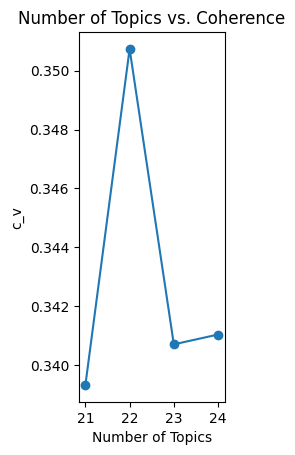

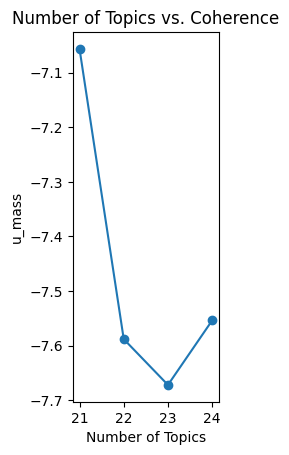

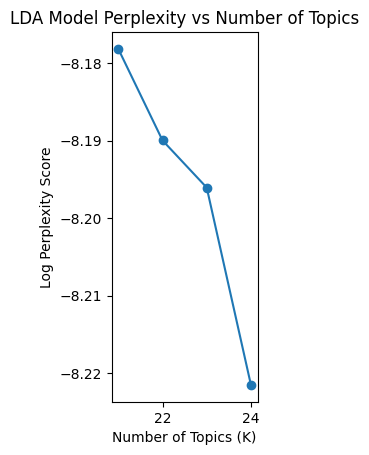

In [ ]:
reviews_w_ngrams = pd.DataFrame(amazon_df_dsa.cleaned_review.copy())
reviews_w_ngrams.cleaned_review = reviews_w_ngrams.cleaned_review.map(lambda x: replace_ngram(x) if isinstance(x, str) else x)

# tokenize reviews + remove stop words + remove names + remove words with less than 2 characters
reviews_w_ngrams = reviews_w_ngrams.cleaned_review.map(lambda x: [word for word in x.split() if word not in stop_words and len(word) > 2] if isinstance(x, str) else x)
reviews_w_ngrams.dropna(axis=0, inplace=True)
reviews_w_ngrams.isnull().sum()

final_reviews = reviews_w_ngrams
final_reviews.dropna(axis=0, inplace=True)

dictionary = corpora.Dictionary(final_reviews)
doc_term_matrix = [dictionary.doc2bow(doc) for doc in final_reviews]

coherence = []
umass = []
px = []
topic_range = range(21, 25)
for k in topic_range:
    print('Round: '+str(k))
    Lda = gensim.models.ldamodel.LdaModel
    ldamodel = Lda(doc_term_matrix, num_topics=k, id2word = dictionary, passes=40,\
                   iterations=200, chunksize = 10000, eval_every = None, random_state=0)
    
    cm = gensim.models.coherencemodel.CoherenceModel(model=ldamodel, texts=final_reviews,\
                                                     dictionary=dictionary, coherence='c_v')
    mm = gensim.models.coherencemodel.CoherenceModel(model=ldamodel, texts=final_reviews,\
                                                     dictionary=dictionary, coherence='u_mass')
    coherence.append((k,cm.get_coherence()))
    umass.append((k,mm.get_coherence()))
    px.append(ldamodel.log_perplexity(doc_term_matrix))
    
    
x_val = [x[0] for x in coherence]
y_val = [x[1] for x in coherence]

x_val_u = [x[0] for x in umass]
y_val_y = [x[1] for x in umass]

plt.subplot(1,3,1)
plt.plot(x_val,y_val)
plt.scatter(x_val,y_val)
plt.title('Number of Topics vs. Coherence')
plt.xlabel('Number of Topics')
plt.ylabel('c_v')
plt.xticks(x_val)
plt.show()

plt.subplot(1,3,2)
plt.plot(x_val_u,y_val_y)
plt.scatter(x_val_u,y_val_y)
plt.title('Number of Topics vs. Coherence')
plt.xlabel('Number of Topics')
plt.ylabel('u_mass')
plt.xticks(x_val_u)
plt.show()

plt.subplot(1,3,3)
plt.plot(topic_range, px, marker='o')
plt.xlabel("Number of Topics (K)")
plt.ylabel("Log Perplexity Score")
plt.title("LDA Model Perplexity vs Number of Topics")
plt.show()

In [ ]:
for i in topic_range:
    name = 'dsa_all'
    num = i
    Lda = gensim.models.ldamodel.LdaModel
    ldamodel = Lda(doc_term_matrix, num_topics=num, id2word = dictionary, passes=40,\
                iterations=200,  chunksize = 10000, eval_every = None, random_state=0)
    Lda2 = gensim.models.ldamodel.LdaModel
    ldamodel2 = Lda2(doc_term_matrix, num_topics=num, id2word = dictionary, passes=40,\
                iterations=200,  chunksize = 10000, eval_every = None, random_state=0)
    
    # To show initial topics
    ldamodel.show_topics(num, num_words=10, formatted=False)
    
    # To show initial topics
    ldamodel2.show_topics(num, num_words=10, formatted=False)
    
    # Visualize the topics
    pyLDAvis.enable_notebook()
    LDAvis_data_filepath = os.path.join('./results/ldavis_prepared_'+'v3_0129')
    
    # Create directory if it does not exist
    if not os.path.exists('./results'):
        os.makedirs('./results')
    LDAvis_prepared = pyLDAvis.gensim.prepare(ldamodel2, doc_term_matrix, dictionary, mds = 'pcoa')
    with open(LDAvis_data_filepath, 'wb') as f:
        pickle.dump(LDAvis_prepared, f)
        
    # load the pre-prepared pyLDAvis data from disk
    with open(LDAvis_data_filepath, 'rb') as f:
        LDAvis_prepared = pickle.load(f)
    pyLDAvis.save_html(LDAvis_prepared, './results/ldavis_prepared_'+ f'{name}_{num}' +'.html')
    display(LDAvis_prepared)
    
    topic_data = LDAvis_prepared
    all_topics = {}
    num_terms = 10  # Adjust number of words to represent each topic
    lambd = 0.6  # Adjust this accordingly based on tuning above
    for j in range(1, num + 1):  # Adjust this to reflect number of topics chosen for final LDA model
        topic = topic_data.topic_info[topic_data.topic_info.Category == 'Topic' + str(j)].copy()
        topic['relevance'] = topic['loglift'] * (1 - lambd) + topic['logprob'] * lambd
        # 리스트 길이 보정: max_length 만큼 패딩 (NaN 추가)
        terms = topic.sort_values(by='relevance', ascending=False).Term.tolist()
        all_topics['Topic ' + str(j)] = terms[:num_terms] + [None] * (num_terms - len(terms))
    lda2_test_results = pd.DataFrame.from_dict(all_topics, orient='index')
    display(lda2_test_results)

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
20    -0.042718  0.062769       1        1  7.716459
15    -0.126821 -0.021935       2        1  7.266976
2     -0.002048 -0.019550       3        1  5.951873
8      0.085570 -0.042820       4        1  5.808465
13    -0.065563  0.100105       5        1  5.610778
10     0.015325 -0.002805       6        1  5.516656
19    -0.084350 -0.097198       7        1  5.399690
6     -0.131790  0.000065       8        1  4.948079
7      0.062617 -0.026924       9        1  4.755203
17     0.071445  0.050154      10        1  4.472167
0     -0.032331 -0.007356      11        1  4.396194
18     0.011044 -0.107608      12        1  4.378082
12     0.031179 -0.114411      13        1  4.291836
4     -0.033298 -0.060670      14        1  4.267988
14     0.055904  0.018910      15        1  4.220599
3     -0.045572  0.081274      16        1  4.140622
11     0.025090  0.039495      17        1  4.077020
9     -0.032076  0.056073      18        1  3.910825
1      0.030922  0.016834      19        1  3.397317
5      0.086617  0.106972      20        1  3.073591
16     0.120854 -0.031376      21        1  2.399580, topic_info=                   Term        Freq       Total Category  logprob  loglift
343              bottle  166.000000  166.000000  Default  30.0000  30.0000
15                smell  146.000000  146.000000  Default  29.0000  29.0000
441           sensitive  183.000000  183.000000  Default  28.0000  28.0000
319                 dry  162.000000  162.000000  Default  27.0000  27.0000
36                 face  410.000000  410.000000  Default  26.0000  26.0000
305          difference   60.000000   60.000000  Default  25.0000  25.0000
54               sticky   66.000000   66.000000  Default  24.0000  24.0000
0                  acne  132.000000  132.000000  Default  23.0000  23.0000
836               empty   36.000000   36.000000  Default  22.0000  22.0000
345                oily   76.000000   76.000000  Default  21.0000  21.0000
340              smells   70.000000   70.000000  Default  20.0000  20.0000
1227            patches   43.000000   43.000000  Default  19.0000  19.0000
141                eyes   56.000000   56.000000  Default  18.0000  18.0000
429            allergic   60.000000   60.000000  Default  17.0000  17.0000
10                  red  109.000000  109.000000  Default  16.0000  16.0000
12              redness   62.000000   62.000000  Default  15.0000  15.0000
51                scent   54.000000   54.000000  Default  14.0000  14.0000
674               itchy   52.000000   52.000000  Default  13.0000  13.0000
339           recommend   99.000000   99.000000  Default  12.0000  12.0000
224                 old   33.000000   33.000000  Default  11.0000  11.0000
99                cream  103.000000  103.000000  Default  10.0000  10.0000
709                half   41.000000   41.000000  Default   9.0000   9.0000
1264            damaged   19.000000   19.000000  Default   8.0000   8.0000
9                 price   47.000000   47.000000  Default   7.0000   7.0000
485              burned   24.000000   24.000000  Default   6.0000   6.0000
547         moisturizer   77.000000   77.000000  Default   5.0000   5.0000
666              sealed   21.000000   21.000000  Default   4.0000   4.0000
409                pump   28.000000   28.000000  Default   3.0000   3.0000
195               bumps   42.000000   42.000000  Default   2.0000   2.0000
256             package   30.000000   30.000000  Default   1.0000   1.0000
1907                010    3.496689    4.270840   Topic1  -6.0240   2.3618
1917          wisconsin    3.496689    4.270840   Topic1  -6.0240   2.3618
1912            lotions    3.496689    4.270840   Topic1  -6.0240   2.3618
1910            flaring    3.496689    4.270840   Topic1  -6.0240   2.3618
1909            dormant    3.496689    4.270840   Topic1  -6.0240   2.3618
1915         reapplying    3.496689   

,0,1,2,3,4,5,6,7,8,9
Topic 1,dry,day,oil,bad,spots,eye,scent,face,burning,stopped
Topic 2,oily,dry,acne,cream,face,combination,sensitive,pump,moisturizer,bumps
Topic 3,scent,long,calming,redness,moisturizing,effective,perfume,visible,balm,smell
Topic 4,bottle,empty,half,dioxide,titanium,small,high,size,replacement,leak
Topic 5,face,patches,hours,different,repurchase,eye,days,something,lotion,bumps
Topic 6,real,bad,anything,disappointed,several,breakouts,fake,reviews,syringe,heard
Topic 7,damaged,sensitive,eyes,recommend,cream,barrier,zits,irritation,pump,rash
Topic 8,difference,face,sensitive,acne,price,irritated,red,pore,noticeable,worth
Topic 9,dead,consistency,company,smell,american,wish,dissatisfied,rather,spilled,filters
Topic 10,smell,serum,smells,headache,read,sick,face,oil,supposed,units


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
13    -0.109521 -0.151418       1        1  7.099618
20    -0.067427  0.109130       2        1  7.036310
15    -0.105736  0.065571       3        1  6.785361
10     0.127440 -0.022715       4        1  5.776370
0      0.006158  0.041438       5        1  5.259760
2     -0.000051  0.048550       6        1  5.255420
21    -0.055510 -0.089605       7        1  5.252515
12    -0.065601  0.046299       8        1  4.851525
6     -0.072691  0.061194       9        1  4.588788
8      0.057335 -0.000323      10        1  4.438051
9      0.045453  0.014104      11        1  4.117724
17     0.034461 -0.004147      12        1  3.944494
4     -0.013562  0.008286      13        1  3.926268
3     -0.064585 -0.061939      14        1  3.914148
18    -0.069272 -0.070520      15        1  3.878758
7      0.036894  0.007864      16        1  3.845299
19    -0.011231  0.027388      17        1  3.814481
1      0.145989 -0.081842      18        1  3.690960
5      0.035436  0.019279      19        1  3.674378
11     0.032903  0.052947      20        1  3.259587
14     0.025351 -0.077936      21        1  2.947188
16     0.087764  0.058396      22        1  2.642999, topic_info=                        Term        Freq       Total Category  logprob  \
343                   bottle  162.000000  162.000000  Default  30.0000   
836                    empty   34.000000   34.000000  Default  29.0000   
305               difference   60.000000   60.000000  Default  28.0000   
10                       red  112.000000  112.000000  Default  27.0000   
441                sensitive  183.000000  183.000000  Default  26.0000   
36                      face  414.000000  414.000000  Default  25.0000   
709                     half   40.000000   40.000000  Default  24.0000   
345                     oily   76.000000   76.000000  Default  23.0000   
15                     smell  145.000000  145.000000  Default  22.0000   
0                       acne  132.000000  132.000000  Default  21.0000   
99                     cream  103.000000  103.000000  Default  20.0000   
319                      dry  162.000000  162.000000  Default  19.0000   
429                 allergic   60.000000   60.000000  Default  18.0000   
339                recommend   99.000000   99.000000  Default  17.0000   
5               disappointed   90.000000   90.000000  Default  16.0000   
24                 breakouts   42.000000   42.000000  Default  15.0000   
674                    itchy   54.000000   54.000000  Default  14.0000   
114                    pores   58.000000   58.000000  Default  13.0000   
495                irritated   39.000000   39.000000  Default  12.0000   
141                     eyes   57.000000   57.000000  Default  11.0000   
12                   redness   62.000000   62.000000  Default  10.0000   
122                      bad  117.000000  117.000000  Default   9.0000   
450                      oil   75.000000   75.000000  Default   8.0000   
121                 anything   77.000000   77.000000  Default   7.0000   
340                   smells   70.000000   70.000000  Default   6.0000   
1227                 patches   44.000000   44.000000  Default   5.0000   
409                     pump   27.000000   27.000000  Default   4.0000   
269                      eye   38.000000   38.000000  Default   3.0000   
485                   burned   25.000000   25.000000  Default   2.0000   
54                    sticky   66.000000   66.000000  Default   1.0000   
1026                  ruined    3.529199    4.324127   Topic1  -5.9314   
898                     fire    8.489731   10.403041   Topic1  -5.0536   
2158                  rashes    6.949025    8.659399   Topic1  -5.2539   
1509                absolute    2.673127    3.448255   Topic1  -6.2092   
553                   flared    2.670647    3.448057   Topic1  -6.2102   
484                  

,0,1,2,3,4,5,6,7,8,9
Topic 1,red,face,itchy,irritated,patches,eye,fire,sensitive,days,rashes
Topic 2,dry,spots,sticky,day,snail,eye_cream,face,stop,wrong,oil
Topic 3,oily,dry,cream,face,sensitive,moisturizer,acne,hands,combination,tight
Topic 4,bottle,smelled,bad,terrible,lid,fake,smell,dark,believe,jawline
Topic 5,changed,eyes,asian,zits,mascara,tea_tree,happened,toner,pores,stopped
Topic 6,redness,applying,scent,three,white,calming,black,stings,burns,paid
Topic 7,sensation,eyes,probably,wrinkles,price,menthol,sponge,anything,face,bacteria
Topic 8,sensitive,breaks,drying,irritation,acne,disappointed,particular,toner,pores,redness
Topic 9,breakouts,sensitive,honestly,burned,face,acne,careful,bad,months,recommend
Topic 10,color,dioxide,titanium,small,betaine,fill,salicylate,syringe,tint,dog


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
20    -0.087754 -0.078909       1        1  7.428426
10     0.132465  0.002543       2        1  5.861124
8      0.078010  0.172228       3        1  5.846882
15    -0.105932  0.024645       4        1  5.838888
13    -0.078293  0.018499       5        1  5.630014
3     -0.188858  0.017240       6        1  5.442607
12    -0.064693  0.000206       7        1  5.110387
21    -0.022944  0.058403       8        1  4.982244
7      0.089823 -0.005305       9        1  4.508438
2      0.037669  0.018472      10        1  4.449750
4      0.023078  0.124681      11        1  4.380272
19    -0.060397 -0.022284      12        1  4.150746
0      0.020172 -0.104098      13        1  4.113068
18    -0.024460  0.050420      14        1  3.891513
17    -0.034631 -0.028580      15        1  3.709102
5      0.036863 -0.123860      16        1  3.658330
9      0.021582 -0.040644      17        1  3.588593
14     0.021350  0.000854      18        1  3.512807
22     0.038515 -0.026157      19        1  3.396974
1      0.020393 -0.007502      20        1  3.378952
6      0.010703  0.035138      21        1  2.963206
11     0.030513 -0.016608      22        1  2.427873
16     0.106827 -0.069383      23        1  1.729804, topic_info=                        Term        Freq       Total Category  logprob  \
343                   bottle  169.000000  169.000000  Default  30.0000   
441                sensitive  185.000000  185.000000  Default  29.0000   
36                      face  416.000000  416.000000  Default  28.0000   
345                     oily   76.000000   76.000000  Default  27.0000   
319                      dry  162.000000  162.000000  Default  26.0000   
15                     smell  145.000000  145.000000  Default  25.0000   
10                       red  110.000000  110.000000  Default  24.0000   
836                    empty   36.000000   36.000000  Default  23.0000   
0                       acne  131.000000  131.000000  Default  22.0000   
141                     eyes   56.000000   56.000000  Default  21.0000   
547              moisturizer   78.000000   78.000000  Default  20.0000   
224                      old   32.000000   32.000000  Default  19.0000   
340                   smells   70.000000   70.000000  Default  18.0000   
709                     half   42.000000   42.000000  Default  17.0000   
305               difference   60.000000   60.000000  Default  16.0000   
1227                 patches   43.000000   43.000000  Default  15.0000   
122                      bad  118.000000  118.000000  Default  14.0000   
450                      oil   75.000000   75.000000  Default  13.0000   
243                different   58.000000   58.000000  Default  12.0000   
99                     cream  103.000000  103.000000  Default  11.0000   
56                 sunscreen   45.000000   45.000000  Default  10.0000   
429                 allergic   60.000000   60.000000  Default   9.0000   
1264                 damaged   19.000000   19.000000  Default   8.0000   
51                     scent   54.000000   54.000000  Default   7.0000   
9                      price   47.000000   47.000000  Default   6.0000   
114                    pores   58.000000   58.000000  Default   5.0000   
100                     days   73.000000   73.000000  Default   4.0000   
195                    bumps   42.000000   42.000000  Default   3.0000   
674                    itchy   53.000000   53.000000  Default   2.0000   
487                 terrible   23.000000   23.000000  Default   1.0000   
1907                     010    3.477410    4.252766   Topic1  -5.9915   
1908                   deals    3.477410    4.252766   Topic1  -5.9915   
1909                 dormant    3.477410    4.252766   Topic1  -5.9915   
1910                 flaring    3.477410    4.252766   Topic1  -5.9915   
1912                 lotions    3.477410  

,0,1,2,3,4,5,6,7,8,9
Topic 1,eye,face,bad,red,cream,day,dry,sticky,burning,instantly
Topic 2,bottle,bad,smelled,thin,tampered,dark,sealed,batch,moisturizer,changed
Topic 3,bottle,empty,half,finished,sealed,betaine,spread,high,blackheads,toner
Topic 4,oily,dry,moisturizer,face,cream,greasy,hands,acne,pretty,tight
Topic 5,face,patches,hours,woke,days,putting,different,red,rashes,bumps
Topic 6,sensitive,face,red,sunscreen,irritated,recommend,bumps,dry,itchy,titanium
Topic 7,sensitive,scent,heard,watery,things,beware,consistency,tea_tree,toner,spray
Topic 8,pores,clogged,anything,experience,uses,recommend,breakouts,pimples,huge,mascara
Topic 9,tube,dead,excited,smell,face,sucks,bad,packaging,removing,meant
Topic 10,smells,redness,horrible,elf,hard,scent,old,corrector,white,applying


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
20     0.044782 -0.044905       1        1  7.989606
23     0.094659 -0.096982       2        1  6.166983
15     0.103795 -0.031412       3        1  5.590809
21     0.016221  0.020881       4        1  5.559047
13     0.079453 -0.103823       5        1  4.680509
10    -0.131439 -0.040262       6        1  4.625045
5     -0.223922 -0.066417       7        1  4.532819
19     0.013859  0.059929       8        1  4.525046
0      0.053021  0.046829       9        1  4.388202
8      0.023929  0.026914      10        1  4.343274
2      0.038823  0.021887      11        1  4.183675
3      0.071652 -0.056813      12        1  3.930776
18     0.076954  0.061593      13        1  3.910109
4      0.053946  0.120580      14        1  3.800638
17    -0.048833  0.027000      15        1  3.678851
12     0.010315 -0.037412      16        1  3.657102
7      0.013129  0.031688      17        1  3.650215
9     -0.014341 -0.007051      18        1  3.534731
14    -0.004843 -0.054559      19        1  3.499297
1     -0.017828 -0.066449      20        1  3.391837
22    -0.099826 -0.042521      21        1  3.032369
11    -0.096172  0.067154      22        1  2.673645
6      0.041598  0.059836      23        1  2.651121
16    -0.098935  0.104317      24        1  2.004293, topic_info=                        Term        Freq       Total Category  logprob  \
343                   bottle  165.000000  165.000000  Default  30.0000   
836                    empty   36.000000   36.000000  Default  29.0000   
99                     cream  103.000000  103.000000  Default  28.0000   
15                     smell  145.000000  145.000000  Default  27.0000   
36                      face  413.000000  413.000000  Default  26.0000   
319                      dry  159.000000  159.000000  Default  25.0000   
372                    worth   40.000000   40.000000  Default  24.0000   
10                       red  110.000000  110.000000  Default  23.0000   
345                     oily   75.000000   75.000000  Default  22.0000   
709                     half   42.000000   42.000000  Default  21.0000   
441                sensitive  181.000000  181.000000  Default  20.0000   
9                      price   47.000000   47.000000  Default  19.0000   
122                      bad  118.000000  118.000000  Default  18.0000   
0                       acne  130.000000  130.000000  Default  17.0000   
339                recommend   99.000000   99.000000  Default  16.0000   
305               difference   61.000000   61.000000  Default  15.0000   
5               disappointed   89.000000   89.000000  Default  14.0000   
261                    serum   82.000000   82.000000  Default  13.0000   
268                   enough   26.000000   26.000000  Default  12.0000   
409                     pump   27.000000   27.000000  Default  11.0000   
547              moisturizer   77.000000   77.000000  Default  10.0000   
485                   burned   24.000000   24.000000  Default   9.0000   
54                    sticky   66.000000   66.000000  Default   8.0000   
429                 allergic   62.000000   62.000000  Default   7.0000   
340                   smells   70.000000   70.000000  Default   6.0000   
465                    toner   48.000000   48.000000  Default   5.0000   
269                      eye   38.000000   38.000000  Default   4.0000   
277                     wish   22.000000   22.000000  Default   3.0000   
224                      old   34.000000   34.000000  Default   2.0000   
348                    dried   32.000000   32.000000  Default   1.0000   
1912                 lotions    3.509199    4.287303   Topic1  -6.0552   
1908                   deals    3.509199    4.287303   Topic1  -6.0552   
1915              reapplying    3.509199    4.287303   Topic1  -6.0552   
1909                 dormant    3.509199    4.287303   Topic1  

,0,1,2,3,4,5,6,7,8,9
Topic 1,difference,bad,day,oil,different,eye,face,texture,spots,essence
Topic 2,allergic,face,redness,sticky,sensitive,lotion,red,elf,terrible,slightly
Topic 3,cream,face,night,hands,morning,sensitive,fungal,acne,moisturizing,moisturizer
Topic 4,wrinkles,sponge,mold,bacteria,pores,foundation,face,known,tasted,milky
Topic 5,face,red,fire,patches,masks,bumps,eye,itchy,delivered,within
Topic 6,bottle,smelled,hard,smell,dark,real,expired,bad,disappointed,long
Topic 7,bottle,empty,half,bottles,dropper,disappointed,leaking,original,returned,window
Topic 8,damaged,recommend,turned,usage,high,sunscreen,treatments,neck,smell,watery
Topic 9,toner,zero,acne,huge,moisturizer,sunscreens,lightweight,fix,drying,asian
Topic 10,oily,dioxide,titanium,greasy,small,betaine,sunscreen,color,green,salicylate


###### Dr.Jart+

Round: 21
Round: 22
Round: 23
Round: 24


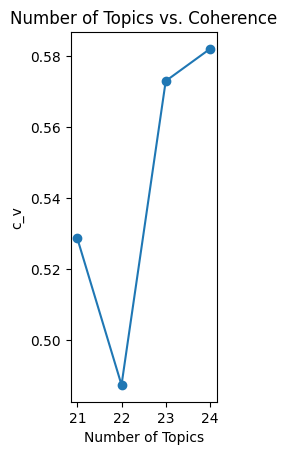

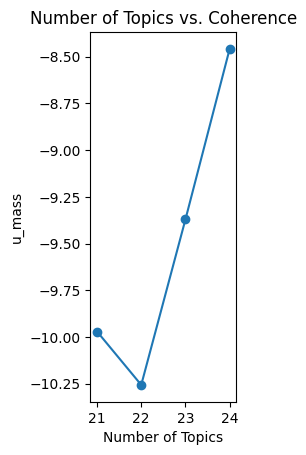

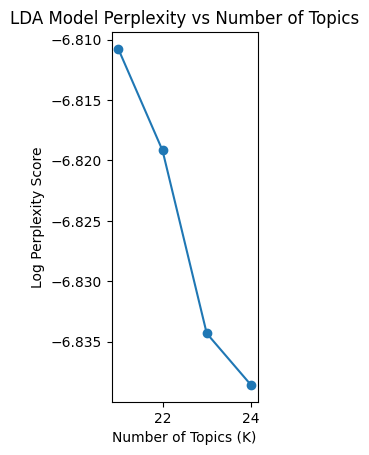

In [ ]:
reviews_w_ngrams = pd.DataFrame(amazon_df_dsa_dr.cleaned_review.copy())
reviews_w_ngrams.cleaned_review = reviews_w_ngrams.cleaned_review.map(lambda x: replace_ngram(x) if isinstance(x, str) else x)

# tokenize reviews + remove stop words + remove names + remove words with less than 2 characters
reviews_w_ngrams = reviews_w_ngrams.cleaned_review.map(lambda x: [word for word in x.split() if word not in stop_words and len(word) > 2] if isinstance(x, str) else x)
reviews_w_ngrams.dropna(axis=0, inplace=True)
reviews_w_ngrams.isnull().sum()

final_reviews = reviews_w_ngrams
final_reviews.dropna(axis=0, inplace=True)

dictionary = corpora.Dictionary(final_reviews)
doc_term_matrix = [dictionary.doc2bow(doc) for doc in final_reviews]

coherence = []
umass = []
px = []
topic_range = range(21, 25)
for k in topic_range:
    print('Round: '+str(k))
    Lda = gensim.models.ldamodel.LdaModel
    ldamodel = Lda(doc_term_matrix, num_topics=k, id2word = dictionary, passes=40,\
                   iterations=200, chunksize = 10000, eval_every = None, random_state=0)
    
    cm = gensim.models.coherencemodel.CoherenceModel(model=ldamodel, texts=final_reviews,\
                                                     dictionary=dictionary, coherence='c_v')
    mm = gensim.models.coherencemodel.CoherenceModel(model=ldamodel, texts=final_reviews,\
                                                     dictionary=dictionary, coherence='u_mass')
    coherence.append((k,cm.get_coherence()))
    umass.append((k,mm.get_coherence()))
    px.append(ldamodel.log_perplexity(doc_term_matrix))
    
    
x_val = [x[0] for x in coherence]
y_val = [x[1] for x in coherence]

x_val_u = [x[0] for x in umass]
y_val_y = [x[1] for x in umass]

plt.subplot(1,3,1)
plt.plot(x_val,y_val)
plt.scatter(x_val,y_val)
plt.title('Number of Topics vs. Coherence')
plt.xlabel('Number of Topics')
plt.ylabel('c_v')
plt.xticks(x_val)
plt.show()

plt.subplot(1,3,2)
plt.plot(x_val_u,y_val_y)
plt.scatter(x_val_u,y_val_y)
plt.title('Number of Topics vs. Coherence')
plt.xlabel('Number of Topics')
plt.ylabel('u_mass')
plt.xticks(x_val_u)
plt.show()

plt.subplot(1,3,3)
plt.plot(topic_range, px, marker='o')
plt.xlabel("Number of Topics (K)")
plt.ylabel("Log Perplexity Score")
plt.title("LDA Model Perplexity vs Number of Topics")
plt.show()

In [ ]:
for i in topic_range:
    name = 'dsa_dr'
    num = i
    Lda = gensim.models.ldamodel.LdaModel
    ldamodel = Lda(doc_term_matrix, num_topics=num, id2word = dictionary, passes=40,\
                iterations=200,  chunksize = 10000, eval_every = None, random_state=0)
    Lda2 = gensim.models.ldamodel.LdaModel
    ldamodel2 = Lda2(doc_term_matrix, num_topics=num, id2word = dictionary, passes=40,\
                iterations=200,  chunksize = 10000, eval_every = None, random_state=0)
    
    # To show initial topics
    ldamodel.show_topics(num, num_words=10, formatted=False)
    
    # To show initial topics
    ldamodel2.show_topics(num, num_words=10, formatted=False)
    
    # Visualize the topics
    pyLDAvis.enable_notebook()
    LDAvis_data_filepath = os.path.join('./results/ldavis_prepared_'+'v3_0129')
    
    # Create directory if it does not exist
    if not os.path.exists('./results'):
        os.makedirs('./results')
    LDAvis_prepared = pyLDAvis.gensim.prepare(ldamodel2, doc_term_matrix, dictionary, mds = 'pcoa')
    with open(LDAvis_data_filepath, 'wb') as f:
        pickle.dump(LDAvis_prepared, f)
        
    # load the pre-prepared pyLDAvis data from disk
    with open(LDAvis_data_filepath, 'rb') as f:
        LDAvis_prepared = pickle.load(f)
    pyLDAvis.save_html(LDAvis_prepared, './results/ldavis_prepared_'+ f'{name}_{num}' +'.html')
    display(LDAvis_prepared)
    
    topic_data = LDAvis_prepared
    all_topics = {}
    num_terms = 10  # Adjust number of words to represent each topic
    lambd = 0.6  # Adjust this accordingly based on tuning above
    for j in range(1, num + 1):  # Adjust this to reflect number of topics chosen for final LDA model
        topic = topic_data.topic_info[topic_data.topic_info.Category == 'Topic' + str(j)].copy()
        topic['relevance'] = topic['loglift'] * (1 - lambd) + topic['logprob'] * lambd
        # 리스트 길이 보정: max_length 만큼 패딩 (NaN 추가)
        terms = topic.sort_values(by='relevance', ascending=False).Term.tolist()
        all_topics['Topic ' + str(j)] = terms[:num_terms] + [None] * (num_terms - len(terms))
    lda2_test_results = pd.DataFrame.from_dict(all_topics, orient='index')
    display(lda2_test_results)

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
15    -0.046408  0.112041       1        1  8.795084
7     -0.065463 -0.075674       2        1  8.692041
13    -0.095398 -0.019277       3        1  8.333047
3     -0.212551 -0.106771       4        1  7.413950
16     0.014767  0.190214       5        1  7.133015
9      0.117433 -0.035090       6        1  6.246627
19     0.087886 -0.153346       7        1  6.178383
17    -0.113677  0.005635       8        1  5.671142
11    -0.009791  0.062054       9        1  5.314517
20    -0.021629  0.007604      10        1  4.865154
0     -0.039227 -0.073925      11        1  4.662470
5     -0.021917  0.044803      12        1  4.632932
10    -0.008816  0.077803      13        1  4.559037
6      0.013822  0.067840      14        1  4.064603
2      0.128957 -0.037888      15        1  3.708374
12     0.055144 -0.003688      16        1  2.875191
8      0.080465 -0.042747      17        1  2.066135
18     0.008854  0.025307      18        1  1.856349
14     0.036822 -0.032967      19        1  1.388889
1      0.036696  0.005345      20        1  0.913585
4      0.054030 -0.017274      21        1  0.629475, topic_info=                           Term       Freq      Total Category  logprob  \
36                         face  41.000000  41.000000  Default  30.0000   
12                      redness  25.000000  25.000000  Default  29.0000   
441                   sensitive  11.000000  11.000000  Default  28.0000   
28                        color  16.000000  16.000000  Default  27.0000   
3                         cover  13.000000  13.000000  Default  26.0000   
249                       masks   8.000000   8.000000  Default  25.0000   
99                        cream  10.000000  10.000000  Default  24.0000   
9                         price  13.000000  13.000000  Default  23.0000   
152                       hands   4.000000   4.000000  Default  22.0000   
10                          red  10.000000  10.000000  Default  21.0000   
172                        zits   5.000000   5.000000  Default  20.0000   
54                       sticky   6.000000   6.000000  Default  19.0000   
57                        thick   7.000000   7.000000  Default  18.0000   
319                         dry   7.000000   7.000000  Default  17.0000   
42                        green   9.000000   9.000000  Default  16.0000   
100                        days   6.000000   6.000000  Default  15.0000   
65                         wash   7.000000   7.000000  Default  14.0000   
33                      dioxide   5.000000   5.000000  Default  13.0000   
60                     titanium   5.000000   5.000000  Default  12.0000   
361                        peel   4.000000   4.000000  Default  11.0000   
51                        scent   9.000000   9.000000  Default  10.0000   
62                        white  11.000000  11.000000  Default   9.0000   
5                  disappointed   5.000000   5.000000  Default   8.0000   
159                     changed   6.000000   6.000000  Default   7.0000   
224                         old   5.000000   5.000000  Default   6.0000   
41                       greasy   7.000000   7.000000  Default   5.0000   
68                        light   6.000000   6.000000  Default   4.0000   
134               disappointing   3.000000   3.000000  Default   3.0000   
345                        oily   5.000000   5.000000  Default   2.0000   
121                    anything   3.000000   3.000000  Default   1.0000   
33                      dioxide   4.899156   5.497162   Topic1  -3.4248   
60                     titanium   4.899155   5.497163   Topic1  -3.4248   
56                    sunscreen   3.278955   3.876961   Topic1  -3.8263   
435                      packet   1.658754   2.256757   Topic1  -4.5078   
438                      redder   1.658754   2.256757   Topic1  -4.5078   
376                       piece   1.65

,0,1,2,3,4,5,6,7,8,9
Topic 1,dioxide,titanium,sunscreen,color,given,fit,green,face,botanicals,recently
Topic 2,essence,media,posts,miracle,game,dulls,marketing,social,coats,expecting
Topic 3,scent,toner,oil,tea_tree,prefer,green,expected,miss,camo,concealer
Topic 4,redness,matter,cover,elf,worse,thick,corrector,white,videos,drug
Topic 5,masks,face,ended,clay,yellow,wouldnt,normally,awful,peel,serum
Topic 6,silicones,reason,barrier,hydrating,face_wash,vinyl,dimethicone,recommend,lightweight,marine
Topic 7,zits,stopped,changed,cream,oily,entire,diet,hydration,cuz,figure
Topic 8,redness,tone,menthol,eyes,wipe,guy,tears,puts,covid,condition
Topic 9,directly,sealed,seal,original,current,plastic,fair,hoping,moisturizer,blotchy
Topic 10,peel,old,color,crazy,neutral,odd,final,cool,soon,applying


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
2     -0.051675 -0.135052       1        1  9.045882
17     0.170213 -0.054664       2        1  8.062148
20     0.092815  0.008858       3        1  6.907695
11     0.003315  0.142931       4        1  6.441797
15     0.082498  0.087559       5        1  6.213773
7      0.163715  0.051551       6        1  5.883314
14    -0.142138  0.082981       7        1  5.445565
18     0.002924 -0.143045       8        1  4.898591
5      0.072092  0.030017       9        1  4.889268
3      0.087956 -0.026995      10        1  4.730684
12    -0.019835 -0.123285      11        1  4.499647
16    -0.047119 -0.028105      12        1  4.298498
6     -0.066212 -0.005899      13        1  4.197749
13     0.092127  0.018194      14        1  3.735783
0     -0.080784  0.073104      15        1  3.581162
10    -0.066344 -0.016087      16        1  3.462140
8     -0.070777 -0.009990      17        1  3.303551
1     -0.103628  0.035734      18        1  3.121671
9     -0.016380  0.010928      19        1  2.428623
4     -0.047904 -0.000068      20        1  1.744471
19    -0.027422  0.018703      21        1  1.719869
21    -0.027438 -0.017371      22        1  1.388119, topic_info=                           Term       Freq      Total Category  logprob  \
12                      redness  24.000000  24.000000  Default  30.0000   
36                         face  41.000000  41.000000  Default  29.0000   
441                   sensitive  10.000000  10.000000  Default  28.0000   
3                         cover  12.000000  12.000000  Default  27.0000   
172                        zits   5.000000   5.000000  Default  26.0000   
99                        cream  10.000000  10.000000  Default  25.0000   
51                        scent   8.000000   8.000000  Default  24.0000   
28                        color  16.000000  16.000000  Default  23.0000   
62                        white  11.000000  11.000000  Default  22.0000   
159                     changed   5.000000   5.000000  Default  21.0000   
42                        green   8.000000   8.000000  Default  20.0000   
65                         wash   7.000000   7.000000  Default  19.0000   
152                       hands   4.000000   4.000000  Default  18.0000   
33                      dioxide   5.000000   5.000000  Default  17.0000   
60                     titanium   5.000000   5.000000  Default  16.0000   
170                     stopped   3.000000   3.000000  Default  15.0000   
57                        thick   7.000000   7.000000  Default  14.0000   
35                    expensive   6.000000   6.000000  Default  13.0000   
10                          red  11.000000  11.000000  Default  12.0000   
31                    corrector   7.000000   7.000000  Default  11.0000   
249                       masks   8.000000   8.000000  Default  10.0000   
319                         dry   7.000000   7.000000  Default   9.0000   
68                        light   6.000000   6.000000  Default   8.0000   
429                    allergic   4.000000   4.000000  Default   7.0000   
1                        cheeks   5.000000   5.000000  Default   6.0000   
345                        oily   5.000000   5.000000  Default   5.0000   
261                       serum   5.000000   5.000000  Default   4.0000   
465                       toner   3.000000   3.000000  Default   3.0000   
76                          elf   4.000000   4.000000  Default   2.0000   
81                          day   8.000000   8.000000  Default   1.0000   
351                        clay   1.665463   2.288177   Topic1  -4.5319   
380                         air   1.665463   2.288177   Topic1  -4.5319   
402                    industry   1.665463   2.288177   Topic1  -4.5319   
405               manufacturers   1.665463   2.288177   Topic1  -4.5319   
708                        easy   1.665462   2.288177   Topi

,0,1,2,3,4,5,6,7,8,9
Topic 1,clay,easy,improvements,air,manufacturers,industry,wouldnt,fine,notice,face
Topic 2,menthol,covers,peel,completely,redness,reddish,video,sold,scar,gal
Topic 3,old,okay,posts,dulls,apart,social,coats,miracle,media,game
Topic 4,hoping,directly,seal,sealed,foundation,fair,current,bad,expensive,free
Topic 5,dioxide,titanium,sunscreen,color,green,deliver,feature,essentially,recently,straight
Topic 6,matter,elf,vaseline,thick,corrector,redness,white,night,rosecea,gathers
Topic 7,silicones,reason,vinyl,dimethicone,cracks,cakes,barrier,hydrating,portion,hyaluronate
Topic 8,face,allergic,packet,redder,covering,tan,serum,blend,masks,tone
Topic 9,hands,wash,hate,green,turns,becomes,check,rubbed,provides,disappeared
Topic 10,cover,pores,mine,videos,final,odd,showed,redness,worse,wont


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
22    -0.085367 -0.033673       1        1  10.293324
3      0.196820 -0.034264       2        1   9.733632
9     -0.126781  0.078239       3        1   6.985253
17     0.133221  0.102279       4        1   6.690909
15     0.018234 -0.240175       5        1   6.648618
0     -0.103480  0.001295       6        1   6.539925
2     -0.082531  0.037439       7        1   6.267797
18     0.030359  0.059138       8        1   5.154860
13     0.085384 -0.085071       9        1   5.150564
20     0.054565 -0.109499      10        1   4.033950
4      0.068522  0.125939      11        1   3.774836
1     -0.075041 -0.004249      12        1   3.700733
10     0.058608  0.054566      13        1   3.697763
6     -0.037039 -0.025675      14        1   3.411348
11     0.000488  0.034070      15        1   3.293221
12     0.063785  0.065294      16        1   3.007487
7      0.023660 -0.025607      17        1   2.955231
8     -0.064504 -0.014748      18        1   2.304047
21    -0.061374 -0.021984      19        1   2.178324
16    -0.024507 -0.005798      20        1   2.044548
5     -0.039657  0.006004      21        1   0.835244
14     0.009233  0.036384      22        1   0.770954
19    -0.042598  0.000098      23        1   0.527432, topic_info=                           Term       Freq      Total Category  logprob  \
12                      redness  23.000000  23.000000  Default  30.0000   
99                        cream  10.000000  10.000000  Default  29.0000   
3                         cover  11.000000  11.000000  Default  28.0000   
28                        color  16.000000  16.000000  Default  27.0000   
36                         face  41.000000  41.000000  Default  26.0000   
9                         price  13.000000  13.000000  Default  25.0000   
10                          red  11.000000  11.000000  Default  24.0000   
441                   sensitive  12.000000  12.000000  Default  23.0000   
42                        green   8.000000   8.000000  Default  22.0000   
172                        zits   5.000000   5.000000  Default  21.0000   
152                       hands   4.000000   4.000000  Default  20.0000   
65                         wash   7.000000   7.000000  Default  19.0000   
372                       worth   5.000000   5.000000  Default  18.0000   
62                        white  11.000000  11.000000  Default  17.0000   
249                       masks   8.000000   8.000000  Default  16.0000   
33                      dioxide   5.000000   5.000000  Default  15.0000   
60                     titanium   5.000000   5.000000  Default  14.0000   
51                        scent   8.000000   8.000000  Default  13.0000   
31                    corrector   8.000000   8.000000  Default  12.0000   
100                        days   6.000000   6.000000  Default  11.0000   
361                        peel   4.000000   4.000000  Default  10.0000   
97                        worse   4.000000   4.000000  Default   9.0000   
159                     changed   6.000000   6.000000  Default   8.0000   
68                        light   6.000000   6.000000  Default   7.0000   
35                    expensive   6.000000   6.000000  Default   6.0000   
114                       pores   2.000000   2.000000  Default   5.0000   
153                        hate   3.000000   3.000000  Default   4.0000   
170                     stopped   4.000000   4.000000  Default   3.0000   
182                    applying   5.000000   5.000000  Default   2.0000   
57                        thick   7.000000   7.000000  Default   1.0000   
248                     essence   4.198539   4.791787   Topic1  -3.7364   
637                   hydration   1.701123   2.294356   Topic1  -4.6399   
435                      packet   1.701122   2.294356   Topic1  -4.6399   
438                      redder   1.701122   2.294356   T

,0,1,2,3,4,5,6,7,8,9
Topic 1,essence,oily,sensitive,piece,hydration,redder,packet,price,face,sensation
Topic 2,corrector,elf,color,redness,worse,white,clay,posts,drug,miracle
Topic 3,old,silicones,reason,vinyl,dimethicone,vital,hydra,barrier,cream,solution
Topic 4,effect,redness,red,cover,sold,night,wrinkles,shines,rosecea,medicinal
Topic 5,dioxide,titanium,sunscreen,color,green,quantity,essentially,recently,straight,deliver
Topic 6,zits,stopped,toner,scent,changed,oil,tea_tree,helps,sad,tub
Topic 7,website,industry,manufacturers,pump,air,face,claims,light,regulations,opaque
Topic 8,sensitive,visible,turn,red,greenish,sickly,toddler,underneath,irritates,adult
Topic 9,green,prefer,expected,helped,concealer,becomes,camo,applied,slightly,price
Topic 10,peel,color,neutral,final,odd,cool,applying,giving,changes,base


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
6      0.005814 -0.011531       1        1  9.310008
15     0.026631 -0.247471       2        1  8.074607
3      0.188696 -0.080914       3        1  7.264722
7     -0.128549  0.075584       4        1  6.854774
5      0.125798  0.092051       5        1  6.736663
22    -0.121766 -0.014706       6        1  5.989259
20    -0.034641 -0.098374       7        1  5.326596
11    -0.028715  0.012675       8        1  4.909688
2      0.099872  0.024386       9        1  4.547259
8      0.097755  0.106225      10        1  4.487052
19    -0.028638 -0.034832      11        1  4.442344
14     0.087216  0.078682      12        1  4.225957
16    -0.083675 -0.017909      13        1  3.456084
13     0.096983 -0.066292      14        1  3.448883
21    -0.056161  0.031795      15        1  3.253895
10    -0.072362 -0.001223      16        1  2.978420
17     0.035408  0.057276      17        1  2.629599
12    -0.037066 -0.001622      18        1  2.592254
23     0.004999  0.068228      19        1  1.702599
0     -0.029096  0.028288      20        1  1.626063
9     -0.038965  0.012726      21        1  1.605830
18    -0.029565 -0.034299      22        1  1.585478
1     -0.051070  0.015066      23        1  1.572349
4     -0.028903  0.006191      24        1  1.379618, topic_info=                           Term       Freq      Total Category  logprob  \
12                      redness  24.000000  24.000000  Default  30.0000   
441                   sensitive  11.000000  11.000000  Default  29.0000   
36                         face  40.000000  40.000000  Default  28.0000   
28                        color  15.000000  15.000000  Default  27.0000   
3                         cover  11.000000  11.000000  Default  26.0000   
10                          red  10.000000  10.000000  Default  25.0000   
172                        zits   5.000000   5.000000  Default  24.0000   
51                        scent   8.000000   8.000000  Default  23.0000   
42                        green   8.000000   8.000000  Default  22.0000   
99                        cream  11.000000  11.000000  Default  21.0000   
159                     changed   6.000000   6.000000  Default  20.0000   
249                       masks   8.000000   8.000000  Default  19.0000   
68                        light   6.000000   6.000000  Default  18.0000   
97                        worse   4.000000   4.000000  Default  17.0000   
62                        white  11.000000  11.000000  Default  16.0000   
65                         wash   7.000000   7.000000  Default  15.0000   
31                    corrector   8.000000   8.000000  Default  14.0000   
152                       hands   5.000000   5.000000  Default  13.0000   
463                    tea_tree   4.000000   4.000000  Default  12.0000   
170                     stopped   4.000000   4.000000  Default  11.0000   
100                        days   7.000000   7.000000  Default  10.0000   
429                    allergic   3.000000   3.000000  Default   9.0000   
81                          day   8.000000   8.000000  Default   8.0000   
9                         price  13.000000  13.000000  Default   7.0000   
361                        peel   4.000000   4.000000  Default   6.0000   
261                       serum   5.000000   5.000000  Default   5.0000   
5                  disappointed   6.000000   6.000000  Default   4.0000   
60                     titanium   5.000000   5.000000  Default   3.0000   
33                      dioxide   5.000000   5.000000  Default   2.0000   
41                       greasy   7.000000   7.000000  Default   1.0000   
637                   hydration   1.666419   2.278732   Topic1  -4.5601   
730                      chance   1.666418   2.278731   Topic1  -4.5601   
628                     causing   1.666418   2.278731   Topic1  -4.5601   
671                        da

,0,1,2,3,4,5,6,7,8,9
Topic 1,face,cream,oily,chance,hydration,causing,something,expensive,dark,stinging
Topic 2,dioxide,titanium,sunscreen,color,green,recently,idiot,spit,repulsed,melting
Topic 3,matter,elf,redness,corrector,thick,color,reviews,white,yea,creases
Topic 4,silicones,reason,dimethicone,vinyl,marketing,barrier,difference,cream,hydrating,disappointed
Topic 5,hands,hate,literally,wash,redness,video,piece,disappeared,check,sold
Topic 6,essence,packet,redder,face,initially,tacky,texture,due,smell,sensitive
Topic 7,peel,old,neutral,alone,packaging,cool,applying,color,face,thinking
Topic 8,directly,sealed,seal,current,face,replacement,free,genuine,inner,refreshing
Topic 9,coats,game,posts,expecting,media,miracle,social,dulls,pricey,bottle
Topic 10,menthol,days,puts,guy,wipe,tears,easy,eyes,covid,condition


###### COSRX

Round: 21
Round: 22
Round: 23
Round: 24


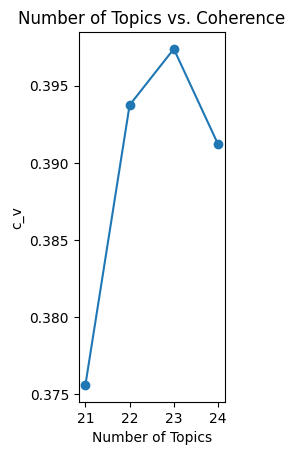

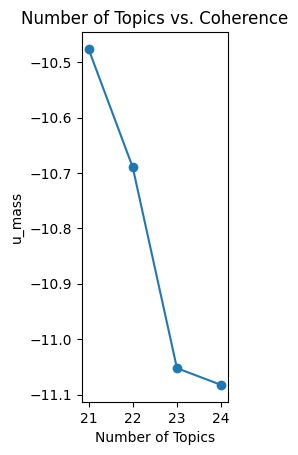

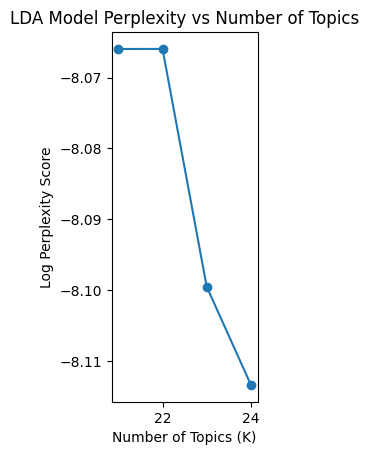

In [ ]:
reviews_w_ngrams = pd.DataFrame(amazon_df_dsa_cs.cleaned_review.copy())
reviews_w_ngrams.cleaned_review = reviews_w_ngrams.cleaned_review.map(lambda x: replace_ngram(x) if isinstance(x, str) else x)

# tokenize reviews + remove stop words + remove names + remove words with less than 2 characters
reviews_w_ngrams = reviews_w_ngrams.cleaned_review.map(lambda x: [word for word in x.split() if word not in stop_words and len(word) > 2] if isinstance(x, str) else x)
reviews_w_ngrams.dropna(axis=0, inplace=True)
reviews_w_ngrams.isnull().sum()

final_reviews = reviews_w_ngrams
final_reviews.dropna(axis=0, inplace=True)

dictionary = corpora.Dictionary(final_reviews)
doc_term_matrix = [dictionary.doc2bow(doc) for doc in final_reviews]

coherence = []
umass = []
px = []
topic_range = range(21, 25)
for k in topic_range:
    print('Round: '+str(k))
    Lda = gensim.models.ldamodel.LdaModel
    ldamodel = Lda(doc_term_matrix, num_topics=k, id2word = dictionary, passes=40,\
                   iterations=200, chunksize = 10000, eval_every = None, random_state=0)
    
    cm = gensim.models.coherencemodel.CoherenceModel(model=ldamodel, texts=final_reviews,\
                                                     dictionary=dictionary, coherence='c_v')
    mm = gensim.models.coherencemodel.CoherenceModel(model=ldamodel, texts=final_reviews,\
                                                     dictionary=dictionary, coherence='u_mass')
    coherence.append((k,cm.get_coherence()))
    umass.append((k,mm.get_coherence()))
    px.append(ldamodel.log_perplexity(doc_term_matrix))
    
    
x_val = [x[0] for x in coherence]
y_val = [x[1] for x in coherence]

x_val_u = [x[0] for x in umass]
y_val_y = [x[1] for x in umass]

plt.subplot(1,3,1)
plt.plot(x_val,y_val)
plt.scatter(x_val,y_val)
plt.title('Number of Topics vs. Coherence')
plt.xlabel('Number of Topics')
plt.ylabel('c_v')
plt.xticks(x_val)
plt.show()

plt.subplot(1,3,2)
plt.plot(x_val_u,y_val_y)
plt.scatter(x_val_u,y_val_y)
plt.title('Number of Topics vs. Coherence')
plt.xlabel('Number of Topics')
plt.ylabel('u_mass')
plt.xticks(x_val_u)
plt.show()

plt.subplot(1,3,3)
plt.plot(topic_range, px, marker='o')
plt.xlabel("Number of Topics (K)")
plt.ylabel("Log Perplexity Score")
plt.title("LDA Model Perplexity vs Number of Topics")
plt.show()

In [ ]:
for i in topic_range:
    name = 'dsa_cs'
    num = i
    Lda = gensim.models.ldamodel.LdaModel
    ldamodel = Lda(doc_term_matrix, num_topics=num, id2word = dictionary, passes=40,\
                iterations=200,  chunksize = 10000, eval_every = None, random_state=0)
    Lda2 = gensim.models.ldamodel.LdaModel
    ldamodel2 = Lda2(doc_term_matrix, num_topics=num, id2word = dictionary, passes=40,\
                iterations=200,  chunksize = 10000, eval_every = None, random_state=0)
    
    # To show initial topics
    ldamodel.show_topics(num, num_words=10, formatted=False)
    
    # To show initial topics
    ldamodel2.show_topics(num, num_words=10, formatted=False)
    
    # Visualize the topics
    pyLDAvis.enable_notebook()
    LDAvis_data_filepath = os.path.join('./results/ldavis_prepared_'+'v3_0129')
    
    # Create directory if it does not exist
    if not os.path.exists('./results'):
        os.makedirs('./results')
    LDAvis_prepared = pyLDAvis.gensim.prepare(ldamodel2, doc_term_matrix, dictionary, mds = 'pcoa')
    with open(LDAvis_data_filepath, 'wb') as f:
        pickle.dump(LDAvis_prepared, f)
        
    # load the pre-prepared pyLDAvis data from disk
    with open(LDAvis_data_filepath, 'rb') as f:
        LDAvis_prepared = pickle.load(f)
    pyLDAvis.save_html(LDAvis_prepared, './results/ldavis_prepared_'+ f'{name}_{num}' +'.html')
    display(LDAvis_prepared)
    
    topic_data = LDAvis_prepared
    all_topics = {}
    num_terms = 10  # Adjust number of words to represent each topic
    lambd = 0.6  # Adjust this accordingly based on tuning above
    for j in range(1, num + 1):  # Adjust this to reflect number of topics chosen for final LDA model
        topic = topic_data.topic_info[topic_data.topic_info.Category == 'Topic' + str(j)].copy()
        topic['relevance'] = topic['loglift'] * (1 - lambd) + topic['logprob'] * lambd
        # 리스트 길이 보정: max_length 만큼 패딩 (NaN 추가)
        terms = topic.sort_values(by='relevance', ascending=False).Term.tolist()
        all_topics['Topic ' + str(j)] = terms[:num_terms] + [None] * (num_terms - len(terms))
    lda2_test_results = pd.DataFrame.from_dict(all_topics, orient='index')
    display(lda2_test_results)

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
17    -0.111220 -0.056616       1        1  7.899224
18    -0.042848 -0.061545       2        1  7.390830
6     -0.103877 -0.101030       3        1  7.303860
4     -0.058585  0.013719       4        1  7.013101
19    -0.079374 -0.021296       5        1  6.340038
7     -0.109204 -0.024767       6        1  6.314258
12     0.224122 -0.181058       7        1  5.832501
8     -0.000306 -0.008111       8        1  5.565071
1     -0.037987  0.005553       9        1  5.223210
11     0.065226  0.062959      10        1  5.109306
13     0.085378  0.059372      11        1  4.732021
14     0.017030 -0.019515      12        1  4.266779
5     -0.026856 -0.065372      13        1  3.948426
9     -0.043696  0.028995      14        1  3.758989
15    -0.030230  0.076251      15        1  3.685235
2      0.021382  0.080738      16        1  3.132442
20     0.049072  0.106304      17        1  3.084487
16     0.072033 -0.008538      18        1  2.829857
0      0.028211  0.034254      19        1  2.671247
10     0.056342  0.045974      20        1  1.978732
3      0.025386  0.033730      21        1  1.920387, topic_info=                        Term        Freq       Total Category  logprob  \
9                     bottle  106.000000  106.000000  Default  30.0000   
119                    empty   21.000000   21.000000  Default  29.0000   
42                      acne   69.000000   69.000000  Default  28.0000   
1                  sensitive   61.000000   61.000000  Default  27.0000   
227                      dry   72.000000   72.000000  Default  26.0000   
113                     half   27.000000   27.000000  Default  25.0000   
72                     smell   68.000000   68.000000  Default  24.0000   
65                difference   34.000000   34.000000  Default  23.0000   
43                       bad   61.000000   61.000000  Default  22.0000   
709                  patches   33.000000   33.000000  Default  21.0000   
4                       help   24.000000   24.000000  Default  20.0000   
109                      red   41.000000   41.000000  Default  19.0000   
0                       oily   37.000000   37.000000  Default  18.0000   
428                    itchy   22.000000   22.000000  Default  17.0000   
56                     toner   24.000000   24.000000  Default  16.0000   
3                       face  187.000000  187.000000  Default  15.0000   
474              moisturizer   38.000000   38.000000  Default  14.0000   
506                  reviews   35.000000   35.000000  Default  13.0000   
2311                 dropper   11.000000   11.000000  Default  12.0000   
44              disappointed   43.000000   43.000000  Default  11.0000   
293                   sticky   34.000000   34.000000  Default  10.0000   
103                   smells   40.000000   40.000000  Default   9.0000   
345                     pump   13.000000   13.000000  Default   8.0000   
992                    serum   43.000000   43.000000  Default   7.0000   
1378                 bottles   17.000000   17.000000  Default   6.0000   
196                 anything   39.000000   39.000000  Default   5.0000   
683                 horrible   12.000000   12.000000  Default   4.0000   
40                     pores   28.000000   28.000000  Default   3.0000   
140                breakouts   17.000000   17.000000  Default   2.0000   
1482                     eye   21.000000   21.000000  Default   1.0000   
1566                     010    3.400993    4.113677   Topic1  -5.3510   
1567                   deals    3.400993    4.113677   Topic1  -5.3510   
1568                 dormant    3.400993    4.113677   Topic1  -5.3510   
1569                 flaring    3.400993    4.113677   Topic1  -5.3510   
1571                 lotions    3.400993    4.113677   Topic1  -5.3510   
1574                   olive    3.400993    4.113677   Topic1  -5.3510   


,0,1,2,3,4,5,6,7,8,9
Topic 1,oily,face,sticky,day,oil,stopped,dry,sadly,searching,needed
Topic 2,acne,kept,syringe,moisturizer,face,orange,oily,painful,cleanser,filled
Topic 3,bad,face,dead,smells,something,batch,smell,greasy,absorb,clean
Topic 4,sensitive,recommend,acne,bad,smell,redness,dog,shellfish,foot,months
Topic 5,face,sunscreens,sunscreen,repurchase,water,asian,retinol,pot,crap,odor
Topic 6,sensitive,dry,red,face,itchy,rash,combination,okay,neck,irritation
Topic 7,bottle,empty,half,dropper,bottles,disappointed,tube,hand,wasting,pump
Topic 8,official,patches,mascara,wrinkles,allergic,store,garlic,issues,fine,severe
Topic 9,acne,reviews,smell,texture,smells,read,control,scars,literally,ineffective
Topic 10,spray,anything,heads,damaged,patches,acid,delivered,remove,harsh,white


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
17    -0.172628  0.037110       1        1  7.754320
18    -0.061658  0.005869       2        1  7.197493
6     -0.093322  0.023521       3        1  6.170071
1      0.023684 -0.074795       4        1  6.167076
19    -0.075947  0.082202       5        1  5.346258
4     -0.031443 -0.003758       6        1  5.117030
7     -0.089312 -0.039453       7        1  5.088852
16     0.143377  0.098750       8        1  4.809121
11    -0.016609  0.095387       9        1  4.647333
15     0.059638 -0.054847      10        1  4.522575
21    -0.059138 -0.116940      11        1  4.437218
2      0.072379  0.029543      12        1  4.315760
5     -0.055896 -0.011199      13        1  4.313863
8     -0.028600 -0.033458      14        1  4.193389
3      0.003515  0.024513      15        1  4.096124
20     0.033076  0.096134      16        1  3.744217
13     0.094617 -0.153196      17        1  3.480756
14     0.085638 -0.036323      18        1  3.406241
0      0.026978  0.039339      19        1  3.337296
12     0.121439  0.048236      20        1  3.118437
9     -0.020125 -0.051285      21        1  3.050221
10     0.040336 -0.005349      22        1  1.686348, topic_info=                  Term        Freq       Total Category  logprob  loglift
9               bottle  104.000000  104.000000  Default  30.0000  30.0000
119              empty   20.000000   20.000000  Default  29.0000  29.0000
109                red   40.000000   40.000000  Default  28.0000  28.0000
113               half   27.000000   27.000000  Default  27.0000  27.0000
65          difference   34.000000   34.000000  Default  26.0000  26.0000
72               smell   68.000000   68.000000  Default  25.0000  25.0000
428              itchy   21.000000   21.000000  Default  24.0000  24.0000
227                dry   74.000000   74.000000  Default  23.0000  23.0000
42                acne   70.000000   70.000000  Default  22.0000  22.0000
0                 oily   37.000000   37.000000  Default  21.0000  21.0000
1            sensitive   61.000000   61.000000  Default  20.0000  20.0000
43                 bad   60.000000   60.000000  Default  19.0000  19.0000
709            patches   33.000000   33.000000  Default  18.0000  18.0000
40               pores   28.000000   28.000000  Default  17.0000  17.0000
33           recommend   49.000000   49.000000  Default  16.0000  16.0000
3                 face  185.000000  185.000000  Default  15.0000  15.0000
108               rash   12.000000   12.000000  Default  14.0000  14.0000
103             smells   41.000000   41.000000  Default  13.0000  13.0000
378              cream   41.000000   41.000000  Default  12.0000  12.0000
525               neck   14.000000   14.000000  Default  11.0000  11.0000
506            reviews   35.000000   35.000000  Default  10.0000  10.0000
402          sunscreen   19.000000   19.000000  Default   9.0000   9.0000
53             texture   28.000000   28.000000  Default   8.0000   8.0000
98                 day   40.000000   40.000000  Default   7.0000   7.0000
169              bumps   14.000000   14.000000  Default   6.0000   6.0000
474        moisturizer   39.000000   39.000000  Default   5.0000   5.0000
1378           bottles   16.000000   16.000000  Default   4.0000   4.0000
140          breakouts   16.000000   16.000000  Default   3.0000   3.0000
308              price   19.000000   19.000000  Default   2.0000   2.0000
293             sticky   34.000000   34.000000  Default   1.0000   1.0000
1566               010    3.383064    4.105578   Topic1  -5.3378   2.3634
1567             deals    3.383064    4.105578   Topic1  -5.3378   2.3634
1568           dormant    3.383064    4.105578   Topic1  -5.3378   2.3634
1569           flaring    3.383064    4.105578   Topic1  -5.3378   2.3634
1571           lotions    3.383064    4.105578   Topic1  -5.3378   2.3634
1574             oliv

,0,1,2,3,4,5,6,7,8,9
Topic 1,day,dry,face,sticky,cream,sadly,oil,stopped,burning,eye
Topic 2,oily,combination,acne,bottle,normal,syringe,sensitive,filled,allergic,upon
Topic 3,face,wrong,cream,moisturizer,package,dry,lotion,pot,bigger,smooth
Topic 4,smell,bad,smells,irritated,life,fragrance,acne,months,threw,fungal
Topic 5,face,absorb,issue,expected,water,original,eye_cream,entire,horrible,serum
Topic 6,acne,recommend,you’re,sensitive,bad,breaking,scent,heard,whitehead,changes
Topic 7,sensitive,bumps,face,careful,red,tiny,eyes,okay,rough,within
Topic 8,empty,half,bottle,dropper,bottles,play_video,disappointed,size,niacinamide,fine
Topic 9,damaged,liquid,dissatisfied,face,seal,spray,stick,irritation,spilled,minimize
Topic 10,vit,bht,reviews,shellfish,toxic,life,expensive,color,supposed,save


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
18    -0.068817  0.030270       1        1  8.201524
17    -0.103267  0.128999       2        1  7.684132
6     -0.070870  0.048476       3        1  6.949138
1     -0.027393 -0.049597       4        1  6.851033
22     0.118321  0.170199       5        1  5.948964
11    -0.014962 -0.010596       6        1  5.343184
8     -0.055669 -0.046430       7        1  4.912367
4     -0.109563 -0.069335       8        1  4.910749
19    -0.037739  0.034191       9        1  4.598674
5     -0.041901  0.091327      10        1  4.420870
7     -0.086777 -0.040452      11        1  4.255971
14    -0.027674  0.000118      12        1  3.971215
21    -0.021625  0.018876      13        1  3.835789
15     0.015676 -0.008494      14        1  3.731401
9     -0.040305  0.025614      15        1  3.407771
3      0.021600 -0.084260      16        1  3.107089
20     0.171288 -0.006742      17        1  2.751291
12     0.090518  0.007243      18        1  2.725173
13     0.107531 -0.005660      19        1  2.699049
0      0.002121 -0.074172      20        1  2.577839
2      0.047998 -0.031156      21        1  2.562390
16     0.091231 -0.001179      22        1  2.505965
10     0.040277 -0.127243      23        1  2.048423, topic_info=                  Term        Freq       Total Category  logprob  loglift
9               bottle  103.000000  103.000000  Default  30.0000  30.0000
709            patches   35.000000   35.000000  Default  29.0000  29.0000
72               smell   68.000000   68.000000  Default  28.0000  28.0000
42                acne   71.000000   71.000000  Default  27.0000  27.0000
227                dry   73.000000   73.000000  Default  26.0000  26.0000
119              empty   21.000000   21.000000  Default  25.0000  25.0000
1            sensitive   60.000000   60.000000  Default  24.0000  24.0000
65          difference   34.000000   34.000000  Default  23.0000  23.0000
428              itchy   23.000000   23.000000  Default  22.0000  22.0000
293             sticky   35.000000   35.000000  Default  21.0000  21.0000
4                 help   24.000000   24.000000  Default  20.0000  20.0000
3                 face  186.000000  186.000000  Default  19.0000  19.0000
43                 bad   59.000000   59.000000  Default  18.0000  18.0000
0                 oily   37.000000   37.000000  Default  17.0000  17.0000
113               half   27.000000   27.000000  Default  16.0000  16.0000
53             texture   28.000000   28.000000  Default  15.0000  15.0000
98                 day   41.000000   41.000000  Default  14.0000  14.0000
68              months   26.000000   26.000000  Default  13.0000  13.0000
109                red   41.000000   41.000000  Default  12.0000  12.0000
378              cream   40.000000   40.000000  Default  11.0000  11.0000
108               rash   12.000000   12.000000  Default  10.0000  10.0000
196           anything   40.000000   40.000000  Default   9.0000   9.0000
35              change   14.000000   14.000000  Default   8.0000   8.0000
44        disappointed   42.000000   42.000000  Default   7.0000   7.0000
56               toner   24.000000   24.000000  Default   6.0000   6.0000
506            reviews   36.000000   36.000000  Default   5.0000   5.0000
1378           bottles   17.000000   17.000000  Default   4.0000   4.0000
33           recommend   50.000000   50.000000  Default   3.0000   3.0000
193          something   39.000000   39.000000  Default   2.0000   2.0000
992              serum   43.000000   43.000000  Default   1.0000   1.0000
1455            excess    1.749937    2.466639   Topic1  -6.0531   2.1576
1474            waking    1.749937    2.466639   Topic1  -6.0531   2.1576
2505              leak    1.749936    2.466638   Topic1  -6.0531   2.1576
903            enjoyed    1.749934    2.466636   Topic1  -6.0531   2.1576
207               puss    1.749933    2.46

,0,1,2,3,4,5,6,7,8,9
Topic 1,acne,combination,oily,face,painful,moisturizer,cleanser,exfoliate,oil,pills
Topic 2,sticky,oily,day,dry,oil,red,face,stopped,searching,needed
Topic 3,face,dry,headache,tbh,pot,holes,wrong,hours,sick,cream
Topic 4,acne,original,smell,reviews,bad,smells,batch,life,american,hopeful
Topic 5,bottle,empty,bottles,half,bumps,black,syringe,dropper,fill,shake
Topic 6,patches,spray,effective,disappointed,regular,delivered,acne,liquid,sticky,recommend
Topic 7,mascara,patches,months,eye,whiteheads,takes,recommend,severe,acid,day
Topic 8,acne,sensitive,dog,foot,blemishes,months,heard,recommend,bad,cheeks
Topic 9,difference,anything,face,pores,bummer,total,water,honestly,retinol,effect
Topic 10,itchy,rash,neck,damaged,face,sensitive,days,tingling,red,cream


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
17    -0.160227  0.057622       1        1  7.195428
6     -0.083150 -0.043047       2        1  6.556221
18    -0.054507 -0.018255       3        1  6.445144
22     0.166117  0.053795       4        1  6.322108
1      0.061575 -0.160936       5        1  6.223316
19    -0.067798  0.149353       6        1  5.373324
7     -0.093081 -0.030867       7        1  4.811839
11     0.004882 -0.004081       8        1  4.474242
8     -0.016051 -0.073310       9        1  4.409426
14     0.023395 -0.058120      10        1  4.098882
15    -0.045393 -0.047211      11        1  4.004425
13     0.044206 -0.031060      12        1  3.984124
4     -0.040661 -0.055202      13        1  3.771537
21    -0.100513  0.000490      14        1  3.589480
2      0.128999 -0.018826      15        1  3.423278
23    -0.039111  0.023164      16        1  3.243268
5     -0.018150  0.084344      17        1  3.231298
16     0.118842  0.023339      18        1  3.164290
9     -0.009023  0.032301      19        1  3.065261
3     -0.001105  0.009149      20        1  3.008459
12     0.082920  0.124206      21        1  2.982349
20     0.001860 -0.065520      22        1  2.904171
0      0.052704  0.024558      23        1  2.019412
10     0.043271  0.024114      24        1  1.698717, topic_info=                        Term        Freq       Total Category  logprob  \
9                     bottle  107.000000  107.000000  Default  30.0000   
43                       bad   60.000000   60.000000  Default  29.0000   
3                       face  186.000000  186.000000  Default  28.0000   
103                   smells   42.000000   42.000000  Default  27.0000   
227                      dry   74.000000   74.000000  Default  26.0000   
378                    cream   40.000000   40.000000  Default  25.0000   
119                    empty   21.000000   21.000000  Default  24.0000   
1                  sensitive   59.000000   59.000000  Default  23.0000   
53                   texture   27.000000   27.000000  Default  22.0000   
65                difference   34.000000   34.000000  Default  21.0000   
72                     smell   69.000000   69.000000  Default  20.0000   
709                  patches   34.000000   34.000000  Default  19.0000   
0                       oily   36.000000   36.000000  Default  18.0000   
33                 recommend   49.000000   49.000000  Default  17.0000   
42                      acne   70.000000   70.000000  Default  16.0000   
109                      red   41.000000   41.000000  Default  15.0000   
474              moisturizer   38.000000   38.000000  Default  14.0000   
196                 anything   39.000000   39.000000  Default  13.0000   
1378                 bottles   17.000000   17.000000  Default  12.0000   
121                different   29.000000   29.000000  Default  11.0000   
113                     half   28.000000   28.000000  Default  10.0000   
102                    scent   19.000000   19.000000  Default   9.0000   
40                     pores   28.000000   28.000000  Default   8.0000   
185                     days   35.000000   35.000000  Default   7.0000   
338                   liquid   12.000000   12.000000  Default   6.0000   
246                     tube   16.000000   16.000000  Default   5.0000   
98                       day   40.000000   40.000000  Default   4.0000   
352                   greasy   15.000000   15.000000  Default   3.0000   
56                     toner   25.000000   25.000000  Default   2.0000   
169                    bumps   14.000000   14.000000  Default   1.0000   
1574                   olive    3.382666    4.105498   Topic1  -5.2631   
1567                   deals    3.382665    4.105498   Topic1  -5.2631   
1571                 lotions    3.382665    4.105498   Topic1  -5.2631   
1566                     010    3.382665    4.105498   Topic1  

,0,1,2,3,4,5,6,7,8,9
Topic 1,dry,day,stopped,oily,sadly,coconut,face,red,oil,spots
Topic 2,face,water,cream,smell,anything,toner,blackheads,hoping,pot,glass
Topic 3,acne,allergic,something,breakouts,oil,soothing,mold,washing,worse,oily
Topic 4,bottle,empty,bottles,half,syringe,fill,small,bigger,heads,suck
Topic 5,bad,smells,smell,acne,old,smelled,bottle,wasting,horrible,irritate
Topic 6,face,sunscreens,sunscreen,lightweight,asian,shellfish,serum,takes,fit,greasy
Topic 7,face,red,spray,tbh,within,turned,sizes,market,developed,cerave
Topic 8,missing,hydrate,change,watery,irritation,pump,patches,replacing,ouhoe,temu
Topic 9,official,whiteheads,mascara,moisturizing,burned,odor,bad,fake,acid,sensation
Topic 10,different,tube,light,holes,ampule,days,replacement,couldn’t,stayed,known


###### Beauty of Joseon

Round: 21
Round: 22
Round: 23
Round: 24


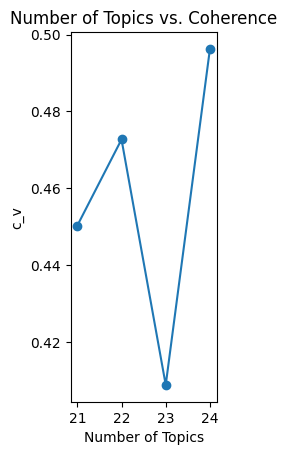

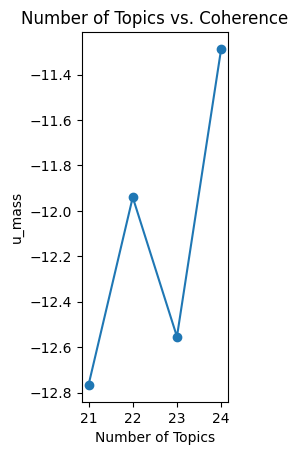

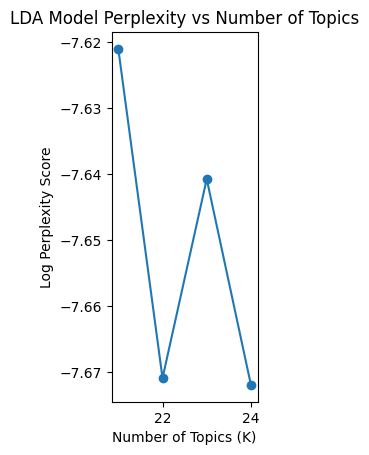

In [ ]:
reviews_w_ngrams = pd.DataFrame(amazon_df_dsa_bj.cleaned_review.copy())
reviews_w_ngrams.cleaned_review = reviews_w_ngrams.cleaned_review.map(lambda x: replace_ngram(x) if isinstance(x, str) else x)

# tokenize reviews + remove stop words + remove names + remove words with less than 2 characters
reviews_w_ngrams = reviews_w_ngrams.cleaned_review.map(lambda x: [word for word in x.split() if word not in stop_words and len(word) > 2] if isinstance(x, str) else x)
reviews_w_ngrams.dropna(axis=0, inplace=True)
reviews_w_ngrams.isnull().sum()

final_reviews = reviews_w_ngrams
final_reviews.dropna(axis=0, inplace=True)

dictionary = corpora.Dictionary(final_reviews)
doc_term_matrix = [dictionary.doc2bow(doc) for doc in final_reviews]

coherence = []
umass = []
px = []
topic_range = range(21, 25)
for k in topic_range:
    print('Round: '+str(k))
    Lda = gensim.models.ldamodel.LdaModel
    ldamodel = Lda(doc_term_matrix, num_topics=k, id2word = dictionary, passes=40,\
                   iterations=200, chunksize = 10000, eval_every = None, random_state=0)
    
    cm = gensim.models.coherencemodel.CoherenceModel(model=ldamodel, texts=final_reviews,\
                                                     dictionary=dictionary, coherence='c_v')
    mm = gensim.models.coherencemodel.CoherenceModel(model=ldamodel, texts=final_reviews,\
                                                     dictionary=dictionary, coherence='u_mass')
    coherence.append((k,cm.get_coherence()))
    umass.append((k,mm.get_coherence()))
    px.append(ldamodel.log_perplexity(doc_term_matrix))
    
    
x_val = [x[0] for x in coherence]
y_val = [x[1] for x in coherence]

x_val_u = [x[0] for x in umass]
y_val_y = [x[1] for x in umass]

plt.subplot(1,3,1)
plt.plot(x_val,y_val)
plt.scatter(x_val,y_val)
plt.title('Number of Topics vs. Coherence')
plt.xlabel('Number of Topics')
plt.ylabel('c_v')
plt.xticks(x_val)
plt.show()

plt.subplot(1,3,2)
plt.plot(x_val_u,y_val_y)
plt.scatter(x_val_u,y_val_y)
plt.title('Number of Topics vs. Coherence')
plt.xlabel('Number of Topics')
plt.ylabel('u_mass')
plt.xticks(x_val_u)
plt.show()

plt.subplot(1,3,3)
plt.plot(topic_range, px, marker='o')
plt.xlabel("Number of Topics (K)")
plt.ylabel("Log Perplexity Score")
plt.title("LDA Model Perplexity vs Number of Topics")
plt.show()

In [ ]:
for i in topic_range:
    name = 'dsa_bj'
    num = i
    Lda = gensim.models.ldamodel.LdaModel
    ldamodel = Lda(doc_term_matrix, num_topics=num, id2word = dictionary, passes=40,\
                iterations=200,  chunksize = 10000, eval_every = None, random_state=0)
    Lda2 = gensim.models.ldamodel.LdaModel
    ldamodel2 = Lda2(doc_term_matrix, num_topics=num, id2word = dictionary, passes=40,\
                iterations=200,  chunksize = 10000, eval_every = None, random_state=0)
    
    # To show initial topics
    ldamodel.show_topics(num, num_words=10, formatted=False)
    
    # To show initial topics
    ldamodel2.show_topics(num, num_words=10, formatted=False)
    
    # Visualize the topics
    pyLDAvis.enable_notebook()
    LDAvis_data_filepath = os.path.join('./results/ldavis_prepared_'+'v3_0129')
    
    # Create directory if it does not exist
    if not os.path.exists('./results'):
        os.makedirs('./results')
    LDAvis_prepared = pyLDAvis.gensim.prepare(ldamodel2, doc_term_matrix, dictionary, mds = 'pcoa')
    with open(LDAvis_data_filepath, 'wb') as f:
        pickle.dump(LDAvis_prepared, f)
        
    # load the pre-prepared pyLDAvis data from disk
    with open(LDAvis_data_filepath, 'rb') as f:
        LDAvis_prepared = pickle.load(f)
    pyLDAvis.save_html(LDAvis_prepared, './results/ldavis_prepared_'+ f'{name}_{num}' +'.html')
    display(LDAvis_prepared)
    
    topic_data = LDAvis_prepared
    all_topics = {}
    num_terms = 10  # Adjust number of words to represent each topic
    lambd = 0.6  # Adjust this accordingly based on tuning above
    for j in range(1, num + 1):  # Adjust this to reflect number of topics chosen for final LDA model
        topic = topic_data.topic_info[topic_data.topic_info.Category == 'Topic' + str(j)].copy()
        topic['relevance'] = topic['loglift'] * (1 - lambd) + topic['logprob'] * lambd
        # 리스트 길이 보정: max_length 만큼 패딩 (NaN 추가)
        terms = topic.sort_values(by='relevance', ascending=False).Term.tolist()
        all_topics['Topic ' + str(j)] = terms[:num_terms] + [None] * (num_terms - len(terms))
    lda2_test_results = pd.DataFrame.from_dict(all_topics, orient='index')
    display(lda2_test_results)

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
19    -0.098602 -0.015622       1        1  9.445590
14    -0.172107 -0.047233       2        1  8.847783
10     0.042064  0.109301       3        1  8.293439
11    -0.000622 -0.090696       4        1  7.227322
8     -0.120058  0.046451       5        1  7.207980
6      0.007223  0.006563       6        1  5.438223
3      0.041951  0.120642       7        1  4.915799
15    -0.068996 -0.056792       8        1  4.763250
1      0.059990 -0.103909       9        1  4.659180
17     0.004302  0.101956      10        1  4.473535
4      0.143164 -0.011001      11        1  4.217097
12    -0.046887  0.067183      12        1  3.875720
16    -0.014790  0.063043      13        1  3.782746
13    -0.031353 -0.076680      14        1  3.754783
0     -0.046088 -0.017230      15        1  3.699061
5     -0.041948  0.014674      16        1  3.451246
20     0.054105 -0.061103      17        1  2.835539
2      0.099828 -0.027817      18        1  2.757551
9      0.046093  0.036560      19        1  2.552300
7      0.081489 -0.046255      20        1  2.329552
18     0.061243 -0.012034      21        1  1.472302, topic_info=                     Term       Freq      Total Category  logprob  loglift
4                    face  63.000000  63.000000  Default  30.0000  30.0000
213                 smell  16.000000  16.000000  Default  29.0000  29.0000
154             sensitive  26.000000  26.000000  Default  28.0000  28.0000
508             sunscreen  16.000000  16.000000  Default  27.0000  27.0000
209             different  13.000000  13.000000  Default  26.0000  26.0000
166             irritated   7.000000   7.000000  Default  25.0000  25.0000
42                    red  20.000000  20.000000  Default  24.0000  24.0000
28                   oily   9.000000   9.000000  Default  23.0000  23.0000
574                   eye  11.000000  11.000000  Default  22.0000  22.0000
50               original   8.000000   8.000000  Default  21.0000  21.0000
193                 cream  12.000000  12.000000  Default  20.0000  20.0000
225                burned   6.000000   6.000000  Default  19.0000  19.0000
939                   oil  15.000000  15.000000  Default  18.0000  18.0000
121             recommend  18.000000  18.000000  Default  17.0000  17.0000
426               texture   9.000000   9.000000  Default  16.0000  16.0000
24                    dry  19.000000  19.000000  Default  15.0000  15.0000
108                 small   8.000000   8.000000  Default  14.0000  14.0000
172                bottle  12.000000  12.000000  Default  13.0000  13.0000
168                   bad  20.000000  20.000000  Default  12.0000  12.0000
376                 empty   7.000000   7.000000  Default  11.0000  11.0000
1113             american   5.000000   5.000000  Default  10.0000  10.0000
194                  days  13.000000  13.000000  Default   9.0000   9.0000
397                  eyes  22.000000  22.000000  Default   8.0000   8.0000
373             breakouts   5.000000   5.000000  Default   7.0000   7.0000
118              allergic  15.000000  15.000000  Default   6.0000   6.0000
951                  pump   4.000000   4.000000  Default   5.0000   5.0000
178            difference   6.000000   6.000000  Default   4.0000   4.0000
238                  acne   7.000000   7.000000  Default   3.0000   3.0000
151              horrible   8.000000   8.000000  Default   2.0000   2.0000
1                   serum   9.000000   9.000000  Default   1.0000   1.0000
703          instructions   2.442135   3.075312   Topic1  -4.6924   2.1291
932             dishonest   1.640794   2.273970   Topic1  -5.0900   2.0333
941               serious   1.640794   2.273970   Topic1  -5.0900   2.0333
704              remember   1.640794   2.273970   Topic1  -5.0900   2.0333
705               retinal   1.640794   2.273970   Topic1  -5.0900   2.0333
53                replace   1.640793  

,0,1,2,3,4,5,6,7,8,9
Topic 1,cleanser,eyes,instructions,legs,bumps,coconut,texture,dishonest,refund,contents
Topic 2,allergic,description,rashes,oil,reviews,water,red,bad,routine,googlereddit
Topic 3,meant,sunscreen,masks,face,niacin,2024,affect,europe,compared,large
Topic 4,retinol,hand,allergy,eye,scent,perfume,prime,zero,expired,pictures
Topic 5,burning,face,applied,addition,cream,sensitive,red,heard,recommend,dry
Topic 6,toxic,wasted,crust,cerave,difference,truth,notice,burns,night,lightweight
Topic 7,empty,bottle,leak,hydrating,toner,happened,long,everyday,peach,wish
Topic 8,clenser,damaged,threw,surprised,oil,rash,redness,medical,josen,tiktok
Topic 9,pump,different,disappointed,lid,originally,wrinkles,ideal,extreme,entirety,directly
Topic 10,face,guessing,watery,whiteheads,consistency,excited,size,things,worst,nose


PreparedData(topic_coordinates=                  x         y  topics  cluster       Freq
topic                                                    
14    -1.958400e-01 -0.080265       1        1  10.635496
19     8.936028e-02 -0.018021       2        1   7.689898
3      7.592619e-03 -0.139606       3        1   6.207444
5     -2.314075e-02 -0.032304       4        1   6.084954
11     1.288526e-02  0.089910       5        1   5.742515
2      1.402402e-01 -0.109233       6        1   5.137069
6     -5.782101e-07 -0.044046       7        1   4.929849
16    -3.604912e-02  0.083778       8        1   4.807826
1      1.702347e-02 -0.021069       9        1   4.765893
10    -2.279547e-02 -0.021091      10        1   4.591150
12    -4.299765e-02  0.098538      11        1   4.524385
4      1.033289e-01 -0.014813      12        1   4.349014
17    -6.269202e-02 -0.008350      13        1   4.151829
9     -3.573518e-03 -0.035992      14        1   4.020041
20     1.231714e-02 -0.028603      15        1   3.855903
7     -4.124019e-02 -0.012959      16        1   3.423094
0      6.178353e-02  0.081311      17        1   2.766545
13     3.183078e-02  0.106676      18        1   2.748881
15    -4.017788e-02  0.015841      19        1   2.548036
8     -3.113157e-02  0.015018      20        1   2.512671
18     1.179917e-02  0.050083      21        1   2.497831
21     1.147729e-02  0.025195      22        1   2.009675, topic_info=                     Term       Freq      Total Category  logprob  loglift
213                 smell  17.000000  17.000000  Default  30.0000  30.0000
4                    face  63.000000  63.000000  Default  29.0000  29.0000
508             sunscreen  16.000000  16.000000  Default  28.0000  28.0000
121             recommend  18.000000  18.000000  Default  27.0000  27.0000
154             sensitive  26.000000  26.000000  Default  26.0000  26.0000
209             different  14.000000  14.000000  Default  25.0000  25.0000
397                  eyes  21.000000  21.000000  Default  24.0000  24.0000
193                 cream  12.000000  12.000000  Default  23.0000  23.0000
225                burned   5.000000   5.000000  Default  22.0000  22.0000
168                   bad  18.000000  18.000000  Default  21.0000  21.0000
939                   oil  15.000000  15.000000  Default  20.0000  20.0000
118              allergic  15.000000  15.000000  Default  19.0000  19.0000
542              cleanser   8.000000   8.000000  Default  18.0000  18.0000
42                    red  20.000000  20.000000  Default  17.0000  17.0000
574                   eye  10.000000  10.000000  Default  16.0000  16.0000
151              horrible   8.000000   8.000000  Default  15.0000  15.0000
46           disappointed   8.000000   8.000000  Default  14.0000  14.0000
440              happened   5.000000   5.000000  Default  13.0000  13.0000
172                bottle  12.000000  12.000000  Default  12.0000  12.0000
373             breakouts   5.000000   5.000000  Default  11.0000  11.0000
376                 empty   8.000000   8.000000  Default  10.0000  10.0000
28                   oily   9.000000   9.000000  Default   9.0000   9.0000
166             irritated   7.000000   7.000000  Default   8.0000   8.0000
136               reviews  10.000000  10.000000  Default   7.0000   7.0000
1113             american   6.000000   6.000000  Default   6.0000   6.0000
70                 smells   7.000000   7.000000  Default   5.0000   5.0000
113           description   7.000000   7.000000  Default   4.0000   4.0000
839                 scent   5.000000   5.000000  Default   3.0000   3.0000
212                  past   5.000000   5.000000  Default   2.0000   2.0000
485                 bumps   8.000000   8.000000  Default   1.0000   1.0000
211                 dirty   2.510751   3.151597   Topic1  -4.7833   2.0136
113           description   5.808532   7.794875   Topic1  -3.9445   1.9468
266                affect   1.686314   2.327160   Topic1  -5.1813   1.9189
282            

,0,1,2,3,4,5,6,7,8,9
Topic 1,description,reviews,allergic,rashes,face,dirty,red,america,googlereddit,life
Topic 2,smells,oil,website,coconut,texture,completely,dishonest,ago,matte,serious
Topic 3,empty,bottle,leak,oily,face,black,improvement,days,package,hydrating
Topic 4,retinol,sensitive,burning,tube,expired,acne,opposite,wash,bottle,days
Topic 5,scent,perfume,scared,rubbing,crust,pictures,difference,crying,read,hand
Topic 6,different,disappointed,clenser,small,light_weight,cystic,weird,oil,zits,missing
Topic 7,instructions,structure,remember,retinal,extreme,ideal,lid,originally,authenticity,scan
Topic 8,experience,eye,raw,itchy,sensitive,filters,uses,turned,spf,company
Topic 9,damaged,replace,request,whiteheads,patches,glow,replacement,redness,nose,chin
Topic 10,horrible,meant,price,europe,compared,sunscreen,swollen,sunscreens,four,morning


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
14     0.207733 -0.065614       1        1  8.620412
2      0.008894  0.115304       2        1  7.058822
19     0.126217  0.097953       3        1  6.444312
5      0.028197 -0.115462       4        1  5.785551
8      0.108265 -0.084116       5        1  5.651714
17    -0.073141  0.003892       6        1  5.548676
13    -0.124945 -0.060795       7        1  5.258918
11    -0.017331  0.088385       8        1  4.439560
15    -0.045753 -0.048677       9        1  4.393248
9     -0.081301 -0.043283      10        1  4.362010
3     -0.075147  0.027842      11        1  4.302214
12    -0.020861  0.008556      12        1  4.160358
18     0.023244 -0.013637      13        1  3.956651
20     0.068565  0.070067      14        1  3.929578
4     -0.019166  0.126785      15        1  3.799498
6     -0.017297 -0.006163      16        1  3.783711
0     -0.033316 -0.044211      17        1  3.416946
16    -0.008613 -0.030677      18        1  3.342800
10    -0.047537  0.052661      19        1  3.310412
1     -0.025431  0.011507      20        1  2.803579
7     -0.022252 -0.094441      21        1  2.620168
22     0.013779 -0.002265      22        1  1.696981
21     0.027196  0.006389      23        1  1.313882, topic_info=                     Term       Freq      Total Category  logprob  loglift
4                    face  63.000000  63.000000  Default  30.0000  30.0000
213                 smell  19.000000  19.000000  Default  29.0000  29.0000
42                    red  19.000000  19.000000  Default  28.0000  28.0000
508             sunscreen  16.000000  16.000000  Default  27.0000  27.0000
118              allergic  15.000000  15.000000  Default  26.0000  26.0000
154             sensitive  26.000000  26.000000  Default  25.0000  25.0000
397                  eyes  22.000000  22.000000  Default  24.0000  24.0000
939                   oil  15.000000  15.000000  Default  23.0000  23.0000
178            difference   6.000000   6.000000  Default  22.0000  22.0000
24                    dry  19.000000  19.000000  Default  21.0000  21.0000
376                 empty   7.000000   7.000000  Default  20.0000  20.0000
256               pimples   9.000000   9.000000  Default  19.0000  19.0000
574                   eye  10.000000  10.000000  Default  18.0000  18.0000
209             different  14.000000  14.000000  Default  17.0000  17.0000
121             recommend  18.000000  18.000000  Default  16.0000  16.0000
194                  days  13.000000  13.000000  Default  15.0000  15.0000
1                   serum  10.000000  10.000000  Default  14.0000  14.0000
172                bottle  12.000000  12.000000  Default  13.0000  13.0000
193                 cream  12.000000  12.000000  Default  12.0000  12.0000
168                   bad  19.000000  19.000000  Default  11.0000  11.0000
166             irritated   7.000000   7.000000  Default  10.0000  10.0000
225                burned   6.000000   6.000000  Default   9.0000   9.0000
28                   oily   9.000000   9.000000  Default   8.0000   8.0000
91                 sticky   7.000000   7.000000  Default   7.0000   7.0000
542              cleanser   8.000000   8.000000  Default   6.0000   6.0000
136               reviews  10.000000  10.000000  Default   5.0000   5.0000
141              anything  10.000000  10.000000  Default   4.0000   4.0000
485                 bumps   8.000000   8.000000  Default   3.0000   3.0000
70                 smells   8.000000   8.000000  Default   2.0000   2.0000
130               burning  10.000000  10.000000  Default   1.0000   1.0000
266                affect   1.671527   2.314131   Topic1  -4.9801   2.1257
282                niacin   1.671527   2.314131   Topic1  -4.9801   2.1257
299            aggressive   1.671527   2.314131   Topic1  -4.9801   2.1257
449                 353oz   1.671526   2.314130   Topic1  -4.9801   2.1257
771    

,0,1,2,3,4,5,6,7,8,9
Topic 1,allergic,disappointed,description,reviews,rashes,affect,aggressive,353oz,america,googlereddit
Topic 2,smell,different,horrible,scent,cystic,toxic,perfume,concentration,days,weird
Topic 3,smells,cleanser,oil,coconut,serious,dishonest,wrinkles,refund,ginseng,passed
Topic 4,sensitive,instructions,retinal,everyday,remember,difference,days,daily,whiteheads,wish
Topic 5,burning,face,prime,wasted,receive,dirty,painful,cleanser,recommend,woke
Topic 6,face,burned,half,replacement,masks,heal,replace,request,awful,current
Topic 7,eyes,recommend,retinol,cream,irritated,delicate,luck,watery,told,consistency
Topic 8,legs,europe,beware,pictures,compared,original,sunscreens,fda,sunscreen,medication
Topic 9,damaged,itchiness,improvement,afraid,moisturizer,lightweight,redness,dry,red,step
Topic 10,sunscreen,interested,mascara,hydrated,formulation,face,masks,long,although,sounds


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
19     0.147779  0.023242       1        1  8.623802
14     0.014096  0.092002       2        1  8.129865
3     -0.142703  0.079098       3        1  6.738861
8     -0.100190  0.010676       4        1  6.403403
11     0.090524 -0.172830       5        1  6.167191
17    -0.067241 -0.092852       6        1  6.065823
12    -0.083667 -0.033542       7        1  4.951438
0      0.027319  0.143884       8        1  4.140599
15    -0.058967 -0.035689       9        1  4.079932
5     -0.092444 -0.017118      10        1  3.930650
4      0.059633 -0.008061      11        1  3.906200
21     0.013822  0.000998      12        1  3.749156
2      0.080900 -0.075801      13        1  3.658923
20     0.023352  0.013081      14        1  3.647789
23     0.070500  0.016634      15        1  3.477553
16    -0.044563 -0.071838      16        1  3.388275
6      0.009204  0.060634      17        1  3.343832
1      0.045131  0.076356      18        1  2.898945
13     0.057756  0.039721      19        1  2.622609
18    -0.034848 -0.043070      20        1  2.337720
9     -0.021466 -0.019454      21        1  2.281495
7     -0.041668 -0.000151      22        1  2.244757
10     0.022446  0.019722      23        1  2.021213
22     0.025295 -0.005642      24        1  1.189968, topic_info=                     Term       Freq      Total Category  logprob  loglift
4                    face  63.000000  63.000000  Default  30.0000  30.0000
213                 smell  18.000000  18.000000  Default  29.0000  29.0000
939                   oil  15.000000  15.000000  Default  28.0000  28.0000
209             different  14.000000  14.000000  Default  27.0000  27.0000
42                    red  19.000000  19.000000  Default  26.0000  26.0000
508             sunscreen  16.000000  16.000000  Default  25.0000  25.0000
574                   eye  11.000000  11.000000  Default  24.0000  24.0000
24                    dry  19.000000  19.000000  Default  23.0000  23.0000
154             sensitive  26.000000  26.000000  Default  22.0000  22.0000
256               pimples   9.000000   9.000000  Default  21.0000  21.0000
121             recommend  18.000000  18.000000  Default  20.0000  20.0000
485                 bumps   7.000000   7.000000  Default  19.0000  19.0000
28                   oily   9.000000   9.000000  Default  18.0000  18.0000
130               burning  10.000000  10.000000  Default  17.0000  17.0000
397                  eyes  21.000000  21.000000  Default  16.0000  16.0000
118              allergic  14.000000  14.000000  Default  15.0000  15.0000
234                 heard   7.000000   7.000000  Default  14.0000  14.0000
194                  days  12.000000  12.000000  Default  13.0000  13.0000
376                 empty   7.000000   7.000000  Default  12.0000  12.0000
151              horrible   8.000000   8.000000  Default  11.0000  11.0000
225                burned   6.000000   6.000000  Default  10.0000  10.0000
141              anything  10.000000  10.000000  Default   9.0000   9.0000
136               reviews  10.000000  10.000000  Default   8.0000   8.0000
542              cleanser   8.000000   8.000000  Default   7.0000   7.0000
172                bottle  12.000000  12.000000  Default   6.0000   6.0000
91                 sticky   8.000000   8.000000  Default   5.0000   5.0000
426               texture   9.000000   9.000000  Default   4.0000   4.0000
193                 cream  13.000000  13.000000  Default   3.0000   3.0000
503                   day   8.000000   8.000000  Default   2.0000   2.0000
189                 worth   5.000000   5.000000  Default   1.0000   1.0000
930               coconut   4.070466   4.709068   Topic1  -4.0904   2.3049
932             dishonest   1.648346   2.286947   Topic1  -4.9944   2.1232
941               serious   1.648346   2.286947   Topic1  -4.9944   2.1232
956             cleansing   1

,0,1,2,3,4,5,6,7,8,9
Topic 1,coconut,oil,smells,cleanser,old,changed,damaged,passed,ginseng,serious
Topic 2,face,description,affect,aggressive,353oz,cystic,peach,afraid,niacin,obviously
Topic 3,puffy,eyes,red,burning,dry,legs,woke,oily,breakouts,tube
Topic 4,cream,retinol,structure,face,painful,red,uses,gentle,breakouts,recommend
Topic 5,smell,scent,perfume,scared,prime,pictures,sunscreen,cheap,receive,realized
Topic 6,burned,face,washed,europe,request,addition,figure,replace,glad,compared
Topic 7,face,lightweight,itchy,raw,spread,bumps,normal,water,dry,routines
Topic 8,days,pump,truth,contact,acne,pimples,dermatitis,within,huge,worth
Topic 9,rashes,reviews,heard,googlereddit,suppose,america,life,negative,allergic,influencers
Topic 10,horrible,doctor,cleanse,surprised,standards,double,read,opposite,greasy,sensitive


###### I'm from

Round: 21
Round: 22
Round: 23
Round: 24


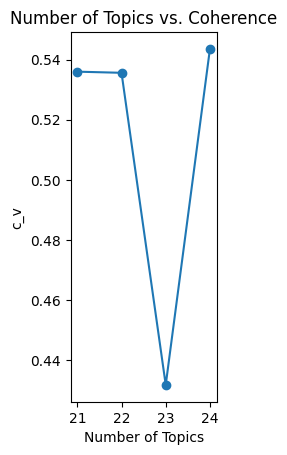

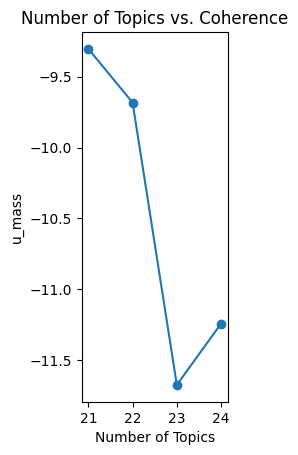

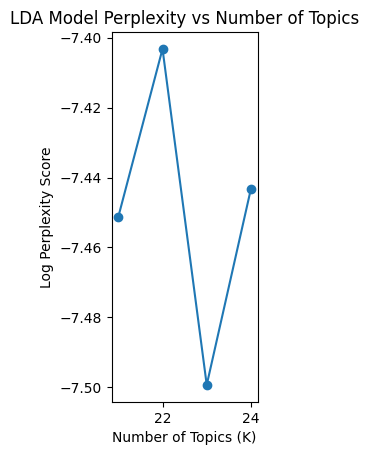

In [ ]:
reviews_w_ngrams = pd.DataFrame(amazon_df_dsa_if.cleaned_review.copy())
reviews_w_ngrams.cleaned_review = reviews_w_ngrams.cleaned_review.map(lambda x: replace_ngram(x) if isinstance(x, str) else x)

# tokenize reviews + remove stop words + remove names + remove words with less than 2 characters
reviews_w_ngrams = reviews_w_ngrams.cleaned_review.map(lambda x: [word for word in x.split() if word not in stop_words and len(word) > 2] if isinstance(x, str) else x)
reviews_w_ngrams.dropna(axis=0, inplace=True)
reviews_w_ngrams.isnull().sum()

final_reviews = reviews_w_ngrams
final_reviews.dropna(axis=0, inplace=True)

dictionary = corpora.Dictionary(final_reviews)
doc_term_matrix = [dictionary.doc2bow(doc) for doc in final_reviews]

coherence = []
umass = []
px = []
topic_range = range(21, 25)
for k in topic_range:
    print('Round: '+str(k))
    Lda = gensim.models.ldamodel.LdaModel
    ldamodel = Lda(doc_term_matrix, num_topics=k, id2word = dictionary, passes=40,\
                   iterations=200, chunksize = 10000, eval_every = None, random_state=0)
    
    cm = gensim.models.coherencemodel.CoherenceModel(model=ldamodel, texts=final_reviews,\
                                                     dictionary=dictionary, coherence='c_v')
    mm = gensim.models.coherencemodel.CoherenceModel(model=ldamodel, texts=final_reviews,\
                                                     dictionary=dictionary, coherence='u_mass')
    coherence.append((k,cm.get_coherence()))
    umass.append((k,mm.get_coherence()))
    px.append(ldamodel.log_perplexity(doc_term_matrix))
    
    
x_val = [x[0] for x in coherence]
y_val = [x[1] for x in coherence]

x_val_u = [x[0] for x in umass]
y_val_y = [x[1] for x in umass]

plt.subplot(1,3,1)
plt.plot(x_val,y_val)
plt.scatter(x_val,y_val)
plt.title('Number of Topics vs. Coherence')
plt.xlabel('Number of Topics')
plt.ylabel('c_v')
plt.xticks(x_val)
plt.show()

plt.subplot(1,3,2)
plt.plot(x_val_u,y_val_y)
plt.scatter(x_val_u,y_val_y)
plt.title('Number of Topics vs. Coherence')
plt.xlabel('Number of Topics')
plt.ylabel('u_mass')
plt.xticks(x_val_u)
plt.show()

plt.subplot(1,3,3)
plt.plot(topic_range, px, marker='o')
plt.xlabel("Number of Topics (K)")
plt.ylabel("Log Perplexity Score")
plt.title("LDA Model Perplexity vs Number of Topics")
plt.show()

In [ ]:
for i in topic_range:
    name = 'dsa_if'
    num = i
    Lda = gensim.models.ldamodel.LdaModel
    ldamodel = Lda(doc_term_matrix, num_topics=num, id2word = dictionary, passes=40,\
                iterations=200,  chunksize = 10000, eval_every = None, random_state=0)
    Lda2 = gensim.models.ldamodel.LdaModel
    ldamodel2 = Lda2(doc_term_matrix, num_topics=num, id2word = dictionary, passes=40,\
                iterations=200,  chunksize = 10000, eval_every = None, random_state=0)
    
    # To show initial topics
    ldamodel.show_topics(num, num_words=10, formatted=False)
    
    # To show initial topics
    ldamodel2.show_topics(num, num_words=10, formatted=False)
    
    # Visualize the topics
    pyLDAvis.enable_notebook()
    LDAvis_data_filepath = os.path.join('./results/ldavis_prepared_'+'v3_0129')
    
    # Create directory if it does not exist
    if not os.path.exists('./results'):
        os.makedirs('./results')
    LDAvis_prepared = pyLDAvis.gensim.prepare(ldamodel2, doc_term_matrix, dictionary, mds = 'pcoa')
    with open(LDAvis_data_filepath, 'wb') as f:
        pickle.dump(LDAvis_prepared, f)
        
    # load the pre-prepared pyLDAvis data from disk
    with open(LDAvis_data_filepath, 'rb') as f:
        LDAvis_prepared = pickle.load(f)
    pyLDAvis.save_html(LDAvis_prepared, './results/ldavis_prepared_'+ f'{name}_{num}' +'.html')
    display(LDAvis_prepared)
    
    topic_data = LDAvis_prepared
    all_topics = {}
    num_terms = 10  # Adjust number of words to represent each topic
    lambd = 0.6  # Adjust this accordingly based on tuning above
    for j in range(1, num + 1):  # Adjust this to reflect number of topics chosen for final LDA model
        topic = topic_data.topic_info[topic_data.topic_info.Category == 'Topic' + str(j)].copy()
        topic['relevance'] = topic['loglift'] * (1 - lambd) + topic['logprob'] * lambd
        # 리스트 길이 보정: max_length 만큼 패딩 (NaN 추가)
        terms = topic.sort_values(by='relevance', ascending=False).Term.tolist()
        all_topics['Topic ' + str(j)] = terms[:num_terms] + [None] * (num_terms - len(terms))
    lda2_test_results = pd.DataFrame.from_dict(all_topics, orient='index')
    display(lda2_test_results)

PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
7     -0.037941 -0.179464       1        1  11.064655
19    -0.148200  0.106823       2        1   9.762852
2      0.049308  0.132983       3        1   7.435702
3     -0.173799  0.039795       4        1   7.318053
9      0.139335  0.089679       5        1   6.944931
13     0.087045  0.079790       6        1   6.570820
20     0.013729 -0.015504       7        1   5.714098
18     0.097782 -0.030042       8        1   4.838151
10    -0.067550 -0.000184       9        1   4.671567
11     0.021065 -0.087222      10        1   4.573379
17    -0.024125  0.010030      11        1   4.356285
5     -0.024312  0.025026      12        1   3.668820
15    -0.008335  0.028501      13        1   3.647025
12     0.036508 -0.014703      14        1   3.631706
16    -0.035657 -0.007802      15        1   3.124751
6     -0.014519 -0.031151      16        1   2.815188
0      0.082100 -0.044983      17        1   2.664591
4     -0.019278 -0.013731      18        1   2.504342
1      0.006800 -0.035583      19        1   1.705644
8      0.019577 -0.025902      20        1   1.604647
14     0.000467 -0.026357      21        1   1.382794, topic_info=                       Term       Freq      Total Category  logprob  loglift
17                   bottle  11.000000  11.000000  Default  30.0000  30.0000
100                    face  37.000000  37.000000  Default  29.0000  29.0000
99                      dry  16.000000  16.000000  Default  28.0000  28.0000
199               sensitive  21.000000  21.000000  Default  27.0000  27.0000
149                allergic   9.000000   9.000000  Default  26.0000  26.0000
537                   small   9.000000   9.000000  Default  25.0000  25.0000
46                    smell  14.000000  14.000000  Default  24.0000  24.0000
152                    help   6.000000   6.000000  Default  23.0000  23.0000
5                     scent  10.000000  10.000000  Default  22.0000  22.0000
338                   price   6.000000   6.000000  Default  21.0000  21.0000
407                   cream  10.000000  10.000000  Default  20.0000  20.0000
20                   sticky   9.000000   9.000000  Default  19.0000  19.0000
156                    oily   7.000000   7.000000  Default  18.0000  18.0000
11                      bad   8.000000   8.000000  Default  17.0000  17.0000
198                     red   8.000000   8.000000  Default  16.0000  16.0000
255                   worth   7.000000   7.000000  Default  15.0000  15.0000
366                     day   8.000000   8.000000  Default  14.0000  14.0000
324            instructions   3.000000   3.000000  Default  13.0000  13.0000
35                    itchy   6.000000   6.000000  Default  12.0000  12.0000
238              difference   6.000000   6.000000  Default  11.0000  11.0000
78                  excited   5.000000   5.000000  Default  10.0000  10.0000
16                 returned   4.000000   4.000000  Default   9.0000   9.0000
811                    size   5.000000   5.000000  Default   8.0000   8.0000
478                   toner   6.000000   6.000000  Default   7.0000   7.0000
207                 ginseng   4.000000   4.000000  Default   6.0000   6.0000
274               different   5.000000   5.000000  Default   5.0000   5.0000
432                 mugwort   7.000000   7.000000  Default   4.0000   4.0000
163            moisturizing   3.000000   3.000000  Default   3.0000   3.0000
15                   refund   3.000000   3.000000  Default   2.0000   2.0000
309                anything   6.000000   6.000000  Default   1.0000   1.0000
73                container   2.484208   3.069836   Topic1  -4.4175   1.9897
720                  orange   2.484208   3.069836   Topic1  -4.4175   1.9897
341                  tasted   2.484208   3.069836   Topic1  -4.4175   1.9897
699                cleanser   1.669066   2.254693   Topic1  -4.8152   1.9007
716                m

,0,1,2,3,4,5,6,7,8,9
Topic 1,honey,acne,container,tasted,orange,bottom,cleanser,mandarin,rather,leaking
Topic 2,watery,issue,complexion,moisturizer,face,turned,company,pores,sensitive,returning
Topic 3,small,face,day,expensive,tightness,light,red,tiny,completely,smooth
Topic 4,scents,thin,melt,reviews,expecting,mugwort,sensitive,bumps,watery,moisturizer
Topic 5,sticky,eyes,cream,expensive,zero,calming,absorb,swollen,washed,woke
Topic 6,smell,cream,bottom,different,seal,packaging,dry,real,sealed,lid
Topic 7,bottle,excellent,face,properly,days,longer,essence,different,smell,cosmetic
Topic 8,scent,difference,floral,paid,beneficial,powdery,whatsoever,wish,bumps,smells
Topic 9,price,worth,size,color,water,hydration,face,suppose,tags,versions
Topic 10,help,read,forehead,description,present,pretty,anything,youd,dermatologist,heads


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
16    -0.177283  0.154618       1        1  12.176790
7     -0.058832 -0.116328       2        1   8.474395
10    -0.061112  0.075440       3        1   7.947060
2      0.079463  0.131965       4        1   7.553965
9      0.101117  0.106970       5        1   6.522839
19    -0.096351 -0.025087       6        1   4.794343
12     0.043106 -0.030741       7        1   4.780051
0      0.104621 -0.017577       8        1   4.718175
17    -0.073118 -0.003121       9        1   4.645312
4     -0.018699 -0.085579      10        1   4.631545
20     0.059727  0.013623      11        1   4.576767
21     0.116592  0.010431      12        1   4.221773
11    -0.000476 -0.128303      13        1   4.047221
14    -0.037848 -0.005238      14        1   3.500856
13     0.033877  0.036732      15        1   3.441643
1      0.016243 -0.011951      16        1   2.564029
3     -0.030523 -0.010090      17        1   2.253467
15     0.021898 -0.033305      18        1   2.169625
8     -0.002318 -0.015873      19        1   2.090900
6      0.009204 -0.022864      20        1   1.794945
5     -0.026871  0.000346      21        1   1.644907
18    -0.002420 -0.024068      22        1   1.449391, topic_info=                     Term       Freq      Total Category  logprob  loglift
199             sensitive  21.000000  21.000000  Default  30.0000  30.0000
17                 bottle  11.000000  11.000000  Default  29.0000  29.0000
100                  face  38.000000  38.000000  Default  28.0000  28.0000
255                 worth   7.000000   7.000000  Default  27.0000  27.0000
537                 small   9.000000   9.000000  Default  26.0000  26.0000
99                    dry  17.000000  17.000000  Default  25.0000  25.0000
46                  smell  13.000000  13.000000  Default  24.0000  24.0000
198                   red   7.000000   7.000000  Default  23.0000  23.0000
238            difference   5.000000   5.000000  Default  22.0000  22.0000
5                   scent   9.000000   9.000000  Default  21.0000  21.0000
407                 cream   9.000000   9.000000  Default  20.0000  20.0000
372               essence   9.000000   9.000000  Default  19.0000  19.0000
432               mugwort   8.000000   8.000000  Default  18.0000  18.0000
20                 sticky   9.000000   9.000000  Default  17.0000  17.0000
11                    bad   9.000000   9.000000  Default  16.0000  16.0000
338                 price   7.000000   7.000000  Default  15.0000  15.0000
23           disappointed   9.000000   9.000000  Default  14.0000  14.0000
50                   acne   9.000000   9.000000  Default  13.0000  13.0000
149              allergic  11.000000  11.000000  Default  12.0000  12.0000
152                  help   6.000000   6.000000  Default  11.0000  11.0000
78                excited   5.000000   5.000000  Default  10.0000  10.0000
366                   day   7.000000   7.000000  Default   9.0000   9.0000
233                bottom   4.000000   4.000000  Default   8.0000   8.0000
2                   honey   7.000000   7.000000  Default   7.0000   7.0000
193                 serum   3.000000   3.000000  Default   6.0000   6.0000
274             different   5.000000   5.000000  Default   5.0000   5.0000
160             expensive   5.000000   5.000000  Default   4.0000   4.0000
269               reviews   6.000000   6.000000  Default   3.0000   3.0000
324          instructions   4.000000   4.000000  Default   2.0000   2.0000
281             recommend   5.000000   5.000000  Default   1.0000   1.0000
448                  thin   3.387989   3.972730   Topic1  -4.2030   1.9464
500                pollen   2.550506   3.135241   Topic1  -4.4869   1.8992
490                 birch   1.713013   2.297748   Topic1  -4.8850   1.8120
352         effectiveness   1.713010   2.297746   Topic1  -4.8850   1.8120
413                drippy   1.713010

,0,1,2,3,4,5,6,7,8,9
Topic 1,allergic,mugwort,watery,sensitive,thin,original,pollen,thicker,cocoa,reliable
Topic 2,orange,acne,bottom,soft,cleanser,rather,mandarin,spatula,disgusting,face
Topic 3,price,worth,tasted,honey,sensation,size,warm,sensitive,face,water
Topic 4,thick,face,melt,essence,tight,cream,tightness,sad,worth,expect
Topic 5,eyes,cream,expensive,color,calming,washed,swollen,careful,woke,night
Topic 6,stayed,face,sensitive,instead,filling,pain,wrong,hours,dust,waged
Topic 7,scents,excellent,seller,properly,refund,believe,normaldry,layers,necessarily,finding
Topic 8,black,smelled,fake,acne,sticky,real,expensive,cloying,writing,loose
Topic 9,leaking,bad,seal,dry,eaten,traumatize,free,dupe,grease,brazened
Topic 10,instructions,zero,empty,fragrance,bumps,reordering,extract,hooked,joke,opinion


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
7     -0.173728  0.045113       1        1  10.376522
3      0.185494 -0.042932       2        1  10.023102
20    -0.053658 -0.176566       3        1   8.332184
19     0.000513  0.143444       4        1   6.720938
18    -0.010073 -0.152037       5        1   6.518437
11    -0.052140  0.006739       6        1   6.139626
6      0.040318  0.050243       7        1   5.393039
16     0.156897 -0.028601       8        1   5.323409
0     -0.087043 -0.060275       9        1   4.991102
12    -0.031415 -0.013174      10        1   4.637891
1      0.023302  0.013004      11        1   3.970883
21    -0.020502  0.074313      12        1   3.743346
9      0.021202  0.081100      13        1   3.379638
2     -0.026662  0.026492      14        1   3.336951
10     0.014599  0.053194      15        1   2.945712
5      0.014375  0.022217      16        1   2.216632
4     -0.000994 -0.001030      17        1   2.072644
17     0.014216  0.030884      18        1   2.018262
22    -0.004050 -0.049171      19        1   1.887509
15    -0.005909  0.011872      20        1   1.630403
13    -0.004584 -0.031506      21        1   1.474413
8      0.014381  0.007754      22        1   1.449813
14    -0.014540 -0.011080      23        1   1.417544, topic_info=                          Term       Freq      Total Category  logprob  \
100                       face  36.000000  36.000000  Default  30.0000   
17                      bottle  13.000000  13.000000  Default  29.0000   
99                         dry  16.000000  16.000000  Default  28.0000   
46                       smell  13.000000  13.000000  Default  27.0000   
149                   allergic  10.000000  10.000000  Default  26.0000   
20                      sticky   8.000000   8.000000  Default  25.0000   
199                  sensitive  21.000000  21.000000  Default  24.0000   
338                      price   6.000000   6.000000  Default  23.0000   
238                 difference   6.000000   6.000000  Default  22.0000   
537                      small  10.000000  10.000000  Default  21.0000   
11                         bad   8.000000   8.000000  Default  20.0000   
366                        day   7.000000   7.000000  Default  19.0000   
5                        scent  10.000000  10.000000  Default  18.0000   
255                      worth   7.000000   7.000000  Default  17.0000   
407                      cream   9.000000   9.000000  Default  16.0000   
198                        red   8.000000   8.000000  Default  15.0000   
372                    essence  10.000000  10.000000  Default  14.0000   
309                   anything   6.000000   6.000000  Default  13.0000   
23                disappointed   9.000000   9.000000  Default  12.0000   
52                   breakouts   4.000000   4.000000  Default  11.0000   
35                       itchy   6.000000   6.000000  Default  10.0000   
274                  different   5.000000   5.000000  Default   9.0000   
78                     excited   6.000000   6.000000  Default   8.0000   
223                   properly   3.000000   3.000000  Default   7.0000   
40                        half   2.000000   2.000000  Default   6.0000   
478                      toner   7.000000   7.000000  Default   5.0000   
324               instructions   4.000000   4.000000  Default   4.0000   
267                       read   4.000000   4.000000  Default   3.0000   
156                       oily   8.000000   8.000000  Default   2.0000   
15                      refund   3.000000   3.000000  Default   1.0000   
720                     orange   2.525271   3.103653   Topic1  -4.3369   
73                   container   2.525271   3.103653   Topic1  -4.3369   
341                     tasted   2.525270   3.103652   Topic1  -4.3369   
699                   cleanser   1.695528   2.273910   Topic1  -4.7353   
716              

,0,1,2,3,4,5,6,7,8,9
Topic 1,honey,orange,tasted,container,instead,cleanser,mandarin,rather,leaking,warm
Topic 2,eyes,thin,hydration,moisturizer,swollen,water,dry,mugwort,wouldnt,woke
Topic 3,bottle,smell,small,essence,sticky,face,different,tightness,day,mugwort
Topic 4,scents,sensitive,face,fire,instantly,advertised,stayed,moisture,red,bottom
Topic 5,washed,irritated,horrible,mixed,paid,calming,whatsoever,worth,benefit,days
Topic 6,scent,wish,beneficial,powdery,floral,helped,forehead,anything,help,ginseng
Topic 7,allergic,instructions,pollen,expired,birch,often,hives,fragrance,dry,itchy
Topic 8,watery,expectations,turned,company,returning,thicker,original,implore,diligently,shares
Topic 9,perfume,real,read,description,fake,scent,different,prepared,overwhelming,fragrance_free
Topic 10,melt,disgusting,spatula,empty,opening,hydrating,bad,refund,returned,bottom


PreparedData(topic_coordinates=              x         y  topics  cluster       Freq
topic                                                
16    -0.222131  0.120656       1        1  11.010782
19    -0.059029 -0.171927       2        1   7.984877
7     -0.066110 -0.081842       3        1   7.360717
20    -0.106579 -0.090172       4        1   7.195079
8      0.075852  0.137855       5        1   6.616446
10    -0.089584  0.083694       6        1   5.478855
18     0.033988 -0.076894       7        1   5.385497
2     -0.007151  0.042629       8        1   5.297118
6     -0.008614  0.060112       9        1   4.920311
11    -0.000780 -0.065336      10        1   4.431926
9      0.005455  0.002202      11        1   4.315803
5     -0.008761 -0.028463      12        1   4.064895
17    -0.038406  0.001783      13        1   3.766772
0      0.082240 -0.036111      14        1   3.407238
12     0.078210 -0.015481      15        1   3.340996
14     0.031157 -0.046169      16        1   2.935202
3      0.002117  0.017385      17        1   2.895183
13     0.062572  0.023318      18        1   1.951852
23     0.052414  0.019572      19        1   1.461411
22     0.054445  0.040393      20        1   1.428485
1      0.033516  0.023211      21        1   1.390801
15     0.033453  0.039160      22        1   1.310120
4      0.014979 -0.020635      23        1   1.061087
21     0.046746  0.021060      24        1   0.988546, topic_info=                          Term       Freq      Total Category  logprob  \
99                         dry  16.000000  16.000000  Default  30.0000   
100                       face  39.000000  39.000000  Default  29.0000   
17                      bottle  12.000000  12.000000  Default  28.0000   
238                 difference   5.000000   5.000000  Default  27.0000   
407                      cream   8.000000   8.000000  Default  26.0000   
46                       smell  13.000000  13.000000  Default  25.0000   
11                         bad   8.000000   8.000000  Default  24.0000   
255                      worth   6.000000   6.000000  Default  23.0000   
537                      small   9.000000   9.000000  Default  22.0000   
199                  sensitive  23.000000  23.000000  Default  21.0000   
156                       oily   7.000000   7.000000  Default  20.0000   
152                       help   7.000000   7.000000  Default  19.0000   
20                      sticky   8.000000   8.000000  Default  18.0000   
5                        scent  10.000000  10.000000  Default  17.0000   
372                    essence  10.000000  10.000000  Default  16.0000   
338                      price   6.000000   6.000000  Default  15.0000   
198                        red   8.000000   8.000000  Default  14.0000   
149                   allergic  10.000000  10.000000  Default  13.0000   
145                      night   4.000000   4.000000  Default  12.0000   
15                      refund   3.000000   3.000000  Default  11.0000   
50                        acne   9.000000   9.000000  Default  10.0000   
478                      toner   7.000000   7.000000  Default   9.0000   
160                  expensive   5.000000   5.000000  Default   8.0000   
309                   anything   6.000000   6.000000  Default   7.0000   
432                    mugwort   8.000000   8.000000  Default   6.0000   
2                        honey   7.000000   7.000000  Default   5.0000   
281                  recommend   5.000000   5.000000  Default   4.0000   
274                  different   5.000000   5.000000  Default   3.0000   
163               moisturizing   3.000000   3.000000  Default   2.0000   
324               instructions   4.000000   4.000000  Default   1.0000   
448                       thin   3.407630   3.981963   Topic1  -4.0966   
500                     pollen   2.564502   3.138830   Topic1  -4.3808   
418               expectations   2.564496   3.138827   Topic1  -4.3808   
490                      birch   1.72

,0,1,2,3,4,5,6,7,8,9
Topic 1,mugwort,watery,thin,allergic,pollen,expectations,moisturizer,original,thicker,failed
Topic 2,face,sensitive,tasted,honey,seal,warm,stayed,terrible,wont,sensation
Topic 3,orange,acne,bottom,rather,disgusting,spatula,cleanser,mandarin,cleansing_balm,container
Topic 4,bottle,small,essence,face,different,smell,empty,tightness,day,mugwort
Topic 5,oily,dry,returned,bad,hydrating,perfume,different,hoping,multipld,overwhelming
Topic 6,price,worth,size,color,sensitive,water,irritated,allergic,hydration,high
Topic 7,scent,floral,powdery,excited,wasted,properly,honestly,wish,smells,instead
Topic 8,red,present,itchy,toner,completely,small,package,size,awesome,exploded
Topic 9,instructions,fragrance,dry,due,live,face,serum,moderate,accumulation,body
Topic 10,help,complexion,calming,stinks,odor,counted,yeah,wait,scented,soap


###### PURITO

Round: 21
Round: 22
Round: 23
Round: 24


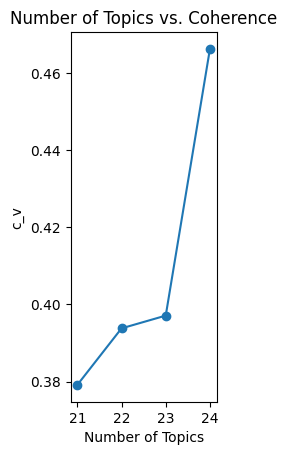

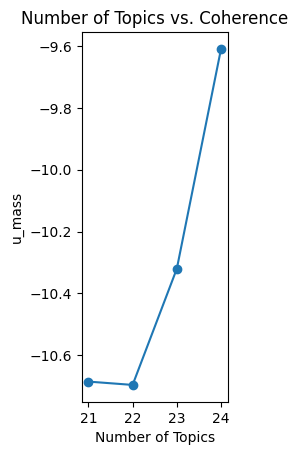

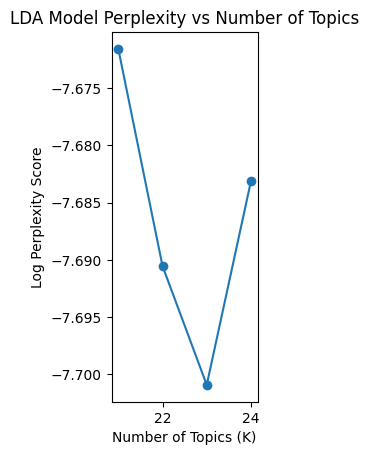

In [ ]:
reviews_w_ngrams = pd.DataFrame(amazon_df_dsa_pu.cleaned_review.copy())
reviews_w_ngrams.cleaned_review = reviews_w_ngrams.cleaned_review.map(lambda x: replace_ngram(x) if isinstance(x, str) else x)

# tokenize reviews + remove stop words + remove names + remove words with less than 2 characters
reviews_w_ngrams = reviews_w_ngrams.cleaned_review.map(lambda x: [word for word in x.split() if word not in stop_words and len(word) > 2] if isinstance(x, str) else x)
reviews_w_ngrams.dropna(axis=0, inplace=True)
reviews_w_ngrams.isnull().sum()

final_reviews = reviews_w_ngrams
final_reviews.dropna(axis=0, inplace=True)

dictionary = corpora.Dictionary(final_reviews)
doc_term_matrix = [dictionary.doc2bow(doc) for doc in final_reviews]

coherence = []
umass = []
px = []
topic_range = range(21, 25)
for k in topic_range:
    print('Round: '+str(k))
    Lda = gensim.models.ldamodel.LdaModel
    ldamodel = Lda(doc_term_matrix, num_topics=k, id2word = dictionary, passes=40,\
                   iterations=200, chunksize = 10000, eval_every = None, random_state=0)
    
    cm = gensim.models.coherencemodel.CoherenceModel(model=ldamodel, texts=final_reviews,\
                                                     dictionary=dictionary, coherence='c_v')
    mm = gensim.models.coherencemodel.CoherenceModel(model=ldamodel, texts=final_reviews,\
                                                     dictionary=dictionary, coherence='u_mass')
    coherence.append((k,cm.get_coherence()))
    umass.append((k,mm.get_coherence()))
    px.append(ldamodel.log_perplexity(doc_term_matrix))
    
    
x_val = [x[0] for x in coherence]
y_val = [x[1] for x in coherence]

x_val_u = [x[0] for x in umass]
y_val_y = [x[1] for x in umass]

plt.subplot(1,3,1)
plt.plot(x_val,y_val)
plt.scatter(x_val,y_val)
plt.title('Number of Topics vs. Coherence')
plt.xlabel('Number of Topics')
plt.ylabel('c_v')
plt.xticks(x_val)
plt.show()

plt.subplot(1,3,2)
plt.plot(x_val_u,y_val_y)
plt.scatter(x_val_u,y_val_y)
plt.title('Number of Topics vs. Coherence')
plt.xlabel('Number of Topics')
plt.ylabel('u_mass')
plt.xticks(x_val_u)
plt.show()

plt.subplot(1,3,3)
plt.plot(topic_range, px, marker='o')
plt.xlabel("Number of Topics (K)")
plt.ylabel("Log Perplexity Score")
plt.title("LDA Model Perplexity vs Number of Topics")
plt.show()

In [ ]:
for i in topic_range:
    name = 'dsa_pu'
    num = i
    Lda = gensim.models.ldamodel.LdaModel
    ldamodel = Lda(doc_term_matrix, num_topics=num, id2word = dictionary, passes=40,\
                iterations=200,  chunksize = 10000, eval_every = None, random_state=0)
    Lda2 = gensim.models.ldamodel.LdaModel
    ldamodel2 = Lda2(doc_term_matrix, num_topics=num, id2word = dictionary, passes=40,\
                iterations=200,  chunksize = 10000, eval_every = None, random_state=0)
    
    # To show initial topics
    ldamodel.show_topics(num, num_words=10, formatted=False)
    
    # To show initial topics
    ldamodel2.show_topics(num, num_words=10, formatted=False)
    
    # Visualize the topics
    pyLDAvis.enable_notebook()
    LDAvis_data_filepath = os.path.join('./results/ldavis_prepared_'+'v3_0129')
    
    # Create directory if it does not exist
    if not os.path.exists('./results'):
        os.makedirs('./results')
    LDAvis_prepared = pyLDAvis.gensim.prepare(ldamodel2, doc_term_matrix, dictionary, mds = 'pcoa')
    with open(LDAvis_data_filepath, 'wb') as f:
        pickle.dump(LDAvis_prepared, f)
        
    # load the pre-prepared pyLDAvis data from disk
    with open(LDAvis_data_filepath, 'rb') as f:
        LDAvis_prepared = pickle.load(f)
    pyLDAvis.save_html(LDAvis_prepared, './results/ldavis_prepared_'+ f'{name}_{num}' +'.html')
    display(LDAvis_prepared)
    
    topic_data = LDAvis_prepared
    all_topics = {}
    num_terms = 10  # Adjust number of words to represent each topic
    lambd = 0.6  # Adjust this accordingly based on tuning above
    for j in range(1, num + 1):  # Adjust this to reflect number of topics chosen for final LDA model
        topic = topic_data.topic_info[topic_data.topic_info.Category == 'Topic' + str(j)].copy()
        topic['relevance'] = topic['loglift'] * (1 - lambd) + topic['logprob'] * lambd
        # 리스트 길이 보정: max_length 만큼 패딩 (NaN 추가)
        terms = topic.sort_values(by='relevance', ascending=False).Term.tolist()
        all_topics['Topic ' + str(j)] = terms[:num_terms] + [None] * (num_terms - len(terms))
    lda2_test_results = pd.DataFrame.from_dict(all_topics, orient='index')
    display(lda2_test_results)

PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
4     -0.072731 -0.036033       1        1  7.950636
11    -0.082286  0.109519       2        1  7.565984
0      0.031329  0.024667       3        1  7.518940
9      0.182193  0.046733       4        1  7.016308
18    -0.125633  0.020344       5        1  6.838636
2      0.006837 -0.012858       6        1  6.658444
5     -0.021261  0.055728       7        1  5.764787
19     0.026473  0.084663       8        1  5.660916
7     -0.051348  0.042652       9        1  5.527986
16    -0.067133 -0.118793      10        1  5.319944
14     0.058259  0.040383      11        1  4.690004
20     0.015972  0.047174      12        1  4.543744
1     -0.029195  0.045605      13        1  4.205255
12    -0.018137 -0.076804      14        1  3.795129
17     0.101364 -0.146404      15        1  3.207148
10    -0.052535 -0.080679      16        1  3.171720
8      0.005889 -0.032233      17        1  2.921199
15     0.072115  0.007619      18        1  2.323499
3     -0.019799 -0.007521      19        1  2.084854
6      0.008616 -0.011547      20        1  1.820172
13     0.031011 -0.002215      21        1  1.414694, topic_info=                  Term       Freq      Total Category  logprob  loglift
100               face  44.000000  44.000000  Default  30.0000  30.0000
178              smell  28.000000  28.000000  Default  29.0000  29.0000
68                 red  17.000000  17.000000  Default  28.0000  28.0000
34                 dry  26.000000  26.000000  Default  27.0000  27.0000
110                oil  17.000000  17.000000  Default  26.0000  26.0000
115          sensitive  41.000000  41.000000  Default  25.0000  25.0000
114            redness  12.000000  12.000000  Default  24.0000  24.0000
89                acne  30.000000  30.000000  Default  23.0000  23.0000
37               pores  12.000000  12.000000  Default  22.0000  22.0000
42         moisturizer  20.000000  20.000000  Default  21.0000  21.0000
47               bumps  10.000000  10.000000  Default  20.0000  20.0000
9                cream  20.000000  20.000000  Default  19.0000  19.0000
424              hands   4.000000   4.000000  Default  18.0000  18.0000
448          packaging   7.000000   7.000000  Default  17.0000  17.0000
62           irritated   6.000000   6.000000  Default  16.0000  16.0000
28              bottle  22.000000  22.000000  Default  15.0000  15.0000
188                bad  14.000000  14.000000  Default  14.0000  14.0000
0             anything  11.000000  11.000000  Default  13.0000  13.0000
96                 day   9.000000   9.000000  Default  12.0000  12.0000
113          recommend  11.000000  11.000000  Default  11.0000  11.0000
63               itchy  13.000000  13.000000  Default  10.0000  10.0000
428               eyes   7.000000   7.000000  Default   9.0000   9.0000
54                days   8.000000   8.000000  Default   8.0000   8.0000
41            applying   5.000000   5.000000  Default   7.0000   7.0000
126            barrier   9.000000   9.000000  Default   6.0000   6.0000
108       moisturizing   9.000000   9.000000  Default   5.0000   5.0000
1262            sponge   7.000000   7.000000  Default   4.0000   4.0000
527             fungal   6.000000   6.000000  Default   3.0000   3.0000
191                old   7.000000   7.000000  Default   2.0000   2.0000
111               oily  10.000000  10.000000  Default   1.0000   1.0000
154           consider   1.603498   2.239197   Topic1  -5.0838   2.1980
167              ounce   1.603498   2.239197   Topic1  -5.0838   2.1980
331             nicely   1.603497   2.239196   Topic1  -5.0838   2.1980
327           hydrated   1.603497   2.239196   Topic1  -5.0838   2.1980
675            lighter   1.603493   2.239191   Topic1  -5.0838   2.1980
147            biggest   0.820363   1.456062   Topic1  -5.7540   1.9582
155              daily   0.820363   1.456062   Topic1  -5.7540   1.9582
15

,0,1,2,3,4,5,6,7,8,9
Topic 1,hand,allergic,face,burns,within,issue,fine,niacinamide,ounce,consider
Topic 2,pore,eyes,jawline,phenoxyethanol,cloggers,reacted,excited,badly,acne,find
Topic 3,fungal,acne,oil,lose,journey,retinol,itchy,enough,months,disgusting
Topic 4,pores,sponge,wrinkles,foundation,bacteria,puff,included,yellowbrown,hyaluronic_acid,emphasises
Topic 5,horrible,moisturizer,several,odor,morning,fridge,nights,glass,continue,purito’s
Topic 6,bottle,seemed,putting,shocked,filled,partially,unlike,correct,noticeable,sensitive
Topic 7,smell,bad,pretty,gives,layering,cleaning,dry,creams,hours,2023
Topic 8,fresh,smell,decided,rubbing,choice,batches,posted,possibly,complex,green
Topic 9,figure,dried,dark,cleanser,toner,repurchasing,elimination,strangely,throwing,process
Topic 10,barrier,tingle,believe,world,mostly,days,shame,supposed,day,anything


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
13     0.034604 -0.097871       1        1  8.383076
9     -0.235534 -0.038232       2        1  7.010146
18     0.068687 -0.029803       3        1  6.942557
19     0.045975 -0.030739       4        1  6.392587
14     0.097642 -0.064903       5        1  6.046136
12     0.087410  0.024810       6        1  5.577698
4      0.049662 -0.054478       7        1  4.945461
16    -0.092564  0.017022       8        1  4.910711
1      0.025799  0.079035       9        1  4.413547
15     0.011780  0.193536      10        1  4.232660
6      0.031385  0.035036      11        1  4.176768
2      0.038282 -0.040844      12        1  4.117240
20     0.029457  0.033808      13        1  4.038194
10     0.039642 -0.000506      14        1  4.025381
7     -0.044886 -0.067541      15        1  3.708392
8     -0.004314  0.037901      16        1  3.653098
21    -0.037805 -0.020537      17        1  3.635612
0     -0.027314 -0.054727      18        1  3.541329
5     -0.037271  0.066599      19        1  3.132466
17    -0.015215  0.003430      20        1  2.928164
11    -0.012047 -0.016050      21        1  2.913626
3     -0.053373  0.025054      22        1  1.275152, topic_info=                  Term       Freq      Total Category  logprob  loglift
178              smell  29.000000  29.000000  Default  30.0000  30.0000
100               face  45.000000  45.000000  Default  29.0000  29.0000
188                bad  14.000000  14.000000  Default  28.0000  28.0000
110                oil  17.000000  17.000000  Default  27.0000  27.0000
96                 day  10.000000  10.000000  Default  26.0000  26.0000
34                 dry  26.000000  26.000000  Default  25.0000  25.0000
424              hands   4.000000   4.000000  Default  24.0000  24.0000
303            excited   9.000000   9.000000  Default  23.0000  23.0000
205             smells  11.000000  11.000000  Default  22.0000  22.0000
42         moisturizer  20.000000  20.000000  Default  21.0000  21.0000
126            barrier   9.000000   9.000000  Default  20.0000  20.0000
9                cream  20.000000  20.000000  Default  19.0000  19.0000
68                 red  19.000000  19.000000  Default  18.0000  18.0000
28              bottle  21.000000  21.000000  Default  17.0000  17.0000
37               pores  12.000000  12.000000  Default  16.0000  16.0000
152              color  10.000000  10.000000  Default  15.0000  15.0000
299             orange   6.000000   6.000000  Default  14.0000  14.0000
287              heard   5.000000   5.000000  Default  13.0000  13.0000
387          breakouts   8.000000   8.000000  Default  12.0000  12.0000
29        disappointed  15.000000  15.000000  Default  11.0000  11.0000
193            smelled   6.000000   6.000000  Default  10.0000  10.0000
527             fungal   5.000000   5.000000  Default   9.0000   9.0000
1262            sponge   7.000000   7.000000  Default   8.0000   8.0000
89                acne  29.000000  29.000000  Default   7.0000   7.0000
114            redness  12.000000  12.000000  Default   6.0000   6.0000
47               bumps  11.000000  11.000000  Default   5.0000   5.0000
73               serum  13.000000  13.000000  Default   4.0000   4.0000
0             anything  11.000000  11.000000  Default   3.0000   3.0000
314            pimples   7.000000   7.000000  Default   2.0000   2.0000
111               oily  10.000000  10.000000  Default   1.0000   1.0000
338            changed   2.452939   3.100660   Topic1  -4.7117   2.2446
1049            posted   1.647483   2.295204   Topic1  -5.1097   2.1474
363            sitting   1.647482   2.295204   Topic1  -5.1097   2.1474
815                sat   1.647482   2.295204   Topic1  -5.1097   2.1474
354             drawer   1.647481   2.295203   Topic1  -5.1097   2.1474
832            decided   3.258400   4.626353   Topic1  -4.4278   2.1284
882               oil

,0,1,2,3,4,5,6,7,8,9
Topic 1,decided,changed,olive,oil,bumps,sat,sitting,posted,drawer,reviews
Topic 2,sponge,wrinkles,foundation,packaging,price,puff,bacteria,included,old,tone
Topic 3,itchy,moisturizer,odor,retinol,cheeks,fridge,irritation,horrible,cleanser,acne
Topic 4,seemed,smell,hard,batches,sound,possibly,acne,short,oil,sort
Topic 5,bumpy,bumps,blot,painful,ounce,consider,months,helps,clear,control
Topic 6,excited,phenoxyethanol,cream,burns,sensitive,days,influencers,red,hot,moisturizer
Topic 7,face,hand,tingled,threw,moisturizer,oily,empty,sensitive,itchy,based
Topic 8,color,gag,anything,unlike,shocked,heavy,believe,world,recommend,past
Topic 9,dry,niacinamide,arrows,layering,handling,pretty,sensation,etc,empty,hoping
Topic 10,fungal,barrier,flaky,journey,shade,acne,supposed,expected,oily,dry


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
11     0.097835 -0.053310       1        1  9.270162
8      0.098098  0.099093       2        1  7.697504
19     0.076683 -0.088128       3        1  7.472970
2      0.026125  0.142714       4        1  6.891263
0      0.032698 -0.115009       5        1  5.858015
4      0.062775  0.081269       6        1  5.578587
21     0.067144 -0.037807       7        1  5.540350
12     0.043553  0.077346       8        1  5.468108
9     -0.218475  0.013920       9        1  5.247633
7      0.020705 -0.085444      10        1  5.094009
18     0.020232 -0.009019      11        1  4.829529
5      0.029749 -0.033184      12        1  4.231103
3     -0.030865 -0.049890      13        1  3.755048
6     -0.050635 -0.057952      14        1  3.175189
17    -0.043976  0.051610      15        1  3.112910
13     0.022905 -0.011477      16        1  2.984095
10     0.036497  0.027021      17        1  2.975577
15    -0.106245  0.045998      18        1  2.821961
20     0.044859  0.044099      19        1  2.720422
16    -0.069491 -0.012715      20        1  1.879838
1     -0.043341 -0.013157      21        1  1.554606
14    -0.052017 -0.013716      22        1  1.449063
22    -0.064814 -0.002261      23        1  0.392059, topic_info=                  Term       Freq      Total Category  logprob  loglift
100               face  46.000000  46.000000  Default  30.0000  30.0000
47               bumps  10.000000  10.000000  Default  29.0000  29.0000
110                oil  17.000000  17.000000  Default  28.0000  28.0000
63               itchy  13.000000  13.000000  Default  27.0000  27.0000
188                bad  14.000000  14.000000  Default  26.0000  26.0000
37               pores  12.000000  12.000000  Default  25.0000  25.0000
178              smell  29.000000  29.000000  Default  24.0000  24.0000
34                 dry  27.000000  27.000000  Default  23.0000  23.0000
1262            sponge   7.000000   7.000000  Default  22.0000  22.0000
9                cream  20.000000  20.000000  Default  21.0000  21.0000
108       moisturizing   9.000000   9.000000  Default  20.0000  20.0000
68                 red  19.000000  19.000000  Default  19.0000  19.0000
62           irritated   6.000000   6.000000  Default  18.0000  18.0000
54                days   8.000000   8.000000  Default  17.0000  17.0000
424              hands   4.000000   4.000000  Default  16.0000  16.0000
387          breakouts   8.000000   8.000000  Default  15.0000  15.0000
527             fungal   5.000000   5.000000  Default  14.0000  14.0000
197              burns   3.000000   3.000000  Default  13.0000  13.0000
78               worse  10.000000  10.000000  Default  12.0000  12.0000
28              bottle  22.000000  22.000000  Default  11.0000  11.0000
29        disappointed  15.000000  15.000000  Default  10.0000  10.0000
10              seemed  10.000000  10.000000  Default   9.0000   9.0000
86                pump   5.000000   5.000000  Default   8.0000   8.0000
448          packaging   7.000000   7.000000  Default   7.0000   7.0000
270              scent   5.000000   5.000000  Default   6.0000   6.0000
152              color   9.000000   9.000000  Default   5.0000   5.0000
89                acne  30.000000  30.000000  Default   4.0000   4.0000
96                 day   9.000000   9.000000  Default   3.0000   3.0000
18              hoping   4.000000   4.000000  Default   2.0000   2.0000
111               oily  10.000000  10.000000  Default   1.0000   1.0000
67            purito’s   2.510422   3.132524   Topic1  -4.7891   2.1570
50             certain   1.685551   2.307653   Topic1  -5.1875   2.0642
1117            staple   1.685551   2.307652   Topic1  -5.1875   2.0642
261               odor   1.685463   2.307637   Topic1  -5.1875   2.0642
45              adding   0.860670   1.482771   Topic1  -5.8596   1.8344
46              assume   0.860670   1.48

,0,1,2,3,4,5,6,7,8,9
Topic 1,purito’s,moisturizer,sad,effect,badly,staple,odor,certain,vitamin_c,pimples
Topic 2,dry,hazel,face,gel,rash,heal,exact,opposite,considering,witch
Topic 3,batches,smelled,oils,possibly,wonder,smell,something,acne,sensation,sort
Topic 4,seemed,sensitive,face,night,cream,hard,shocked,unlike,filled,pay
Topic 5,fungal,oil,acne,journey,lose,stinging,oily,based,smell,cleanser
Topic 6,itchy,face,red,dropper,sting,arrows,difficult,huge,longer,application
Topic 7,pore,cloggers,sadly,find,face,tingled,google,orange,moisture,glass
Topic 8,phenoxyethanol,notice,sensitized,seed,regularly,soothe,benefit,perhaps,moisturizing,high
Topic 9,sponge,wrinkles,included,foundation,packaging,puff,bacteria,pores,pros,applicator
Topic 10,bad,fish,breakouts,dark,blackheads,reddish,batch,smell,sadly,serum


PreparedData(topic_coordinates=              x         y  topics  cluster      Freq
topic                                               
23     0.199558 -0.015623       1        1  9.202630
18     0.075543 -0.025349       2        1  7.952415
11     0.053835 -0.024845       3        1  6.204878
19    -0.012618  0.081281       4        1  6.075483
2      0.061121  0.074688       5        1  6.042185
9     -0.141491 -0.031643       6        1  5.898859
20     0.127577 -0.010219       7        1  5.369891
4      0.030138  0.170361       8        1  4.880306
17    -0.032247 -0.089927       9        1  4.814751
12     0.033744 -0.092960      10        1  4.411760
0      0.058045 -0.086299      11        1  3.765523
13    -0.032112 -0.004490      12        1  3.386132
21     0.000232  0.054036      13        1  3.275124
10     0.045928  0.058339      14        1  3.183119
14    -0.017201  0.019036      15        1  3.151437
6     -0.060015  0.060666      16        1  3.121211
22    -0.083206  0.022546      17        1  3.069098
1     -0.068001  0.031263      18        1  2.959389
7     -0.040937 -0.101583      19        1  2.956805
15    -0.022207 -0.103786      20        1  2.595927
5     -0.071621  0.012404      21        1  2.239232
16    -0.014076  0.008982      22        1  2.148602
8     -0.020800 -0.021108      23        1  2.007323
3     -0.069188  0.014230      24        1  1.287920, topic_info=                  Term       Freq      Total Category  logprob  loglift
89                acne  29.000000  29.000000  Default  30.0000  30.0000
100               face  47.000000  47.000000  Default  29.0000  29.0000
178              smell  28.000000  28.000000  Default  28.0000  28.0000
34                 dry  26.000000  26.000000  Default  27.0000  27.0000
110                oil  16.000000  16.000000  Default  26.0000  26.0000
68                 red  19.000000  19.000000  Default  25.0000  25.0000
115          sensitive  44.000000  44.000000  Default  24.0000  24.0000
188                bad  14.000000  14.000000  Default  23.0000  23.0000
9                cream  21.000000  21.000000  Default  22.0000  22.0000
63               itchy  14.000000  14.000000  Default  21.0000  21.0000
96                 day  10.000000  10.000000  Default  20.0000  20.0000
205             smells  11.000000  11.000000  Default  19.0000  19.0000
113          recommend  12.000000  12.000000  Default  18.0000  18.0000
527             fungal   5.000000   5.000000  Default  17.0000  17.0000
62           irritated   6.000000   6.000000  Default  16.0000  16.0000
1262            sponge   7.000000   7.000000  Default  15.0000  15.0000
73               serum  13.000000  13.000000  Default  14.0000  14.0000
78               worse   9.000000   9.000000  Default  13.0000  13.0000
114            redness  13.000000  13.000000  Default  12.0000  12.0000
126            barrier   9.000000   9.000000  Default  11.0000  11.0000
42         moisturizer  20.000000  20.000000  Default  10.0000  10.0000
424              hands   4.000000   4.000000  Default   9.0000   9.0000
152              color   9.000000   9.000000  Default   8.0000   8.0000
191                old   7.000000   7.000000  Default   7.0000   7.0000
29        disappointed  15.000000  15.000000  Default   6.0000   6.0000
47               bumps  11.000000  11.000000  Default   5.0000   5.0000
303            excited  10.000000  10.000000  Default   4.0000   4.0000
237             cheeks   7.000000   7.000000  Default   3.0000   3.0000
86                pump   5.000000   5.000000  Default   2.0000   2.0000
37               pores  13.000000  13.000000  Default   1.0000   1.0000
846            tingled   1.674230   2.314684   Topic1  -5.1869   2.0618
644            painful   1.674229   2.314683   Topic1  -5.1869   2.0618
563        compromised   1.674228   2.314683   Topic1  -5.1869   2.0618
304            finally   1.674227   2.314682   Topic1  -5.1869   2.0618
723            reddish   1.674187   2.314641   Topic1  -5.1

,0,1,2,3,4,5,6,7,8,9
Topic 1,cream,sensitive,barrier,face,excited,bumps,red,burning,wash,moisturizer
Topic 2,itchy,bumps,toner,moisturizer,odor,retinol,handling,blackheads,fridge,continue
Topic 3,heard,disappointing,gas,drier,disappointed,batch,sound,jawline,consistency,shade
Topic 4,smell,threw,decided,alone,oil,posted,rubbing,pure,batches,serum
Topic 5,face,gag,color,day,seemed,putting,unlike,shocked,filled,tingle
Topic 6,sponge,wrinkles,foundation,bacteria,puff,included,packaging,hyaluronic_acid,applicator,emphasises
Topic 7,sensitive,face,red,gentle,cream,dry,deep,clear,tingling,issue
Topic 8,slight,issue,consider,ounce,fishy,bottle,face,weird,throw,different
Topic 9,hands,wet,drying,kit,staple,explanation,hazel,rancid,old,later
Topic 10,phenoxyethanol,cheeks,moisture,moisturizer,chin,rose,recommended,formed,cosmetically,returnexchange
